In [24]:
import pandas as pd
import numpy as np
import random
from sklearn import preprocessing 
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib as plt
from functools import reduce
from sklearn.metrics import roc_curve
import matplotlib.pyplot as plt

### Считываем данные и задаём заголовки

In [25]:
df = pd.read_csv('data/Mushroom_dataset.csv', delimiter=',', 
                    names=['Edibility', 'Сap-shape', 'Сap-surface', 'Cap-color', 'Bruises', 'Odor',
                          'Gill-Attachment', 'Gill-Spacing', 'Gill-Size', 'Gill-Color', 
                           'Stalk-Shape', 'Stalk-Root', 'Stalk-Surface-Above-Ring', 'Stalk-Surface-Below-Ring',
                          'Stalk-Color-Above-Ring','Stalk-Color-Below-Ring', 'Veil-Type','Veil-Color', 'Ring-Number',
                          'Ring-Type', 'Spore-Print-Color', 'Population', 'Habitat'])  

In [26]:
df.describe()

,Edibility,Сap-shape,Сap-surface,Cap-color,Bruises,Odor,Gill-Attachment,Gill-Spacing,Gill-Size,Gill-Color,...,Stalk-Surface-Below-Ring,Stalk-Color-Above-Ring,Stalk-Color-Below-Ring,Veil-Type,Veil-Color,Ring-Number,Ring-Type,Spore-Print-Color,Population,Habitat
count,8416,8416,8416,8416,8416,8416,8416,8416,8416,8416,...,8416,8416,8416,8416,8416,8416,8416,8416,8416,8416
unique,2,6,4,10,2,9,2,2,2,12,...,4,9,9,1,4,3,5,9,6,7
top,EDIBLE,CONVEX,SCALY,BROWN,NO,NONE,FREE,CLOSE,BROAD,BUFF,...,SMOOTH,WHITE,WHITE,PARTIAL,WHITE,ONE,PENDANT,WHITE,SEVERAL,WOODS
freq,4488,3796,3268,2320,5040,3808,8200,6824,5880,1728,...,5076,4744,4640,8416,8216,7768,3968,2424,4064,3160


### Применяем LabelEncoder к каждому столбцу

In [27]:
name = df.columns[::-1]
name

Index(['Habitat', 'Population', 'Spore-Print-Color', 'Ring-Type',
       'Ring-Number', 'Veil-Color', 'Veil-Type', 'Stalk-Color-Below-Ring',
       'Stalk-Color-Above-Ring', 'Stalk-Surface-Below-Ring',
       'Stalk-Surface-Above-Ring', 'Stalk-Root', 'Stalk-Shape', 'Gill-Color',
       'Gill-Size', 'Gill-Spacing', 'Gill-Attachment', 'Odor', 'Bruises',
       'Cap-color', 'Сap-surface', 'Сap-shape', 'Edibility'],
      dtype='object')

In [28]:
name = df.columns
for i in name:
    le = preprocessing.LabelEncoder()
    le.fit(df[i])
    df[i] = le.transform(df[i])
 

###  Разбиваем на test и train выборки

In [29]:
X = df.iloc[:, 1:]
Y = df.iloc[:, 0]

In [30]:
train_percent = 80 # Процент тестовой формирует исходя из значения обучающей выборки

In [31]:
def train_test_split_X(data, train_percent):
    train = list()
    test = list()
    for i in range(0, len(data)):
        if i <= len(data) * 0.8:
            train.append(data.iloc[i,:])
        else:
            test.append(data.iloc[i,:])
    return np.array(train), np.array(test)

In [32]:
def train_test_split_Y(data, train_percent):
    train = list()
    test = list()
    for i in range(0, len(data)):
        if i <= len(data) * 0.8:
            train.append(data[i])
        else:
            test.append(data[i])
    return np.array(train), np.array(test)

In [33]:
trainX, testX = train_test_split_X(X, train_percent)
trainY, testY = train_test_split_Y(Y, train_percent)

In [34]:
print(testY)

[1 1 1 ... 0 0 0]


## Создаём свою архитектуру

In [35]:
class MLP:
    np.random.seed(10)
       
    def __init__(self, epoch, lr) :
        self.HiddenLayer = []
        self.w = [] # веса
        self.b = []
        self.act = [] # функции активации 
        self.mu = [] # функция затрат
        self.lr = lr
        self.epochs = epoch
        
    #Добавления слоя
    def add(self, lay = (4) ):
        self.HiddenLayer.append(lay)
        
    #Метод для прохода вперёд
    @staticmethod
    def FeedForward(w, b, act, x):
        return act(np.dot(w, x) + b)
    
    
    def BackPropagation(self, x, z, Y, w, b, act):
        self.delta = []
        
        
        self.W = []
        self.B = []
        
        # Считаем ошибку выходного слоя
        self.delta.append((z[len(z)-1] - Y) * act[len(z)-1](z[len(z)-1], der=True) )
        

        # Считаем ошибку для следующих слоёв (np.dot - перемножает и суммирует)
        for i in range(0, len(z)-1):
            self.delta.append( np.dot( self.delta[i], w[len(z)- 1 - i] ) * act[len(z)- 2 - i](z[len(z)- 2 - i], der=True) )
        
        # Переворачиваем массив ошибок
        self.delta = np.flip(self.delta, 0)  
        
        # Делим дельту на количество элементов в обучающей выборке
        print(self.delta)
        self.delta = self.delta/self.X.shape[0] 
        
        '''GRADIENT DESCENT'''
        # Для первого слоя
        self.W.append( w[0] - self.lr * np.kron(self.delta[0], x).reshape( len(z[0]), x.shape[0] ) )
        self.B.append( b[0] - self.lr * self.delta[0] )
        
        # Для остальных слоёв
        for i in range(1, len(z)):
            self.W.append( w[i] - self.lr * np.kron(self.delta[i], z[i-1]).reshape(len(z[i]), len(z[i-1])) )
            self.B.append( b[i] - self.lr * self.delta[i] )
        
        # We return the descended parameters w, b
        return np.array(self.W), np.array(self.B)
    
    
    # метод для обучения    
    def fit(self, trainX, trainY):
        
        self.X = trainX
        self.Y = trainY
        
        print("Model Architectures")
        
        print("Number of layers: ", len(self.HiddenLayer))
        
        for i in range(0, len(self.HiddenLayer)) :
            print('Layer ', i + 1)
            print('Number of neurons: ', self.HiddenLayer[i][0])
#                 print("HidenLayer", self.HiddenLayer[i][0])
#                 print("X.shape", self.X.shape[1])
#                 print("Delete", self.HiddenLayer[i][0] , self.X.shape[1]/np.sqrt(2/self.X.shape[1]))

            # Заполняем веса и б
            if i == 0:
                self.w.append( np.random.randn(self.HiddenLayer[i][0] , self.X.shape[1]))
                self.b.append( np.random.randn(self.HiddenLayer[i][0]))
            else:
                self.w.append( np.random.randn(self.HiddenLayer[i][0] , self.HiddenLayer[i-1][0]))
                self.b.append( np.random.randn(self.HiddenLayer[i][0]))

             #Добавляем функцию активации
            self.act.append(Activation_function.get_act())
            print('\tActivation: sigmoid')
            
        for k in range(1, self.epochs, 1):
            print(f"Epoch: {k}")
            print("########################################################")
            
            # Идём по всему тестовому датасету
            for I in range(0, self.X.shape[0]):
                self.z = []
                #Выходы первого слоя
                self.z.append( self.FeedForward(self.w[0], self.b[0], self.act[0], self.X[I]) )

                for i in range(1, len(self.HiddenLayer)):
                    
                    #выходы остальных слоёв
                    self.z.append( self.FeedForward(self.w[i] , self.b[i], self.act[i], self.z[i-1] ) )
                #запускаем бекпроп
                self.w, self.b  = self.BackPropagation(self.X[I], self.z, self.Y[I], self.w, self.b, self.act)
            
        print('Model is done')
        
    def predict(self, testX):
        print("Predicting....")
        self.predict = []
        self.testXX = testX
        
        
        for i in range(0, self.testXX.shape[0]):
            self.z = []
            self.z.append(self.FeedForward(self.w[0] , self.b[0], self.act[0], self.testXX[i])) 
            for k in range(1, len(self.HiddenLayer)) :
                self.z.append( self.FeedForward(self.w[k] , self.b[k], self.act[k], self.z[k-1]))
                
            index, = np.where(self.z[-1] == (reduce(max, self.z[-1])))[0]
            self.predict.append(index)
            
        print("Prediction is ready")
        return self.predict
    
    def metric(self, testY, pred):
        TP = 0
        TN = 0
        FP = 0
        FN = 0
        for i,j in zip(testY, pred):
            if i == 0 and i == 0:
                TP = TP + 1
            elif i == 1 and j == 0:
                FP = FP + 1
            elif i == 1 and j == 1:
                TN = TN + 1
            else:
                FN = FN + 1
        return TP, TN, FP, FN
            
            
    
            #print("Вероятность массив:":, self.z[-1])
        
        
        
            
            
        
        
        

### Класс слоёв

In [36]:
class layers :
    def layer(p = 4):
        activation = ""
        return (p, activation)

### Класс функции активации

In [37]:
class Activation_function(MLP):
    
    def __init__(self) :
        super().__init__()
        
    # der отвечает за возвращение производной или самой функции
    def sigmoid(x, der=False):
        if der: 
            f = 1/(1+ np.exp(- x))*(1-1/(1+ np.exp(- x)))
        else : # sigmoid
            f = 1/(1+ np.exp(- x))
        return f
    
    def get_act():
        return Activation_function.sigmoid

### Объявление и запуск модели

In [38]:
model = MLP(epoch = 100, lr = 0.001)

In [39]:
# model.add(layers.layer(22))
# model.add(layers.layer(64))
# model.add(layers.layer(32))
# model.add(layers.layer(2))

model.add(layers.layer(22))
model.add(layers.layer(8))
model.add(layers.layer(4))
model.add(layers.layer(2))

In [ ]:
model.fit(trainX, trainY)

Model Architectures
Number of layers:  4
Layer  1
Number of neurons:  22
	Activation: sigmoid
Layer  2
Number of neurons:  8
	Activation: sigmoid
Layer  3
Number of neurons:  4
	Activation: sigmoid
Layer  4
Number of neurons:  2
	Activation: sigmoid
Epoch: 1
########################################################
[array([ 0.00090784, -0.00098202,  0.00145113,  0.0004832 , -0.00032151,
         0.00062506, -0.00174451, -0.00212794,  0.00140033, -0.00292855,
        -0.00227092,  0.00179311,  0.00116011, -0.00325716,  0.00169414,
        -0.00137946,  0.0060574 ,  0.00046018, -0.00340661, -0.00029327,
        -0.0014808 , -0.00114994])
 array([ 7.84041954e-04, -1.25157287e-03,  5.81505102e-03,  5.01204155e-03,
        -1.83216384e-03,  3.00845505e-03, -2.45992840e-03,  4.20208996e-05])
 array([-0.00570388,  0.00725408, -0.00655501,  0.00675239])
 array([0.03862934, 0.04751361])]
[array([ 0.00092561, -0.00099553,  0.0013311 ,  0.00038724, -0.00028808,
         0.00056556, -0.00169428, -0

C:\Users\misha\AppData\Roaming\Python\Python39\site-packages\numpy\lib\function_base.py:334: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  m = asarray(m)
C:\Users\misha\AppData\Local\Temp\ipykernel_13128\806851498.py:56: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(self.W), np.array(self.B)


[array([ 0.00090667, -0.00099101,  0.00132927,  0.00038166, -0.00033687,
         0.00065566, -0.00178269, -0.00215736,  0.00141758, -0.00296366,
        -0.00286958,  0.00182588,  0.00117169, -0.00330293,  0.00174323,
        -0.00139703,  0.00616963,  0.00047645, -0.00344382, -0.00023602,
        -0.00151911, -0.0011687 ])
 array([ 8.12341718e-04, -1.22596275e-03,  5.95724208e-03,  5.08935290e-03,
        -1.85284146e-03,  3.09702971e-03, -2.49666031e-03, -3.87079547e-06])
 array([-0.00580639,  0.00739011, -0.00680117,  0.00684146])
 array([0.03949901, 0.04757725])]
[array([ 0.00090839, -0.00098379,  0.00150248,  0.00048094, -0.00032343,
         0.00062453, -0.00177075, -0.00212792,  0.00140073, -0.00292882,
        -0.00227007,  0.00179112,  0.00116385, -0.00325359,  0.00169275,
        -0.00137935,  0.00605466,  0.00045848, -0.0034093 , -0.00029226,
        -0.00147781, -0.00115058])
 array([ 7.82223010e-04, -1.25143225e-03,  5.80628260e-03,  5.01506701e-03,
        -1.83007559e-0

[array([ 0.00083582, -0.00088998,  0.00127306,  0.0005681 , -0.00028665,
         0.00069583, -0.00217435, -0.00211396,  0.00136366, -0.00351856,
        -0.00231404,  0.00186187,  0.00099672, -0.00341579,  0.00181321,
        -0.00137416,  0.00625115,  0.00056757, -0.00324897, -0.00024612,
        -0.0016105 , -0.00113564])
 array([ 0.00088813, -0.00111619,  0.00636624,  0.00489344, -0.00188486,
         0.00334689, -0.00254909, -0.00014189])
 array([-0.00602872,  0.00775742, -0.00748648,  0.00703   ])
 array([0.04151832, 0.04666451])]
[array([ 0.00087311, -0.00094879,  0.00130352,  0.00050326, -0.00033993,
         0.00068239, -0.00225129, -0.00212757,  0.00139668, -0.00293033,
        -0.002303  ,  0.00187017,  0.00111572, -0.00333273,  0.00177795,
        -0.00139603,  0.00619576,  0.00050805, -0.00337698, -0.0002422 ,
        -0.00154508, -0.00115738])
 array([ 8.40943757e-04, -1.15767757e-03,  6.11724429e-03,  5.03104432e-03,
        -1.85267527e-03,  3.19582524e-03, -2.48544260e

 array([0.04402383, 0.0471921 ])]
[array([ 0.00065921, -0.00096147,  0.00129578,  0.00047902, -0.00029911,
         0.00074049, -0.00194585, -0.00224987,  0.00140269, -0.00303028,
        -0.00305181,  0.0018351 ,  0.00103825, -0.00354298,  0.00248033,
        -0.00136076,  0.005203  ,  0.0006195 , -0.00336337, -0.0003428 ,
        -0.00171944, -0.00122209])
 array([ 0.00096033, -0.00105649,  0.00666205,  0.00510401, -0.00195126,
         0.0035928 , -0.00278606, -0.00022746])
 array([-0.00633402,  0.00819309, -0.00810266,  0.00725849])
 array([0.04383719, 0.04725586])]
[array([ 0.00064743, -0.00092507,  0.00127567,  0.00060029, -0.00026691,
         0.00072551, -0.0019308 , -0.00221414,  0.00137607, -0.00298567,
        -0.00302767,  0.00156782,  0.00097071, -0.00354858,  0.00244762,
        -0.00134952,  0.00512849,  0.00063346, -0.00327321, -0.00034362,
        -0.00172398, -0.00119177])
 array([ 0.0009582 , -0.00105754,  0.00668181,  0.00498544, -0.00194946,
         0.00358461, -0

[array([ 0.00067028, -0.00093043,  0.00128973,  0.00047385, -0.00029603,
         0.00075815, -0.00196065, -0.00222933,  0.00139331, -0.00301626,
        -0.0030461 ,  0.00160625,  0.00100747, -0.0035488 ,  0.00197034,
        -0.00135407,  0.00531664,  0.00063015, -0.0033398 , -0.00028679,
        -0.00174557, -0.00121663])
 array([ 0.00097981, -0.00103158,  0.00671477,  0.00506233, -0.00195967,
         0.00365296, -0.00277243, -0.00026582])
 array([-0.00639099,  0.00827603, -0.00827892,  0.00731226])
 array([0.04438026, 0.04707509])]
[array([ 0.00079928, -0.00092147,  0.00128626,  0.00047723, -0.00029426,
         0.00075151, -0.00194492, -0.00221096,  0.00138861, -0.00299074,
        -0.00302978,  0.00158806,  0.00100113, -0.00353372,  0.00194837,
        -0.00136048,  0.00541644,  0.00062298, -0.00332224, -0.00028706,
        -0.00173216, -0.00120236])
 array([ 0.00096745, -0.00104329,  0.00668045,  0.00503599, -0.00194911,
         0.00361256, -0.00273687, -0.00025165])
 array([-

 array([-0.20581204, -0.20084987])]
[array([-0.00422395,  0.004962  , -0.00662869, -0.00155913,  0.00368445,
        -0.00507117,  0.01011626,  0.01092531, -0.00771116,  0.01542147,
         0.01198491, -0.01132562, -0.00733508,  0.01652212, -0.01064905,
         0.0078907 , -0.03365812, -0.00243624,  0.01917426,  0.00112548,
         0.00820785,  0.00651631])
 array([-0.00469947,  0.00398609, -0.03337517, -0.02901843,  0.00864873,
        -0.0180959 ,  0.01148145,  0.00183191])
 array([ 0.02931523, -0.04030721,  0.04118623, -0.03355313])
 array([-0.2097191 , -0.20006102])]
[array([-0.00311004,  0.00400759, -0.00581987, -0.00252832,  0.00203587,
        -0.00410836,  0.00932355,  0.00997107, -0.00653309,  0.0139432 ,
         0.01188986, -0.00797563, -0.00486527,  0.01631056, -0.00953149,
         0.00670516, -0.02690054, -0.00303774,  0.01560864,  0.00134768,
         0.00820227,  0.00557807])
 array([-0.00464308,  0.00403576, -0.03236507, -0.02403942,  0.00867126,
        -0.01746663

[array([-0.00283917,  0.0041645 , -0.00576902, -0.00202464,  0.00192102,
        -0.00398278,  0.00926921,  0.01012222, -0.00647776,  0.01380714,
         0.01342233, -0.00782302, -0.00485936,  0.01626193, -0.00978424,
         0.0065009 , -0.02431782, -0.00296554,  0.01550598,  0.00142103,
         0.0081385 ,  0.00564367])
 array([-0.00463133,  0.00399151, -0.03206243, -0.02393789,  0.00866522,
        -0.01739572,  0.01226086,  0.00176693])
 array([ 0.02900906, -0.03863295,  0.03979041, -0.03290019])
 array([-0.20473122, -0.20058992])]
[array([-0.00282329,  0.00417264, -0.00573829, -0.00210429,  0.00184809,
        -0.00392738,  0.00923932,  0.01012884, -0.00643258,  0.01405251,
         0.01392583, -0.00775595, -0.00478558,  0.01625835, -0.00951461,
         0.00642573, -0.02419279, -0.00310971,  0.01538546,  0.00143459,
         0.00812528,  0.00563312])
 array([-0.00462098,  0.00398543, -0.03198646, -0.0237789 ,  0.00867197,
        -0.01737309,  0.01236461,  0.00175214])
 array(

[array([ 0.00070644, -0.00105586,  0.0013858 ,  0.00046849, -0.0004598 ,
         0.00081772, -0.00197774, -0.00231012,  0.00152407, -0.00316606,
        -0.0026782 ,  0.00213575,  0.00166396, -0.00343628,  0.00202026,
        -0.00142801,  0.00533517,  0.00053589, -0.00374361, -0.0002821 ,
        -0.00167327, -0.00131445])
 array([ 0.0009457 , -0.00106953,  0.00642566,  0.00553413, -0.00193222,
         0.00355452, -0.00268623, -0.00021258])
 array([-0.0062625 ,  0.00812842, -0.00799734,  0.00721777])
 array([0.0434834 , 0.04727955])]
[array([ 0.00069712, -0.00092124,  0.00128655,  0.00060101, -0.00029348,
         0.00075372, -0.00194993, -0.00221434,  0.00138856, -0.00299291,
        -0.00303331,  0.00202142,  0.00100097, -0.00353876,  0.00195515,
        -0.00135743,  0.00519756,  0.00062928, -0.00332369, -0.00027913,
        -0.00173733, -0.0012056 ])
 array([ 0.00097163, -0.00103907,  0.00669329,  0.00503761, -0.0019525 ,
         0.0036278 , -0.00274682, -0.00025697])
 array([-

[array([ 0.00093114, -0.00099691,  0.00132465,  0.00046143, -0.0002722 ,
         0.00051928, -0.00168547, -0.00207955,  0.00136775, -0.00286237,
        -0.00221772,  0.00163459,  0.0014886 , -0.00311574,  0.00154309,
        -0.00132227,  0.00573345,  0.00045951, -0.00336096, -0.00022719,
        -0.00135677, -0.00111605])
 array([ 0.00069689, -0.00136399,  0.00530704,  0.00484853, -0.00179039,
         0.00271156, -0.00239297,  0.000203  ])
 array([-0.00542987,  0.00680848, -0.00573953,  0.00651469])
 array([0.03612561, 0.0483051 ])]
[array([ 0.00092518, -0.00113867,  0.00143472,  0.00033432, -0.00052193,
         0.00084674, -0.00201825, -0.00239097,  0.00155763, -0.00322999,
        -0.00314111,  0.00221354,  0.00183617, -0.00340525,  0.0020835 ,
        -0.00142323,  0.00535053,  0.0005109 , -0.00394865, -0.00030289,
        -0.00166408, -0.00139194])
 array([ 0.00095476, -0.00105989,  0.00631872,  0.00577326, -0.00194523,
         0.00359026, -0.00275138, -0.00021801])
 array([-

[array([ 0.00065983, -0.00095127,  0.00130374,  0.00046675, -0.00031597,
         0.00077439, -0.00198101, -0.0022559 ,  0.00140981, -0.00303487,
        -0.00306678,  0.00176968,  0.00109638, -0.00354981,  0.00200263,
        -0.00135207,  0.00521125,  0.00063658, -0.0034022 , -0.00029211,
        -0.00175448, -0.00124333])
 array([ 0.00099159, -0.00101868,  0.00671804,  0.00513794, -0.00196886,
         0.00369331, -0.00280057, -0.00028124])
 array([-0.00643743,  0.00834538, -0.00838118,  0.00734623])
 array([0.04475216, 0.0471356 ])]
[array([ 0.00072235, -0.00114143,  0.00144375,  0.00033331, -0.00053969,
         0.00087313, -0.00204554, -0.00240852,  0.00159836, -0.00324902,
        -0.0031531 ,  0.00217558,  0.00189076, -0.00341614,  0.00213284,
        -0.00141422,  0.0053721 ,  0.0005259 , -0.00399845, -0.00031833,
        -0.00169166, -0.0014191 ])
 array([ 0.00098118, -0.00102891,  0.00636472,  0.00582554, -0.0019621 ,
         0.00367872, -0.00278214, -0.0002559 ])
 array([-

[array([ 0.00078287, -0.00102014,  0.00134897,  0.00044875, -0.0003482 ,
         0.0006337 , -0.00175922, -0.00216464,  0.0014295 , -0.00299735,
        -0.00277518,  0.00181986,  0.00148136, -0.00325579,  0.00171114,
        -0.00139512,  0.00610874,  0.00044365, -0.00350086, -0.00023389,
        -0.00147462, -0.00117797])
 array([ 7.83291594e-04, -1.26791702e-03,  5.78406849e-03,  5.13045687e-03,
        -1.84033587e-03,  3.00193136e-03, -2.47658159e-03,  5.43803731e-05])
 array([-0.0057191 ,  0.00725629, -0.00652814,  0.00676494])
 array([0.0387016 , 0.04796019])]
[array([ 0.0007396 , -0.0010109 ,  0.0013383 ,  0.00045031, -0.00027948,
         0.00053125, -0.00183554, -0.00210542,  0.00138357, -0.00298016,
        -0.0022251 ,  0.00166145,  0.00151281, -0.00314105,  0.00156714,
        -0.0013327 ,  0.00580726,  0.00040068, -0.00340212, -0.00023293,
        -0.00137432, -0.00113163])
 array([ 0.00071025, -0.00136679,  0.00536072,  0.00490934, -0.00180722,
         0.00274885, -0.0

[array([ 0.00074732, -0.00116575,  0.00145676,  0.00031503, -0.00055483,
         0.00083869, -0.00199022, -0.00239336,  0.00157919, -0.0032479 ,
        -0.00278486,  0.00219964,  0.00195857, -0.00335507,  0.00206284,
        -0.00144048,  0.0052953 ,  0.0004629 , -0.00403156, -0.00029494,
        -0.00161901, -0.00140274])
 array([ 0.00092567, -0.00109737,  0.00616249,  0.00585267, -0.00192571,
         0.00349612, -0.00269995, -0.00016271])
 array([-0.00621817,  0.00807428, -0.00781344,  0.00716313])
 array([0.04305694, 0.0478667 ])]
[array([ 0.00065697, -0.00096289,  0.0013143 ,  0.00053909, -0.00033005,
         0.00077807, -0.00198023, -0.00226221,  0.00141834, -0.00304638,
        -0.00306991,  0.00207866,  0.00115338, -0.00354   ,  0.00200376,
        -0.00136104,  0.0052172 ,  0.0006195 , -0.00343593, -0.00029054,
        -0.00174588, -0.00124999])
 array([ 0.00098616, -0.00102469,  0.0066915 ,  0.00517914, -0.00196527,
         0.0036772 , -0.00278975, -0.00027339])
 array([-

[array([ 0.00093526, -0.00116377,  0.00144947,  0.00031991, -0.00054318,
         0.00085298, -0.00202206, -0.0024118 ,  0.00157377, -0.00325514,
        -0.00315217,  0.00223151,  0.00190751, -0.00338757,  0.00209634,
        -0.00142306,  0.0053933 ,  0.0004751 , -0.00401496, -0.00030759,
        -0.00165431, -0.00141413])
 array([ 0.00095272, -0.00106282,  0.00626232,  0.00584595, -0.00194506,
         0.00358544, -0.00276032, -0.00021071])
 array([-0.00631553,  0.00820671, -0.00806175,  0.00724213])
 array([0.0438397 , 0.04766971])]
[array([ 0.00076715, -0.00115525,  0.00145123,  0.00030551, -0.00054485,
         0.00082267, -0.00218194, -0.00237044,  0.00157235, -0.00322593,
        -0.00285281,  0.00216588,  0.00193958, -0.00333883,  0.00202452,
        -0.0014452 ,  0.00555385,  0.00044899, -0.0040003 , -0.00028739,
        -0.00160043, -0.00138266])
 array([ 0.00090846, -0.00111831,  0.00611141,  0.00580623, -0.00191549,
         0.00343688, -0.00266168, -0.00013774])
 array([-

[array([ 0.00072748, -0.00114375,  0.00144398,  0.00032754, -0.00054199,
         0.00086566, -0.00203371, -0.00240269,  0.0016449 , -0.00328164,
        -0.00299609,  0.00206997,  0.00189922, -0.00340549,  0.00211428,
        -0.0014231 ,  0.00535637,  0.00049402, -0.0039976 , -0.00031083,
        -0.00167623, -0.00141172])
 array([ 0.00096864, -0.0010443 ,  0.00633213,  0.00582601, -0.00195191,
         0.0036363 , -0.00275993, -0.00023577])
 array([-0.00636289,  0.00828736, -0.00819712,  0.00728182])
 array([0.04428162, 0.04760729])]
[array([ 0.00069098, -0.00094655,  0.00129821,  0.00048407, -0.00030751,
         0.00076578, -0.00197131, -0.00224812,  0.00143293, -0.00302668,
        -0.0030594 ,  0.00189401,  0.00103806, -0.00354967,  0.00198765,
        -0.00135336,  0.00519708,  0.00063231, -0.00337842, -0.00028752,
        -0.00174864, -0.00123305])
 array([ 0.00098518, -0.00102616,  0.00671334,  0.00511145, -0.0019646 ,
         0.00367118, -0.00279245, -0.00027177])
 array([-

[array([ 0.00086035, -0.00093051,  0.00129521,  0.00043144, -0.00030256,
         0.00069167, -0.00183839, -0.00214003,  0.00138655, -0.00293496,
        -0.00294472,  0.00149987,  0.00104771, -0.00340707,  0.00180764,
        -0.00138833,  0.00626188,  0.00055032, -0.00332092, -0.00030777,
        -0.00160939, -0.00115211])
 array([ 0.00086637, -0.00114859,  0.00630041,  0.00497973, -0.00188692,
         0.00330443, -0.00255453, -0.00010837])
 array([-0.00600683,  0.00771223, -0.00735952,  0.00700745])
 array([0.04123601, 0.04709795])]
[array([ 0.00086907, -0.00093785,  0.00130145,  0.0004215 , -0.00031012,
         0.00068506, -0.00182659, -0.00214061,  0.00139241, -0.00293852,
        -0.00290858,  0.00150127,  0.00107102, -0.00338517,  0.00179401,
        -0.00139104,  0.00624608,  0.0005362 , -0.0033436 , -0.00030456,
        -0.00159157, -0.00115397])
 array([ 8.56231698e-04, -1.16385613e-03,  6.23239002e-03,  4.99845719e-03,
        -1.87885280e-03,  3.26222963e-03, -2.53779447e

[array([ 0.00092171, -0.00099758,  0.00132916,  0.000373  , -0.00030892,
         0.00059622, -0.00171479, -0.00212889,  0.00139982, -0.00292631,
        -0.00242816,  0.00174829,  0.00117529, -0.00322536,  0.00165533,
        -0.00136921,  0.00599329,  0.00044126, -0.00341327, -0.00025882,
        -0.00144903, -0.00114616])
 array([ 7.62657861e-04, -1.29192594e-03,  5.68053023e-03,  4.99601641e-03,
        -1.82656869e-03,  2.92460382e-03, -2.45410218e-03,  8.78270356e-05])
 array([-0.00564365,  0.00712982, -0.00633022,  0.00670071])
 array([0.03802915, 0.04796701])]
[array([ 0.00091575, -0.00099308,  0.0013284 ,  0.00037773, -0.00031674,
         0.00061614, -0.0017371 , -0.00213727,  0.0014046 , -0.00293771,
        -0.00259273,  0.00175549,  0.0011698 , -0.00325481,  0.00168521,
        -0.00137856,  0.00605407,  0.00045494, -0.00341906, -0.00028004,
        -0.00147407, -0.00115263])
 array([ 7.79471872e-04, -1.26938991e-03,  5.78208294e-03,  5.02249205e-03,
        -1.83608079e-0

[array([ 0.00082646, -0.00106655,  0.00126118,  0.00048545, -0.00023438,
         0.00068386, -0.00188692, -0.00219641,  0.00137128, -0.00296424,
        -0.00299386,  0.00151827,  0.00094216, -0.00352261,  0.00186672,
        -0.00133326,  0.00573029,  0.00063487, -0.00320695, -0.00033209,
        -0.00168683, -0.00116616])
 array([ 0.0009271 , -0.00109089,  0.00657493,  0.00489508, -0.00193165,
         0.00348376, -0.00275789, -0.00017916])
 array([-0.00622026,  0.00801619, -0.00781921,  0.00716351])
 array([0.04281181, 0.04710564])]
[array([ 0.00080654, -0.0009834 ,  0.0012688 ,  0.00048502, -0.00024942,
         0.00070688, -0.00191938, -0.00222365,  0.00136952, -0.00298864,
        -0.00302601,  0.00155034,  0.00095924, -0.00355267,  0.0019108 ,
        -0.00133808,  0.00524521,  0.0006393 , -0.00324754, -0.00034037,
        -0.00171412, -0.00118873])
 array([ 0.00094973, -0.00106675,  0.0066655 ,  0.00496176, -0.00194744,
         0.00356009, -0.00279732, -0.00021158])
 array([-

[array([ 0.00092472, -0.00099634,  0.00132657,  0.00037625, -0.0002884 ,
         0.00056934, -0.00168696, -0.00211651,  0.00138792, -0.00291028,
        -0.00247594,  0.00171533,  0.00116225, -0.00320375,  0.00162018,
        -0.00135364,  0.0059248 ,  0.00043319, -0.0033849 , -0.00029339,
        -0.00142547, -0.00113446])
 array([ 0.00074316, -0.0013178 ,  0.00558703,  0.00493922, -0.00182117,
         0.00286565, -0.00244797,  0.00012244])
 array([-0.00559534,  0.00704548, -0.00616585,  0.00665606])
 array([0.03754833, 0.04819074])]
[array([ 0.00090855, -0.00099159,  0.00132783,  0.00038518, -0.00032388,
         0.00063987, -0.00176647, -0.00215021,  0.00141005, -0.00296743,
        -0.00290564,  0.00181683,  0.00116233, -0.00329569,  0.0017228 ,
        -0.0013887 ,  0.00613675,  0.0004761 , -0.00342514, -0.00029611,
        -0.00150264, -0.00116165])
 array([ 7.92591718e-04, -1.24132855e-03,  5.91188657e-03,  5.05615470e-03,
        -1.85041394e-03,  3.06645312e-03, -2.49703708e

 array([0.04059692, 0.04679631])]
[array([ 0.00087496, -0.00094529,  0.00130389,  0.00050539, -0.00033051,
         0.00067864, -0.00180599, -0.00212856,  0.00139539, -0.00292955,
        -0.00232908,  0.00170896,  0.00110658, -0.00333674,  0.00177332,
        -0.00139329,  0.00619164,  0.00051019, -0.00336872, -0.00025842,
        -0.00155998, -0.00115408])
 array([ 8.41174586e-04, -1.16853153e-03,  6.11738719e-03,  5.01636374e-03,
        -1.85556512e-03,  3.19444827e-03, -2.49189321e-03, -6.24803485e-05])
 array([-0.00586959,  0.00752776, -0.00707014,  0.0068962 ])
 array([0.04016986, 0.04689126])]
[array([ 0.00085887, -0.00092082,  0.00129068,  0.00053212, -0.0003145 ,
         0.00068482, -0.0018183 , -0.00211711,  0.00138116, -0.00291195,
        -0.00237407,  0.00161061,  0.00105958, -0.0033636 ,  0.00178594,
        -0.00138636,  0.00620458,  0.00053135, -0.00331812, -0.00028227,
        -0.00158564, -0.00114448])
 array([ 8.57341245e-04, -1.14665213e-03,  6.20762303e-03,  4.96

[array([ 0.00082065, -0.00091343,  0.00128651,  0.00044485, -0.00028872,
         0.00069422, -0.0018498 , -0.00214033,  0.00137774, -0.00292941,
        -0.0029399 ,  0.00149579,  0.00101587, -0.00343181,  0.00189464,
        -0.00138082,  0.00620999,  0.00056614, -0.00328798, -0.00031437,
        -0.00163094, -0.00114909])
 array([ 0.00088287, -0.00113429,  0.00637149,  0.00494724, -0.00189646,
         0.00334827, -0.00257928, -0.00012939])
 array([-0.00605565,  0.00778117, -0.00747727,  0.00704768])
 array([0.04164034, 0.04709925])]
[array([ 0.00073537, -0.00092751,  0.00129629,  0.00042957, -0.00029924,
         0.00068266, -0.00182971, -0.00213902,  0.00138597, -0.00293245,
        -0.00274775,  0.00148324,  0.00105052, -0.00339646,  0.00197385,
        -0.00138528,  0.00622192,  0.00054211, -0.00332111, -0.00031043,
        -0.00160233, -0.00115031])
 array([ 8.66207970e-04, -1.16044455e-03,  6.26068963e-03,  4.97174113e-03,
        -1.88396460e-03,  3.27843914e-03, -2.54973693e

 array([0.04022578, 0.04732011])]
[array([ 0.0008897 , -0.00098136,  0.0013191 ,  0.00040305, -0.00032442,
         0.0006737 , -0.00181444, -0.00216632,  0.00140985, -0.00296924,
        -0.00294489,  0.00187133,  0.00112772, -0.00336218,  0.00178188,
        -0.00139473,  0.00616255,  0.00051633, -0.00340618, -0.00030332,
        -0.00156066, -0.00117077])
 array([ 8.34246358e-04, -1.19055018e-03,  6.13199600e-03,  5.07196806e-03,
        -1.87282572e-03,  3.20306137e-03, -2.54742249e-03, -4.98345944e-05])
 array([-0.00591424,  0.00756652, -0.00707611,  0.00692629])
 array([0.0403881 , 0.04744391])]
[array([ 0.00090661, -0.00099245,  0.00132742,  0.00038702, -0.00032362,
         0.00064281, -0.00177381, -0.00215406,  0.00141024, -0.00295753,
        -0.00285903,  0.00182761,  0.00115872, -0.00330337,  0.00172992,
        -0.00138844,  0.00611978,  0.00048467, -0.00342361, -0.00029809,
        -0.0015107 , -0.00116362])
 array([ 8.01342593e-04, -1.23592438e-03,  5.93654203e-03,  5.05

[array([ 0.00091372, -0.00098802,  0.00132571,  0.00038082, -0.00031083,
         0.00061218, -0.00173335, -0.00213183,  0.00139997, -0.00293042,
        -0.00239895,  0.00167756,  0.00115992, -0.00325396,  0.00167982,
        -0.00137505,  0.00604092,  0.00045678, -0.00340527, -0.00029537,
        -0.00147326, -0.00114825])
 array([ 7.78203469e-04, -1.27097620e-03,  5.77743706e-03,  5.00216860e-03,
        -1.83571470e-03,  2.98248062e-03, -2.46760562e-03,  5.89008337e-05])
 array([-0.00569816,  0.00722066, -0.00648561,  0.0067465 ])
 array([0.03851339, 0.04784043])]
[array([ 0.00092015, -0.00099226,  0.0013261 ,  0.00037738, -0.00029888,
         0.00058776, -0.00170608, -0.00212204,  0.00139317, -0.00291651,
        -0.00227425,  0.00169338,  0.00116224, -0.0032229 ,  0.00164463,
        -0.00136314,  0.00597115,  0.0004427 , -0.00339417, -0.00029379,
        -0.0014452 , -0.00113995])
 array([ 7.58445386e-04, -1.29799565e-03,  5.66426401e-03,  4.96606196e-03,
        -1.82620172e-0

[array([ 0.00089938, -0.00099109,  0.00132403,  0.00039477, -0.00034846,
         0.00066705, -0.0017905 , -0.00215704,  0.00175823, -0.00300614,
        -0.00292504,  0.00166137,  0.00117412, -0.00330541,  0.0017586 ,
        -0.00139898,  0.0061908 ,  0.00048184, -0.00344455, -0.00023366,
        -0.00152482, -0.00117287])
 array([ 8.17790912e-04, -1.19995666e-03,  5.99311006e-03,  5.10373321e-03,
        -1.84875598e-03,  3.12199323e-03, -2.49638501e-03, -2.20492740e-05])
 array([-0.00581096,  0.00742178, -0.00687253,  0.00684454])
 array([0.03959795, 0.04718221])]
[array([ 0.00091094, -0.00100581,  0.00132766,  0.00038159, -0.00034376,
         0.00063755, -0.00175455, -0.00214865,  0.00178747, -0.00302106,
        -0.00288975,  0.0016955 ,  0.00119534, -0.00325745,  0.00171462,
        -0.00138771,  0.00610544,  0.00045729, -0.00344981, -0.00022976,
        -0.0014816 , -0.00116745])
 array([ 7.88727326e-04, -1.23298925e-03,  5.82952112e-03,  5.08410061e-03,
        -1.83197056e-0

[array([ 0.00087347, -0.00099002,  0.00131591,  0.00040861, -0.00034623,
         0.00072104, -0.00187555, -0.00220791,  0.00181039, -0.00313682,
        -0.00299489,  0.0016333 ,  0.00113264, -0.00342102,  0.00190169,
        -0.00139898,  0.00595405,  0.00054374, -0.00343924, -0.00028249,
        -0.00162322, -0.00118644])
 array([ 0.00089022, -0.00112321,  0.00634648,  0.00515844, -0.00189424,
         0.00336168, -0.00261998, -0.00013464])
 array([-0.00605981,  0.00780551, -0.00750901,  0.00705148])
 array([0.04170635, 0.04698451])]
[array([ 0.00083969, -0.00101418,  0.00129541,  0.00045629, -0.0002986 ,
         0.00073687, -0.00194482, -0.0022715 ,  0.00178639, -0.00348675,
        -0.00305515,  0.00161621,  0.00105527, -0.00353251,  0.00195758,
        -0.00134474,  0.00550624,  0.00061806, -0.00337821, -0.0003064 ,
        -0.00171337, -0.00121774])
 array([ 0.00096047, -0.00104936,  0.00662751,  0.00512564, -0.00194924,
         0.0035912 , -0.00282299, -0.00023   ])
 array([-

[array([ 0.00092643, -0.00099526,  0.00132562,  0.00037628, -0.00027892,
         0.00055515, -0.00167248, -0.00210859,  0.00138167, -0.00289638,
        -0.00235044,  0.0016936 ,  0.00115729, -0.00318763,  0.00159965,
        -0.00134532,  0.00588244,  0.0004271 , -0.00337089, -0.00029304,
        -0.00141172, -0.00112782])
 array([ 0.00073363, -0.00133148,  0.00552867,  0.00490895, -0.00181625,
         0.00282958, -0.0024401 ,  0.00014084])
 array([-0.00556283,  0.00698948, -0.00606889,  0.006628  ])
 array([0.03724976, 0.0482791 ])]
[array([ 0.00092724, -0.00099406,  0.00132427,  0.00037654, -0.00027283,
         0.00054646, -0.00166598, -0.00210328,  0.00137758, -0.00288884,
        -0.00224587,  0.00167992,  0.00115349, -0.00317782,  0.00158717,
        -0.00134009,  0.0058559 ,  0.00042383, -0.00336135, -0.00029284,
        -0.0014035 , -0.00112343])
 array([ 0.00072791, -0.00133969,  0.00549348,  0.00488911, -0.00181322,
         0.00280781, -0.00243499,  0.00015183])
 array([-

 array([0.03932883, 0.04773011])]
[array([ 0.00091743, -0.00101571,  0.00132916,  0.00037452, -0.00031747,
         0.00061935, -0.00174719, -0.00216512,  0.00177664, -0.00355777,
        -0.00281183,  0.00180452,  0.00118358, -0.00326642,  0.00170131,
        -0.00137403,  0.00610399,  0.00046047, -0.00343553, -0.00023695,
        -0.00148105, -0.0011665 ])
 array([ 7.87237420e-04, -1.25843057e-03,  5.80791695e-03,  5.06152300e-03,
        -1.84261481e-03,  3.00630100e-03, -2.51308900e-03,  4.25485231e-05])
 array([-0.00572944,  0.00724851, -0.00655759,  0.00677218])
 array([0.03875166, 0.04780725])]
[array([ 0.00091447, -0.0010043 ,  0.00133154,  0.00038462, -0.0003289 ,
         0.00063554, -0.00175987, -0.00215848,  0.00159888, -0.00315493,
        -0.00288699,  0.00182118,  0.00118275, -0.00327808,  0.00171695,
        -0.00138718,  0.00612536,  0.00046389, -0.00344506, -0.0002377 ,
        -0.00149448, -0.0011667 ])
 array([ 7.95117182e-04, -1.24795718e-03,  5.86131352e-03,  5.07

 array([0.04089307, 0.04650658])]
[array([ 0.0007119 , -0.00092135,  0.00128918,  0.00053727, -0.00031386,
         0.00069678, -0.00183735, -0.00212994,  0.00175896, -0.00293398,
        -0.00293513,  0.00149191,  0.00105112, -0.00339131,  0.00181645,
        -0.00138777,  0.00625785,  0.00054537, -0.0033177 , -0.00025288,
        -0.00160722, -0.00115131])
 array([ 0.00087181, -0.00112957,  0.00628954,  0.00497765, -0.00187623,
         0.0033015 , -0.00253432, -0.00011731])
 array([-0.00598017,  0.00769189, -0.00736153,  0.00698752])
 array([0.04110099, 0.04669981])]
[array([ 0.00083613, -0.00097672,  0.00131624,  0.00040283, -0.00034124,
         0.00070404, -0.00184881, -0.00218639,  0.00180423, -0.00305583,
        -0.00297167,  0.00160836,  0.00113287, -0.00339068,  0.00189695,
        -0.00140085,  0.00617366,  0.00052756, -0.0034269 , -0.00025417,
        -0.00159749, -0.00118743])
 array([ 0.0008699 , -0.00114933,  0.00625298,  0.00512422, -0.0018824 ,
         0.00329025, -0

[array([-0.00429674,  0.00510071, -0.00672678, -0.00122568,  0.00388793,
        -0.00518359,  0.01022487,  0.01106154, -0.00785606,  0.0156335 ,
         0.01295657, -0.01162642, -0.00765722,  0.01652844, -0.01078978,
         0.00801684, -0.03400621, -0.00236675,  0.01962429,  0.00092027,
         0.00820128,  0.00664467])
 array([-0.00471225,  0.00396841, -0.0334469 , -0.02964601,  0.0086403 ,
        -0.01816314,  0.01146655,  0.00183851])
 array([ 0.02934404, -0.0404644 ,  0.04131868, -0.03357846])
 array([-0.21019092, -0.19984406])]
[array([-0.0043451 ,  0.00517425, -0.00679656, -0.00116649,  0.00403457,
        -0.0052706 ,  0.0104032 ,  0.01114351, -0.00795641,  0.01578125,
         0.01234898, -0.0118389 , -0.00786651,  0.01656064, -0.01089833,
         0.00811801, -0.03427019, -0.00233039,  0.01993436,  0.00089792,
         0.00820843,  0.00673064])
 array([-0.00472237,  0.00395846, -0.03357068, -0.03007695,  0.0086381 ,
        -0.01824794,  0.01144201,  0.00183737])
 array(

[array([-0.00435181,  0.00540809, -0.00854133, -0.00122238,  0.00400622,
        -0.00524789,  0.01028822,  0.01119588, -0.00794891,  0.01582476,
         0.01526953, -0.01185165, -0.00787356,  0.01659273, -0.01090242,
         0.00808013, -0.0343603 , -0.00236571,  0.01992251,  0.00107703,
         0.00816603,  0.00675216])
 array([-0.0046415 ,  0.00396095, -0.03357321, -0.03009247,  0.00863804,
        -0.01826576,  0.01158049,  0.00179704])
 array([ 0.02940623, -0.04078309,  0.0414397 , -0.03359541])
 array([-0.21057307, -0.19971402])]
[array([-0.00364492,  0.00418153, -0.00615269, -0.00232734,  0.00200979,
        -0.00405149,  0.00959966,  0.01012515, -0.00654221,  0.01386928,
         0.01401258, -0.00976426, -0.00496487,  0.01629593, -0.00954985,
         0.00660773, -0.02443592, -0.0034224 ,  0.01568323,  0.00139582,
         0.00814186,  0.00566387])
 array([-0.00460006,  0.00401298, -0.0321814 , -0.024178  ,  0.00867878,
        -0.01743405,  0.01215301,  0.00176698])
 array(

[array([-0.00418816,  0.00497706, -0.00730712, -0.0017241 ,  0.00278496,
        -0.00497496,  0.01254279,  0.0109109 , -0.00762239,  0.01579956,
         0.01478842, -0.01140915, -0.00718945,  0.01651807, -0.01056402,
         0.00776943, -0.03352205, -0.002848  ,  0.01892506,  0.00109556,
         0.00815783,  0.0064741 ])
 array([-0.0046114 ,  0.00398241, -0.03324021, -0.02869994,  0.00866502,
        -0.01803436,  0.01163553,  0.00180196])
 array([ 0.02929013, -0.04018863,  0.0410177 , -0.03344628])
 array([-0.20906421, -0.200078  ])]
[array([-0.00442518,  0.00534497, -0.0084851 , -0.00142049,  0.00333506,
        -0.00537885,  0.01207018,  0.01135076, -0.00810942,  0.0160965 ,
         0.01418278, -0.0120846 , -0.00820188,  0.01666693, -0.01109669,
         0.00822488, -0.03481705, -0.00235591,  0.02042771,  0.00101487,
         0.00820603,  0.00690948])
 array([-0.00471475,  0.0039392 , -0.03381325, -0.03078874,  0.00863924,
        -0.01844492,  0.01159327,  0.00179155])
 array(

[array([-0.00405721,  0.00470641, -0.00744767, -0.0019317 ,  0.00317756,
        -0.00478224,  0.00986326,  0.01063582, -0.00736021,  0.01492592,
         0.01470313, -0.01104254, -0.00660287,  0.01647234, -0.01029575,
         0.00754908, -0.03282779, -0.00269116,  0.01810866,  0.00119555,
         0.00816613,  0.00622563])
 array([-0.00458545,  0.00402417, -0.03305811, -0.02753875,  0.0086705 ,
        -0.0178863 ,  0.01159797,  0.00180135])
 array([ 0.02923791, -0.03982176,  0.0407545 , -0.03343583])
 array([-0.20820347, -0.20059094])]
[array([-0.00420864,  0.0049731 , -0.0082788 , -0.00171944,  0.0035893 ,
        -0.00501123,  0.01007365,  0.01091377, -0.00765793,  0.01537547,
         0.01472891, -0.01144209, -0.00723455,  0.01653771, -0.01059283,
         0.00782219, -0.03358396, -0.00248057,  0.0190205 ,  0.00114089,
         0.00817478,  0.00648613])
 array([-0.00462999,  0.0040085 , -0.0333145 , -0.0288139 ,  0.0086619 ,
        -0.01806497,  0.01157742,  0.00179266])
 array(

[array([-0.00419719,  0.00492501, -0.00709205, -0.00170888,  0.00360097,
        -0.00500977,  0.01008609,  0.01088081, -0.00765307,  0.01534373,
         0.01183634, -0.01143434, -0.00721662,  0.01652077, -0.01058796,
         0.00783334, -0.03351637, -0.00245526,  0.01900885,  0.00094316,
         0.00820275,  0.00647527])
 array([-0.00469367,  0.00399653, -0.03330626, -0.02878088,  0.00866347,
        -0.01805108,  0.01150755,  0.00180946])
 array([ 0.02930803, -0.04021611,  0.04106382, -0.0336237 ])
 array([-0.20935445, -0.20068939])]
[array([-0.00396376,  0.00452408, -0.00629261, -0.00205336,  0.00292279,
        -0.00463958,  0.00975122,  0.01047326, -0.00718788,  0.01465852,
         0.01397157, -0.01015623, -0.00634094,  0.01642624, -0.0101274 ,
         0.00738598, -0.03234948, -0.00269724,  0.01757975,  0.00103969,
         0.00820365,  0.0060781 ])
 array([-0.0046611 ,  0.00403456, -0.03290433, -0.02677904,  0.00867508,
        -0.01777808,  0.01159286,  0.00181543])
 array(

[array([-0.00418627,  0.00503368, -0.0072682 , -0.00172708,  0.0027631 ,
        -0.00493705,  0.01100978,  0.01099469, -0.00761554,  0.01713771,
         0.01495562, -0.0114087 , -0.00719757,  0.01651453, -0.01057574,
         0.0076993 , -0.03357767, -0.0025692 ,  0.0189113 ,  0.00106963,
         0.00815963,  0.00651221])
 array([-0.0046586 ,  0.00396393, -0.03319072, -0.02870938,  0.00865187,
        -0.01803435,  0.01180826,  0.00179708])
 array([ 0.02927906, -0.04017529,  0.04099167, -0.03339079])
 array([-0.20893876, -0.19994117])]
[array([-0.00442602,  0.0053605 , -0.00847073, -0.00142075,  0.00334197,
        -0.00537414,  0.01072023,  0.01137201, -0.00810992,  0.01616941,
         0.0148554 , -0.01208906, -0.00821202,  0.01666178, -0.01110374,
         0.00820688, -0.03483407, -0.00231553,  0.0204365 ,  0.00098528,
         0.00820262,  0.00692237])
 array([-0.00471911,  0.00393422, -0.03379248, -0.03080169,  0.0086341 ,
        -0.01845076,  0.01163468,  0.00178952])
 array(

[array([-0.00379695,  0.00431998, -0.0061051 , -0.00231875,  0.00249313,
        -0.00439242,  0.00954527,  0.01017706, -0.00686637,  0.01418455,
         0.01426814, -0.00920605, -0.00551746,  0.01640722, -0.00982547,
         0.00709045, -0.03159087, -0.00279646,  0.01658675,  0.00127538,
         0.00820562,  0.00580383])
 array([-0.00460823,  0.00405335, -0.03272767, -0.02539429,  0.00869491,
        -0.01764846,  0.01165271,  0.00180435])
 array([ 0.0291461 , -0.03922742,  0.04033545, -0.0333265 ])
 array([-0.20679708, -0.20101473])]
[array([-0.00359808,  0.00405665, -0.00578077, -0.00258571,  0.00189689,
        -0.00399543,  0.00925314,  0.01000663, -0.00645761,  0.01370447,
         0.01392076, -0.00776235, -0.00479172,  0.01625197, -0.00945941,
         0.00653616, -0.02521583, -0.00300852,  0.01543905,  0.00136785,
         0.00816021,  0.00557798])
 array([-0.00462188,  0.00404349, -0.03205535, -0.02377193,  0.00868934,
        -0.01738421,  0.01207927,  0.00177354])
 array(

[array([-0.00424174,  0.00507502, -0.0070985 , -0.00163747,  0.00290604,
        -0.00505461,  0.01189188,  0.01102491, -0.00773271,  0.0156168 ,
         0.01504219, -0.01155629, -0.0074455 ,  0.01652381, -0.01067747,
         0.00785565, -0.03378653, -0.00254999,  0.01926772,  0.00101483,
         0.00817022,  0.00657861])
 array([-0.00466361,  0.00396873, -0.03329964, -0.02917286,  0.00865554,
        -0.01809342,  0.01164136,  0.00180825])
 array([ 0.02930358, -0.04031969,  0.04112669, -0.03346762])
 array([-0.20944551, -0.19991404])]
[array([-0.00439982,  0.00531616, -0.00814481, -0.0014433 ,  0.00327476,
        -0.00532957,  0.01107069,  0.01131389, -0.00805662,  0.01600618,
         0.01479509, -0.01200918, -0.00810862,  0.01663026, -0.01103592,
         0.00816158, -0.03466123, -0.00233187,  0.02026817,  0.00097043,
         0.00819793,  0.00686737])
 array([-0.00471463,  0.00394081, -0.03370166, -0.03056364,  0.00863672,
        -0.01838234,  0.01161232,  0.00179799])
 array(

[array([-0.00385521,  0.00433539, -0.0062536 , -0.00222943,  0.0026511 ,
        -0.00448472,  0.0096165 ,  0.01027325, -0.00697451,  0.01434656,
         0.01431897, -0.009704  , -0.00576374,  0.01641961, -0.00993094,
         0.00719942, -0.03186475, -0.00276365,  0.01693072,  0.00127279,
         0.00819543,  0.00589568])
 array([-0.00459792,  0.00404549, -0.03280454, -0.02587818,  0.00868875,
        -0.01770138,  0.01162475,  0.00180633])
 array([ 0.02916116, -0.03935707,  0.04043227, -0.03333961])
 array([-0.20710915, -0.20086632])]
[array([-0.00408678,  0.00474027, -0.00693506, -0.00187947,  0.00327967,
        -0.00483907,  0.0099162 ,  0.01068466, -0.00742857,  0.0150136 ,
         0.01421692, -0.01112871, -0.0067384 ,  0.01647905, -0.01036585,
         0.00761894, -0.03297182, -0.00255575,  0.01831351,  0.00119124,
         0.00819025,  0.00627954])
 array([-0.00464082,  0.00401625, -0.03312674, -0.02781626,  0.00866575,
        -0.01792767,  0.01155569,  0.00181432])
 array(

[array([-0.0044022 ,  0.00525753, -0.00691629, -0.00142388,  0.00417276,
        -0.0053508 ,  0.01037358,  0.01123146, -0.00806247,  0.01594465,
         0.01344231, -0.01195316, -0.00961135,  0.01659949, -0.01100818,
         0.00821861, -0.0345419 , -0.00233108,  0.02028215,  0.00090528,
         0.00820454,  0.00682911])
 array([-0.00471518,  0.00396792, -0.03366152, -0.03053451,  0.00864758,
        -0.01833364,  0.01142773,  0.00180475])
 array([ 0.02942822, -0.04092941,  0.04156648, -0.03372721])
 array([-0.21109035, -0.19993414])]
[array([-0.00434025,  0.00515362, -0.00694972, -0.0015111 ,  0.00400367,
        -0.00524677,  0.01028057,  0.01112347, -0.00793769,  0.0157593 ,
         0.01236877, -0.01181912, -0.00870805,  0.01657842, -0.01087661,
         0.00810487, -0.03422923, -0.00234503,  0.0198853 ,  0.00094067,
         0.00820629,  0.00671647])
 array([-0.00471024,  0.00397971, -0.03356482, -0.029994  ,  0.00865186,
        -0.01824301,  0.01144857,  0.00180884])
 array(

[array([ 0.00093085, -0.00098955,  0.00166803,  0.00038   , -0.00023458,
         0.00048855, -0.00159846, -0.0020704 ,  0.00134834, -0.00284011,
        -0.00218557,  0.00159032,  0.00113156, -0.00310938,  0.00150644,
        -0.00129963,  0.00568381,  0.00040126, -0.00329616, -0.0002887 ,
        -0.00134315, -0.00109726])
 array([ 0.00068408, -0.00138719,  0.00525584,  0.00475816, -0.00178641,
         0.00266593, -0.00240991,  0.00022745])
 array([-0.0053991 ,  0.00674175, -0.00561967,  0.00648535])
 array([0.0357843 , 0.04848673])]
[array([ 0.00093054, -0.00099091,  0.00166943,  0.00038016, -0.00024099,
         0.00049514, -0.00160448, -0.00207356,  0.00135181, -0.00284528,
        -0.00219192,  0.00160023,  0.00113662, -0.00311356,  0.00151499,
        -0.00130397,  0.00570042,  0.00040158, -0.00330558, -0.0002875 ,
        -0.00134763, -0.00110072])
 array([ 0.0006879 , -0.00138085,  0.00527559,  0.00477507, -0.00178717,
         0.0026786 , -0.00241027,  0.00022023])
 array([-

[array([-0.00407756,  0.0047148 , -0.00643924, -0.0018709 ,  0.00328755,
        -0.0048447 ,  0.00991977,  0.01066686, -0.00742731,  0.01499677,
         0.01325216, -0.00929412, -0.00673169,  0.01646274, -0.01312603,
         0.00761986, -0.03293383, -0.00254419,  0.01831221,  0.00119919,
         0.00820893,  0.00627605])
 array([-0.00468161,  0.00400813, -0.03311762, -0.02779983,  0.008662  ,
        -0.01792987,  0.01152105,  0.00183174])
 array([ 0.02922454, -0.03986507,  0.04086104, -0.0334509 ])
 array([-0.20857491, -0.20037755])]
[array([-0.00284599,  0.00406073, -0.00576515, -0.00257492,  0.00190466,
        -0.00399232,  0.00924617,  0.00998618, -0.00644866,  0.01369355,
         0.01378326, -0.00776539, -0.00478008,  0.01622352, -0.01131942,
         0.00651726, -0.02422174, -0.00295211,  0.01542538,  0.00142419,
         0.0081493 ,  0.00558247])
 array([-0.00462732,  0.00401348, -0.03201339, -0.02376073,  0.00866829,
        -0.01737248,  0.01208481,  0.00177975])
 array(

 array([-0.20537636, -0.20070201])]
[array([-0.00339948,  0.00478723, -0.00648087, -0.0016339 ,  0.00340426,
        -0.00490872,  0.0099697 ,  0.01073934, -0.00750098,  0.01510613,
         0.01235625, -0.00925457, -0.00690281,  0.01645929, -0.01318277,
         0.00768571, -0.03312279, -0.00251142,  0.01853999,  0.00118306,
         0.0082036 ,  0.00634373])
 array([-0.00469244,  0.00397814, -0.03316919, -0.02813288,  0.00864346,
        -0.01796766,  0.01150866,  0.00184367])
 array([ 0.02922983, -0.03995279,  0.04095293, -0.03341845])
 array([-0.20886349, -0.20003662])]
[array([-0.00283712,  0.00408355, -0.00577802, -0.00252036,  0.00194334,
        -0.00401988,  0.0092783 ,  0.01004245, -0.00648159,  0.01375503,
         0.01330672, -0.0078006 , -0.00482405,  0.01627471, -0.0111267 ,
         0.00656514, -0.02487999, -0.00295598,  0.01549402,  0.00140874,
         0.00816341,  0.00560204])
 array([-0.00463414,  0.00401013, -0.03216205, -0.02389959,  0.00866775,
        -0.01741439

 array([0.04234323, 0.04634918])]
[array([ 0.00083551, -0.0008819 ,  0.00127938,  0.00057502, -0.00027467,
         0.00068572, -0.00183055, -0.00209748,  0.00135719, -0.00288165,
        -0.00230531,  0.00146776,  0.00098267, -0.00340869,  0.00179302,
        -0.00137281,  0.00620285,  0.00070549, -0.00322972, -0.00031227,
        -0.00162364, -0.00112316])
 array([ 0.00087593, -0.00113596,  0.0063315 ,  0.00485299, -0.0018847 ,
         0.00332081, -0.00252882, -0.00012515])
 array([-0.00601164,  0.00772377, -0.00741374,  0.00701573])
 array([0.04133856, 0.04685948])]
[array([ 0.00072557, -0.00102343,  0.00159692,  0.0006048 , -0.00024623,
         0.00068637, -0.0018648 , -0.00215142,  0.00134957, -0.0029175 ,
        -0.00234698,  0.00149556,  0.0010303 , -0.00347617,  0.00183968,
        -0.00134179,  0.00554341,  0.00074783, -0.00319309, -0.00032423,
        -0.00166621, -0.00114485])
 array([ 0.00091206, -0.00109687,  0.00649394,  0.00485271, -0.00190752,
         0.00343085, -0

 array([0.03752552, 0.04749856])]
[array([ 0.00091825, -0.00099707,  0.00166974,  0.00046437, -0.00031357,
         0.00057873, -0.00168636, -0.00210554,  0.0013868 , -0.00290041,
        -0.00223525,  0.00172497,  0.00122843, -0.0031798 ,  0.00162619,
        -0.001355  ,  0.00591348,  0.00043189, -0.00339626, -0.00028254,
        -0.00141221, -0.00113889])
 array([ 0.00073739, -0.0012898 ,  0.00556523,  0.00495816, -0.00180052,
         0.0028609 , -0.00242068,  0.00012021])
 array([-0.00554493,  0.00703037, -0.00614593,  0.00661308])
 array([0.03724955, 0.04758489])]
[array([ 0.00091495, -0.00099721,  0.00167771,  0.00046376, -0.00032304,
         0.00059162, -0.00170203, -0.00211091,  0.00139099, -0.00290849,
        -0.00224291,  0.00174503,  0.00119046, -0.00319302,  0.00164477,
        -0.00136166,  0.00594946,  0.00043758, -0.00340586, -0.00028202,
        -0.00142446, -0.0011446 ])
 array([ 0.00074679, -0.00127335,  0.00561835,  0.00498271, -0.00180364,
         0.00289397, -0

 array([-0.20918867, -0.20041891])]
[array([-0.00421302,  0.00493402, -0.00701151, -0.00169633,  0.00364131,
        -0.00504662,  0.01009973,  0.01090099, -0.00768428,  0.0153826 ,
         0.01183175, -0.01147624, -0.0072753 ,  0.01652923, -0.01062129,
         0.00786659, -0.03359604, -0.00244616,  0.0190917 ,  0.00113325,
         0.0082095 ,  0.00649271])
 array([-0.0046938 ,  0.00400032, -0.03336491, -0.02889685,  0.00865553,
        -0.01808691,  0.0114908 ,  0.00182098])
 array([ 0.029315  , -0.04029356,  0.04114817, -0.03358744])
 array([-0.20960691, -0.20030029])]
[array([-0.00427965,  0.00504841, -0.00787172, -0.00160935,  0.00382515,
        -0.00514886,  0.01019684,  0.01102232, -0.00781507,  0.01558503,
         0.01193883, -0.01165488, -0.00755128,  0.01656905, -0.01075656,
         0.00798926, -0.03394508, -0.00239859,  0.01949752,  0.00110792,
         0.0082091 ,  0.00660994])
 array([-0.0046988 ,  0.00399218, -0.03349694, -0.02946499,  0.00865413,
        -0.01817992

 array([-0.20960249, -0.20021248])]
[array([-0.0041581 ,  0.00483946, -0.00655314, -0.00177146,  0.00349512,
        -0.00496522,  0.01002525,  0.01080133, -0.0075779 ,  0.01522079,
         0.01174856, -0.01131285, -0.00704437,  0.01650469, -0.01051597,
         0.0077689 , -0.03332348, -0.00254922,  0.01876504,  0.00116594,
         0.00820974,  0.00639959])
 array([-0.00468581,  0.00400456, -0.03327461, -0.02843993,  0.00865763,
        -0.01802296,  0.01149603,  0.00182626])
 array([ 0.02928164, -0.04012798,  0.04104067, -0.03353322])
 array([-0.20921815, -0.2003113 ])]
[array([-0.00419067,  0.00489594, -0.00661949, -0.00172442,  0.00358619,
        -0.00501712,  0.01007109,  0.01085987, -0.00764272,  0.01531753,
         0.01179776, -0.01142338, -0.00718301,  0.01651814, -0.01058131,
         0.0078296 , -0.03348863, -0.00247504,  0.01896444,  0.00115317,
         0.0082098 ,  0.00645582])
 array([-0.00469017,  0.00399909, -0.03333131, -0.02871916,  0.00865569,
        -0.01806364

 array([-0.20758959, -0.20099868])]
[array([-0.00402877,  0.00460859, -0.00637513, -0.00196372,  0.00313907,
        -0.00476046,  0.00985288,  0.01040405, -0.00732564,  0.01484015,
         0.01159224, -0.00949998, -0.00649101,  0.0164685 , -0.01046596,
         0.00753811, -0.03268114, -0.0025994 ,  0.01798347,  0.00121606,
         0.00821757,  0.00617878])
 array([-0.00467519,  0.00402805, -0.03308177, -0.02734158,  0.00867463,
        -0.01787723,  0.01151967,  0.00182078])
 array([ 0.02922646, -0.03978309,  0.04077795, -0.03349838])
 array([-0.20834177, -0.20076339])]
[array([-0.00423788,  0.00497016, -0.00667248, -0.00165588,  0.00372376,
        -0.00509713,  0.01014052,  0.01088952, -0.00780163,  0.01545408,
         0.01187682, -0.0115108 , -0.00738409,  0.0165389 , -0.0114069 ,
         0.00792587, -0.03372352, -0.00242341,  0.01925972,  0.00113442,
         0.00821338,  0.00653525])
 array([-0.00469892,  0.00399237, -0.03342191, -0.02912704,  0.00865505,
        -0.01812648

 array([-0.20958406, -0.20021196])]
[array([-0.00407945,  0.00470215, -0.00644462, -0.00188818,  0.0032758 ,
        -0.00484015,  0.00991757,  0.0106617 , -0.00742175,  0.01498985,
         0.01163277, -0.01082545, -0.0067089 ,  0.01647737, -0.01036122,
         0.00762242, -0.03293233, -0.00264892,  0.01828545,  0.00119649,
         0.0082116 ,  0.00626566])
 array([-0.00467705,  0.00401785, -0.03314815, -0.02776833,  0.0086632 ,
        -0.01793188,  0.01151953,  0.00182495])
 array([ 0.02924139, -0.03990573,  0.04087568, -0.03349182])
 array([-0.20864973, -0.20051152])]
[array([-0.00417603,  0.00487044, -0.00659289, -0.00174584,  0.00354467,
        -0.00499341,  0.01005012,  0.01083365, -0.00761337,  0.01527379,
         0.01177563, -0.011375  , -0.0071202 ,  0.0165119 , -0.01055151,
         0.00780181, -0.03341372, -0.0024944 ,  0.01887392,  0.00115899,
         0.00820966,  0.00643035])
 array([-0.00468825,  0.00400192, -0.03330506, -0.0285924 ,  0.00865636,
        -0.01804481

 array([-0.20775346, -0.20088533])]
[array([-0.00379778,  0.00421527, -0.00606578, -0.00231193,  0.00251963,
        -0.00441014,  0.00956152,  0.01017046, -0.00687647,  0.01419531,
         0.01139664, -0.00818406, -0.00553481,  0.01640577, -0.00984535,
         0.00710913, -0.03124158, -0.00286043,  0.01662118,  0.00130044,
         0.00822946,  0.0058101 ])
 array([-0.00465694,  0.0040508 , -0.03276764, -0.02543768,  0.00868388,
        -0.01766539,  0.01162234,  0.00181741])
 array([ 0.02913692, -0.03925474,  0.0403863 , -0.03335663])
 array([-0.20698721, -0.20101462])]
[array([-0.00389971,  0.00438579, -0.00619977, -0.00216137,  0.00278903,
        -0.00456277,  0.00968872,  0.01034178, -0.00707274,  0.01447536,
         0.01143371, -0.00838711, -0.00594915,  0.01643615, -0.01002902,
         0.00729835, -0.03207564, -0.00271671,  0.01721332,  0.00126261,
         0.00822453,  0.00596929])
 array([-0.00466292,  0.00404228, -0.03291011, -0.02626561,  0.00868158,
        -0.01775817

 array([0.03803632, 0.0478319 ])]
[array([ 0.00089346, -0.00097234,  0.00131915,  0.00048495, -0.00034517,
         0.00066189, -0.00178097, -0.00213341,  0.00140643, -0.00293948,
        -0.00228749,  0.00184604,  0.00115702, -0.0032914 ,  0.00174473,
        -0.00139498,  0.00614331,  0.0004794 , -0.00341758, -0.0002309 ,
        -0.00151805, -0.00116085])
 array([ 8.13568047e-04, -1.19969927e-03,  5.96760744e-03,  5.05783513e-03,
        -1.83911238e-03,  3.10555261e-03, -2.46706403e-03, -1.41092304e-05])
 array([-0.00577813,  0.00739329, -0.00682189,  0.00681933])
 array([0.03937921, 0.04706031])]
[array([ 0.00090605, -0.00098467,  0.00132477,  0.0004655 , -0.00033836,
         0.00064398, -0.00176449, -0.00213685,  0.00140945, -0.00294238,
        -0.00234702,  0.00182156,  0.00117305, -0.00326987,  0.00171889,
        -0.00139079,  0.00610464,  0.00046417, -0.00343039, -0.00023065,
        -0.00149554, -0.00115933])
 array([ 7.97115461e-04, -1.23236867e-03,  5.87484513e-03,  5.05

 array([0.03999086, 0.04687191])]
[array([ 0.00083436, -0.00088635,  0.00127069,  0.00056994, -0.0002857 ,
         0.00069598, -0.00196774, -0.00211038,  0.00136102, -0.00343003,
        -0.00249651,  0.00178715,  0.00098685, -0.00341577,  0.00181328,
        -0.00137265,  0.00624728,  0.00056929, -0.00324158, -0.00024564,
        -0.00160883, -0.00113389])
 array([ 0.00088871, -0.00111249,  0.00637064,  0.00488435, -0.00188378,
         0.00334992, -0.00254725, -0.00014382])
 array([-0.00602788,  0.00776147, -0.00749411,  0.00703021])
 array([0.04152628, 0.04661243])]
[array([ 0.00087579, -0.00095072,  0.00130495,  0.00050451, -0.000338  ,
         0.00067975, -0.00196663, -0.00213004,  0.00139767, -0.00308719,
        -0.00230661,  0.00186941,  0.00111913, -0.00333013,  0.00177498,
        -0.00139443,  0.00619224,  0.00050575, -0.00337976, -0.00023338,
        -0.0015346 , -0.00115773])
 array([ 8.38910308e-04, -1.16456627e-03,  6.10393698e-03,  5.03138119e-03,
        -1.85169573e

[array([ 0.00082762, -0.00089819,  0.0012755 ,  0.00054836, -0.00030795,
         0.00069639, -0.0023141 , -0.00210475,  0.0013673 , -0.00297019,
        -0.00233557,  0.00176785,  0.00102904, -0.00338867,  0.0018065 ,
        -0.00138121,  0.0062256 ,  0.00055329, -0.00327275, -0.0002393 ,
        -0.00156711, -0.00113857])
 array([ 0.00087688, -0.00110921,  0.00630827,  0.00492019, -0.00187155,
         0.00331212, -0.0025144 , -0.00012903])
 array([-0.00597686,  0.00769924, -0.00739682,  0.00698666])
 array([0.04113839, 0.04646133])]
[array([ 0.00087344, -0.00094933,  0.00130368,  0.00050326, -0.0003417 ,
         0.00068234, -0.00198372, -0.00212734,  0.001397  , -0.0029317 ,
        -0.00232838,  0.00184827,  0.00111719, -0.00333028,  0.00177763,
        -0.00139586,  0.00619403,  0.00050669, -0.00337933, -0.00023227,
        -0.00155235, -0.00115804])
 array([ 8.39975107e-04, -1.15754824e-03,  6.11174133e-03,  5.03323377e-03,
        -1.85082726e-03,  3.19343450e-03, -2.48381223e

[array([ 0.0008666 , -0.00094795,  0.00130732,  0.0005088 , -0.00033698,
         0.00068587, -0.00223593, -0.00213383,  0.00140076, -0.00296198,
        -0.00236469,  0.00187884,  0.00112781, -0.00334285,  0.00178285,
        -0.00139896,  0.00621252,  0.00050995, -0.00338329, -0.00023555,
        -0.00156488, -0.00115862])
 array([ 8.44340073e-04, -1.16544192e-03,  6.13819376e-03,  5.03878527e-03,
        -1.85838061e-03,  3.20840806e-03, -2.49384909e-03, -6.88626523e-05])
 array([-0.0058837 ,  0.00755038, -0.00710683,  0.00690988])
 array([0.04029813, 0.04689678])]
[array([ 0.00070127, -0.00090641,  0.00128956,  0.00055461, -0.00030187,
         0.00069949, -0.00232805, -0.00212667,  0.00138121, -0.00313699,
        -0.00247685,  0.00189559,  0.00105306, -0.00341008,  0.0018135 ,
        -0.00138935,  0.00626634,  0.00055325, -0.00330216, -0.00024571,
        -0.00162278, -0.00114532])
 array([ 0.00088054, -0.0011374 ,  0.00633396,  0.00495467, -0.00188675,
         0.00332607, -0.0

[array([ 0.00081731, -0.00090175,  0.00128552,  0.00055897, -0.0003017 ,
         0.00070622, -0.00227903, -0.00212476,  0.00137812, -0.00300262,
        -0.00290404,  0.00189569,  0.00102195, -0.00342022,  0.00182367,
        -0.00138895,  0.00628219,  0.00056182, -0.00329173, -0.00024563,
        -0.00163176, -0.00114509])
 array([ 0.00088368, -0.00112266,  0.00637362,  0.00494922, -0.0018898 ,
         0.00335237, -0.00254457, -0.0001409 ])
 array([-0.00604164,  0.00777277, -0.00749821,  0.00704156])
 array([0.04160589, 0.04679705])]
[array([ 0.00087265, -0.00094879,  0.00130721,  0.00050733, -0.00033964,
         0.00068789, -0.00226222, -0.00213421,  0.00140134, -0.00295245,
        -0.00243719,  0.00188222,  0.00113085, -0.00334363,  0.00178567,
        -0.00140005,  0.00621727,  0.00051051, -0.0033857 , -0.00023504,
        -0.00156574, -0.00115988])
 array([ 8.44886897e-04, -1.16148636e-03,  6.14384504e-03,  5.04401369e-03,
        -1.85831360e-03,  3.21237010e-03, -2.49353952e

 array([0.04098166, 0.04686695])]
[array([ 0.00083167, -0.00094152,  0.00130863,  0.00052612, -0.00033678,
         0.0007139 , -0.00234843, -0.00215033,  0.00140637, -0.0030037 ,
        -0.00294326,  0.00192389,  0.00120938, -0.00339889,  0.00182905,
        -0.00140872,  0.00631226,  0.00053731, -0.00338598, -0.0002418 ,
        -0.00160806, -0.00116796])
 array([ 0.00086627, -0.00113809,  0.00630335,  0.00506749, -0.00188452,
         0.00331482, -0.002534  , -0.00011869])
 array([-0.00600454,  0.00772043, -0.00739209,  0.00700998])
 array([0.04128151, 0.04691071])]
[array([ 0.00087449, -0.00095132,  0.00130935,  0.00050817, -0.00034481,
         0.00069725, -0.00226361, -0.00214104,  0.00140551, -0.00294876,
        -0.0028009 ,  0.00189812,  0.00117472, -0.00335645,  0.00180033,
        -0.00140479,  0.0062491 ,  0.0005159 , -0.00339603, -0.00023579,
        -0.00157518, -0.00116532])
 array([ 8.49563822e-04, -1.15218903e-03,  6.18432765e-03,  5.06547541e-03,
        -1.86403626e

[array([ 0.00087736, -0.00095791,  0.00131495,  0.0005073 , -0.00034722,
         0.00070273, -0.00224692, -0.00215185,  0.00141243, -0.00296497,
        -0.0029315 ,  0.00190882,  0.00121618, -0.00336653,  0.00180927,
        -0.00140954,  0.00627662,  0.00051736, -0.00341347, -0.00023771,
        -0.00158054, -0.00117112])
 array([ 8.50734713e-04, -1.15531883e-03,  6.20487869e-03,  5.09110480e-03,
        -1.87062507e-03,  3.25363449e-03, -2.51469129e-03, -8.85903956e-05])
 array([-0.00593684,  0.00762499, -0.00722632,  0.0069531 ])
 array([0.04071801, 0.04692592])]
[array([ 0.0008584 , -0.00092614,  0.00129747,  0.00053749, -0.0003199 ,
         0.00070326, -0.00203425, -0.00213668,  0.00139215, -0.00295081,
        -0.00294392,  0.0019048 ,  0.00106676, -0.00339643,  0.00181599,
        -0.00139647,  0.00627776,  0.00054276, -0.00334167, -0.00024212,
        -0.00160886, -0.00115584])
 array([ 0.00086915, -0.00113747,  0.00629802,  0.00500717, -0.00188078,
         0.00330753, -0.0

 array([0.04441292, 0.04713611])]
[array([ 0.00065954, -0.00093121,  0.00128922,  0.00047391, -0.0002945 ,
         0.00075652, -0.00195984, -0.0022305 ,  0.00139245, -0.0030073 ,
        -0.00304681,  0.00163517,  0.00100625, -0.00355064,  0.00196891,
        -0.001354  ,  0.00529479,  0.0006309 , -0.00333745, -0.0002934 ,
        -0.0017448 , -0.00121615])
 array([ 0.00097882, -0.0010333 ,  0.00671671,  0.00506108, -0.00195935,
         0.00365089, -0.00277528, -0.00026347])
 array([-0.00638902,  0.00827496, -0.00827128,  0.00731098])
 array([0.04436152, 0.04709576])]
[array([ 0.00064904, -0.00092662,  0.00128791,  0.00047337, -0.00029376,
         0.00075449, -0.00195462, -0.00222282,  0.00139096, -0.00300103,
        -0.00304106,  0.00165546,  0.00100255, -0.00354635,  0.00196113,
        -0.00135712,  0.00538272,  0.00062873, -0.00333006, -0.00028913,
        -0.00174088, -0.00121036])
 array([ 0.00097486, -0.00103749,  0.00670785,  0.00505028, -0.00195601,
         0.00363757, -0

[array([-0.00282017,  0.00419967, -0.00573519, -0.00203639,  0.00183395,
        -0.00390425,  0.00921654,  0.01014417, -0.0064205 ,  0.01429293,
         0.01388618, -0.00774779, -0.00480818,  0.01619276, -0.00970972,
         0.00636673, -0.02415928, -0.00297161,  0.01539176,  0.00144494,
         0.0080998 ,  0.00565055])
 array([-0.00462005,  0.00397729, -0.03179469, -0.02374809,  0.00866296,
        -0.0173331 ,  0.01241022,  0.00174619])
 array([ 0.02898387, -0.03850099,  0.03963758, -0.03279278])
 array([-0.20416789, -0.20052922])]
[array([-0.00277069,  0.00456174, -0.00561457, -0.00212938,  0.00156519,
        -0.00358272,  0.00913855,  0.01049861, -0.00627287,  0.01765275,
         0.01396   , -0.00765767, -0.00474   ,  0.01619966, -0.00946367,
         0.00589997, -0.02422616, -0.00314752,  0.01512631,  0.0015018 ,
         0.00798352,  0.00582517])
 array([-0.00461927,  0.00383367, -0.03129799, -0.0235115 ,  0.00870024,
        -0.01726579,  0.01340723,  0.00161235])
 array(

 array([-0.20436786, -0.20055255])]
[array([-0.0028049 ,  0.00429191, -0.0056876 , -0.00222231,  0.00172949,
        -0.00380656,  0.00919698,  0.01025141, -0.00637093,  0.01583243,
         0.01394142, -0.00771062, -0.0047415 ,  0.0162443 , -0.00945984,
         0.00624028, -0.0241961 , -0.00304424,  0.01525608,  0.00146632,
         0.00808094,  0.00568367])
 array([-0.00461664,  0.00394706, -0.03177235, -0.02363876,  0.00867764,
        -0.01733538,  0.01272894,  0.00170947])
 array([ 0.02904615, -0.03854436,  0.03958599, -0.03270465])
 array([-0.20392708, -0.20035071])]
[array([-0.00275771,  0.00465368, -0.0056364 , -0.00204087,  0.00155155,
        -0.00351987,  0.00905958,  0.01051899, -0.00792909,  0.01758924,
         0.01384039, -0.00763385, -0.0048807 ,  0.0158856 , -0.00963619,
         0.00567892, -0.02405038, -0.00299358,  0.01524936,  0.00130909,
         0.00788336,  0.00590792])
 array([-0.00461797,  0.00379404, -0.03041128, -0.02343719,  0.00868696,
        -0.01711921

 array([0.04451245, 0.04743401])]
[array([ 0.00064669, -0.00092285,  0.00128087,  0.00060975, -0.00027997,
         0.00074464, -0.00194836, -0.00222013,  0.00138686, -0.00331202,
        -0.00303148,  0.0019807 ,  0.00098401, -0.00355119,  0.00195135,
        -0.00134993,  0.0054012 ,  0.00063661, -0.00330075, -0.00027828,
        -0.00173932, -0.0012034 ])
 array([ 0.00097215, -0.00104049,  0.00671142,  0.00501662, -0.00195509,
         0.00363019, -0.00277163, -0.00025344])
 array([-0.00636566,  0.00823979, -0.00821355,  0.0072918 ])
 array([0.04415114, 0.04706113])]
[array([ 0.00068504, -0.00098326,  0.00132671,  0.00052906, -0.00036084,
         0.00075163, -0.0019182 , -0.0022343 ,  0.00150566, -0.00371354,
        -0.0024131 ,  0.00201504,  0.00140039, -0.00346278,  0.00192225,
        -0.00140524,  0.00606401,  0.00056644, -0.00348376, -0.00026038,
        -0.00166323, -0.00122693])
 array([ 0.00092136, -0.00109884,  0.00646972,  0.00522474, -0.00191713,
         0.00346731, -0

[array([ 0.00066493, -0.00106341,  0.00132662,  0.00053934, -0.00032337,
         0.00076495, -0.00202586, -0.00239328,  0.00182756, -0.00401064,
        -0.00287406,  0.00203114,  0.00126129, -0.00361066,  0.00249218,
        -0.00131642,  0.00538816,  0.00065572, -0.00352417, -0.00030679,
        -0.00176549, -0.00132865])
 array([ 0.00101459, -0.00100102,  0.00676062,  0.00533516, -0.00200306,
         0.00377415, -0.00302748, -0.0002765 ])
 array([-0.00657646,  0.00852797, -0.00853357,  0.00740361])
 array([0.04546286, 0.04768432])]
[array([ 0.00064461, -0.00094645,  0.00128611,  0.00061084, -0.00028108,
         0.00075026, -0.00196973, -0.00225692,  0.00146587, -0.00344146,
        -0.0030628 ,  0.00169505,  0.00099963, -0.00357151,  0.00206151,
        -0.00133525,  0.00520757,  0.0006469 , -0.00333137, -0.00028838,
        -0.00175475, -0.00122911])
 array([ 0.00098833, -0.00102396,  0.00674819,  0.00506427, -0.00196981,
         0.00368376, -0.00284043, -0.00027031])
 array([-

[array([ 0.00069709, -0.00103118,  0.00137356,  0.00044919, -0.00044193,
         0.00081929, -0.00198438, -0.00229547,  0.00149241, -0.00312028,
        -0.00278658,  0.00203048,  0.00161181, -0.0034579 ,  0.00202428,
        -0.00142191,  0.0052467 ,  0.00063127, -0.00369183, -0.00028456,
        -0.00169363, -0.0013019 ])
 array([ 0.00095788, -0.00105574,  0.00649544,  0.00547387, -0.00194009,
         0.00359225, -0.00269185, -0.00023363])
 array([-0.00630523,  0.00818764, -0.00810677,  0.0072542 ])
 array([0.0438478 , 0.04724474])]
[array([ 0.00066004, -0.00094713,  0.00130329,  0.00046585, -0.00031619,
         0.00077403, -0.00197796, -0.00224999,  0.00140738, -0.00303004,
        -0.00306315,  0.00179563,  0.00110957, -0.0035476 ,  0.00199781,
        -0.00135548,  0.00520385,  0.00065734, -0.00339791, -0.00029018,
        -0.00175228, -0.00123902])
 array([ 0.00098883, -0.00102181,  0.00671535,  0.00513144, -0.00196638,
         0.00368538, -0.00278889, -0.00027836])
 array([-

[array([ 0.00065636, -0.00099873,  0.00131543,  0.00045856, -0.00032588,
         0.00077743, -0.00199763, -0.00230387,  0.00168815, -0.00320755,
        -0.00309576,  0.00165533,  0.00109438, -0.00355845,  0.0020386 ,
        -0.0013398 ,  0.00526854,  0.00063326, -0.00342212, -0.00029996,
        -0.00175702, -0.00127662])
 array([ 0.00099987, -0.00101146,  0.00671392,  0.00522079, -0.00197836,
         0.00372267, -0.00287124, -0.0002841 ])
 array([-0.00648004,  0.00840779, -0.00844381,  0.00736912])
 array([0.04500676, 0.0472515 ])]
[array([ 0.00071769, -0.00117182,  0.00143757,  0.0003465 , -0.00051466,
         0.00086069, -0.00206216, -0.00245828,  0.00198257, -0.00371465,
        -0.00318883,  0.00180044,  0.00187303, -0.0034578 ,  0.00232426,
        -0.0013765 ,  0.0054322 ,  0.00054158, -0.00398755, -0.00032963,
        -0.00170861, -0.00144409])
 array([ 0.0009989 , -0.00101051,  0.00641268,  0.0058307 , -0.00198051,
         0.00373718, -0.00290466, -0.00026879])
 array([-

 array([0.04353664, 0.04714906])]
[array([ 0.0007354 , -0.00108086,  0.00139046,  0.00035518, -0.00044596,
         0.00074286, -0.00188484, -0.00227768,  0.00150329, -0.00311832,
        -0.00239654,  0.00201621,  0.00171632, -0.00334951,  0.00189063,
        -0.00143988,  0.00524657,  0.00057234, -0.0037281 , -0.00028443,
        -0.00156615, -0.00127712])
 array([ 8.62370728e-04, -1.17484440e-03,  6.10646382e-03,  5.48336111e-03,
        -1.88582716e-03,  3.27563653e-03, -2.59093200e-03, -6.87309075e-05])
 array([-0.00599099,  0.0077069 , -0.00724474,  0.00698994])
 array([0.04110312, 0.04783633])]
[array([ 0.00065292, -0.00091206,  0.00127501,  0.00055981, -0.00027094,
         0.00071631, -0.00190351, -0.0021838 ,  0.00137369, -0.00296076,
        -0.00280594,  0.00195557,  0.00097853, -0.00351327,  0.00188826,
        -0.00136166,  0.00515734,  0.00067274, -0.00326287, -0.00032279,
        -0.00169706, -0.00117159])
 array([ 0.00093604, -0.00108191,  0.00659748,  0.00495675, -0.0

[array([ 0.00093822, -0.00114781,  0.00147715,  0.00031579, -0.00053922,
         0.00084306, -0.00203506, -0.00238387,  0.00156823, -0.00323246,
        -0.00312874,  0.00220124,  0.00190643, -0.00337617,  0.00206393,
        -0.00143819,  0.00531391,  0.00054646, -0.0039851 , -0.0002964 ,
        -0.00163772, -0.00139083])
 array([ 0.00093452, -0.00108302,  0.00623562,  0.00580668, -0.00193241,
         0.0035299 , -0.0027072 , -0.00018773])
 array([-0.00625176,  0.00811426, -0.00791829,  0.00719803])
 array([0.0433447 , 0.04765782])]
[array([ 0.00074688, -0.00108566,  0.00143531,  0.00033551, -0.00049375,
         0.00080574, -0.00242522, -0.0023059 ,  0.00153065, -0.0031544 ,
        -0.00245689,  0.00211145,  0.00177605, -0.00337927,  0.00198001,
        -0.00145702,  0.00528603,  0.00059606, -0.00382486, -0.00026932,
        -0.00161849, -0.00131686])
 array([ 0.00090619, -0.00111814,  0.00624972,  0.00561561, -0.00190958,
         0.00342539, -0.00261086, -0.00014814])
 array([-

 array([0.04451008, 0.04776033])]
[array([ 0.00066152, -0.00096291,  0.00131206,  0.00046343, -0.00032807,
         0.00078107, -0.0019873 , -0.00226754,  0.00141774, -0.00304929,
        -0.00307518,  0.0019286 ,  0.00114545, -0.00354638,  0.00201345,
        -0.001355  ,  0.00522705,  0.00062503, -0.00343672, -0.00029427,
        -0.00175378, -0.00125486])
 array([ 0.0009931 , -0.00101752,  0.00670839,  0.00517966, -0.0019703 ,
         0.00369985, -0.00280597, -0.00028255])
 array([-0.00644469,  0.00835848, -0.00839578,  0.00735216])
 array([0.04481724, 0.0471776 ])]
[array([ 0.00073424, -0.00116765,  0.00145969,  0.00031801, -0.0005622 ,
         0.00087435, -0.00204221, -0.00242515,  0.00158949, -0.00327188,
        -0.00314418,  0.00225168,  0.00195786, -0.00339435,  0.00213281,
        -0.00142221,  0.00537803,  0.00048792, -0.0040624 , -0.0003169 ,
        -0.00167214, -0.00143528])
 array([ 0.00097031, -0.00104274,  0.00629416,  0.00589876, -0.00195559,
         0.00364545, -0

 array([0.04005447, 0.04738327])]
[array([ 0.00086005, -0.00093101,  0.00129478,  0.00043274, -0.000301  ,
         0.00069112, -0.0018383 , -0.00213976,  0.00138568, -0.00293422,
        -0.0029436 ,  0.00150074,  0.0010454 , -0.00340843,  0.00180731,
        -0.00138753,  0.00625662,  0.00055257, -0.00331817, -0.00030927,
        -0.00160968, -0.00115153])
 array([ 0.00086588, -0.00114911,  0.00630277,  0.00497618, -0.00188722,
         0.00330567, -0.00255617, -0.00010797])
 array([-0.00600788,  0.00771591, -0.00736125,  0.0070091 ])
 array([0.0412465 , 0.04711017])]
[array([ 0.00087135, -0.00094041,  0.00130278,  0.00042   , -0.00031034,
         0.00068211, -0.00182265, -0.00214032,  0.00139283, -0.0029383 ,
        -0.00287791,  0.00150046,  0.00107517, -0.00337984,  0.00178912,
        -0.00139073,  0.00623604,  0.00053466, -0.00334689, -0.00030596,
        -0.00158638, -0.00115373])
 array([ 8.52588461e-04, -1.16926694e-03,  6.21345319e-03,  4.99925817e-03,
        -1.87677545e

[array([ 0.00089146, -0.0009651 ,  0.00131746,  0.0003955 , -0.00033008,
         0.00066875, -0.00179734, -0.00214543,  0.00140734, -0.00294934,
        -0.00265714,  0.00159233,  0.00113332, -0.00332919,  0.00176136,
        -0.00139647,  0.00619153,  0.00049684, -0.00340423, -0.00026718,
        -0.00154571, -0.00116089])
 array([ 8.29970562e-04, -1.20088157e-03,  6.05869117e-03,  5.05127807e-03,
        -1.85807184e-03,  3.15687621e-03, -2.50065047e-03, -3.58425167e-05])
 array([-0.0058537 ,  0.00748171, -0.00696299,  0.00688379])
 array([0.03996209, 0.04733   ])]
[array([ 0.00090459, -0.00098031,  0.00132401,  0.00038311, -0.00032986,
         0.00064571, -0.00176751, -0.00214107,  0.00140864, -0.00294498,
        -0.0023638 ,  0.00163027,  0.00115948, -0.0032872 ,  0.00172491,
        -0.00139067,  0.00612336,  0.00047318, -0.0034205 , -0.00026   ,
        -0.00150804, -0.00115824])
 array([ 8.04647736e-04, -1.23326148e-03,  5.91542916e-03,  5.04850236e-03,
        -1.84370862e-0

[array([ 0.00082623, -0.00099911,  0.00126715,  0.00048292, -0.00024765,
         0.00070083, -0.00190618, -0.00220911,  0.00136635, -0.002975  ,
        -0.00301211,  0.00153852,  0.000956  , -0.00353743,  0.00189829,
        -0.00134041,  0.00542261,  0.00063201, -0.00323628, -0.00033597,
        -0.00170216, -0.00117858])
 array([ 0.00093926, -0.00107734,  0.00662701,  0.00493969, -0.0019392 ,
         0.00352716, -0.00277003, -0.00019871])
 array([-0.00626571,  0.00808712, -0.00793331,  0.00720224])
 array([0.04321067, 0.0471256 ])]
[array([ 0.0008259 , -0.00094265,  0.00126988,  0.00047512, -0.00025924,
         0.0007045 , -0.00189289, -0.00217939,  0.00136723, -0.00295251,
        -0.00298298,  0.00152874,  0.0009617 , -0.00351004,  0.0018926 ,
        -0.00135488,  0.00558496,  0.00061662, -0.00323954, -0.00033005,
        -0.00168883, -0.00116467])
 array([ 0.00092757, -0.00108826,  0.00657656,  0.00492672, -0.00192708,
         0.00348841, -0.00270234, -0.00018858])
 array([-

[array([ 0.00085565, -0.00091061,  0.00128771,  0.00054351, -0.00030082,
         0.00068349, -0.00182116, -0.002115  ,  0.00137596, -0.00290683,
        -0.00244563,  0.00147649,  0.00103746, -0.00337816,  0.00178655,
        -0.00138256,  0.00620821,  0.00054054, -0.00329598, -0.00030512,
        -0.00159628, -0.00113895])
 array([ 8.62011770e-04, -1.14992304e-03,  6.23999035e-03,  4.93344581e-03,
        -1.87216183e-03,  3.26666779e-03, -2.51638658e-03, -9.83378093e-05])
 array([-0.00594906,  0.00764046, -0.00726655,  0.00696379])
 array([0.04083128, 0.04685448])]
[array([ 0.00090039, -0.00097961,  0.0013235 ,  0.00039159, -0.00032635,
         0.00065516, -0.00178443, -0.0021507 ,  0.00140957, -0.00295563,
        -0.0028978 ,  0.00178093,  0.0011475 , -0.00331792,  0.00174487,
        -0.00139333,  0.00617357,  0.00048811, -0.00341639, -0.00029658,
        -0.00152627, -0.00116262])
 array([ 8.11312106e-04, -1.22120513e-03,  5.99635929e-03,  5.05789783e-03,
        -1.85684667e-0

 array([0.03796788, 0.04796675])]
[array([ 0.00092408, -0.00099669,  0.00132799,  0.00037452, -0.00030082,
         0.0005824 , -0.00169712, -0.00212058,  0.00139425, -0.00291511,
        -0.00225744,  0.00172745,  0.00117249, -0.00320779,  0.0016347 ,
        -0.00136161,  0.00595009,  0.00043335, -0.00340157, -0.00025808,
        -0.00143376, -0.00113968])
 array([ 0.00075162, -0.00130645,  0.00561897,  0.00496804, -0.00182042,
         0.00288665, -0.00244404,  0.00010784])
 array([-0.00560692,  0.00707231, -0.0062266 ,  0.00667025])
 array([0.0377047 , 0.04804795])]
[array([ 0.00091034, -0.00098766,  0.00132717,  0.00039088, -0.00032844,
         0.00063554, -0.00175556, -0.00214095,  0.00140931, -0.0029446 ,
        -0.00245267,  0.00173598,  0.00116985, -0.00327177,  0.00171025,
        -0.00138767,  0.00609784,  0.00046331, -0.00342748, -0.00025397,
        -0.0014931 , -0.00115775])
 array([ 7.94241207e-04, -1.24756528e-03,  5.85785074e-03,  5.04782011e-03,
        -1.83934714e

[array([ 0.00085539, -0.00092644,  0.00129478,  0.00046172, -0.00029935,
         0.00068282, -0.00182703, -0.00213321,  0.00138394, -0.00292662,
        -0.00266433,  0.00148345,  0.00104799, -0.00339163,  0.00180489,
        -0.0013849 ,  0.00619767,  0.00055039, -0.00331579, -0.00030954,
        -0.00160005, -0.00114726])
 array([ 8.63864032e-04, -1.15993967e-03,  6.25379236e-03,  4.96271224e-03,
        -1.88070839e-03,  3.27417308e-03, -2.54120400e-03, -9.48267404e-05])
 array([-0.00597466,  0.00766295, -0.0072802 ,  0.00698413])
 array([0.0409878 , 0.04716032])]
[array([ 0.0008471 , -0.00094748,  0.00129112,  0.00045244, -0.00029349,
         0.00071552, -0.00189806, -0.00220315,  0.00139339, -0.00299064,
        -0.00300529,  0.00191107,  0.00103083, -0.00349435,  0.00200592,
        -0.00137331,  0.00544165,  0.00059798, -0.00332854, -0.00032758,
        -0.00167368, -0.00118783])
 array([ 0.00091963, -0.00109793,  0.00652883,  0.00503979, -0.00192331,
         0.00346715, -0.0

[array([ 0.00086904, -0.00094438,  0.00130231,  0.00042378, -0.00030915,
         0.00068738, -0.00183291, -0.00214935,  0.00139394, -0.00294669,
        -0.002943  ,  0.00167454,  0.00107121, -0.00339661,  0.00180212,
        -0.00139064,  0.00622825,  0.00054165, -0.00334696, -0.00030779,
        -0.00159659, -0.00115841])
 array([ 8.57780364e-04, -1.16041579e-03,  6.25814145e-03,  5.00945917e-03,
        -1.88349306e-03,  3.27889947e-03, -2.55528930e-03, -9.22666728e-05])
 array([-0.00598351,  0.00767786, -0.00728606,  0.00698779])
 array([0.04102414, 0.04720984])]
[array([ 0.00089117, -0.00096828,  0.00131694,  0.00040072, -0.0003212 ,
         0.00066362, -0.00179743, -0.002149  ,  0.00140458, -0.00295117,
        -0.00281542,  0.00171708,  0.00112463, -0.00333867,  0.00175985,
        -0.00139225,  0.00618319,  0.00050512, -0.0033948 , -0.00030166,
        -0.00154663, -0.00116052])
 array([ 8.26721916e-04, -1.20446121e-03,  6.06797666e-03,  5.04072459e-03,
        -1.86338714e-0

[array([ 0.00090402, -0.00100545,  0.00132543,  0.00037887, -0.00033708,
         0.00065743, -0.00178723, -0.00217366,  0.00180343, -0.00343349,
        -0.00293113,  0.00174938,  0.00117617, -0.00330988,  0.00175475,
        -0.0013903 ,  0.00620109,  0.00048353, -0.00344506, -0.00024172,
        -0.00152241, -0.00117723])
 array([ 8.16037828e-04, -1.21038305e-03,  5.97904385e-03,  5.10667921e-03,
        -1.85380895e-03,  3.11382106e-03, -2.52843757e-03, -1.52308566e-05])
 array([-0.00581832,  0.00741151, -0.00684973,  0.00684971])
 array([0.03959536, 0.04738413])]
[array([ 0.00090901, -0.00100665,  0.00132716,  0.00036898, -0.00034402,
         0.00064395, -0.00176349, -0.00215409,  0.00179949, -0.00307328,
        -0.00290845,  0.00162064,  0.00119146, -0.00327075,  0.00172582,
        -0.00138954,  0.00613113,  0.00046395, -0.00344994, -0.00024384,
        -0.00149152, -0.0011701 ])
 array([ 7.94731560e-04, -1.22599930e-03,  5.87011778e-03,  5.09207325e-03,
        -1.83644979e-0

[array([ 0.00081429, -0.00100926,  0.00126407,  0.00048182, -0.00024363,
         0.00069293, -0.0018897 , -0.00218693,  0.0013596 , -0.00295338,
        -0.00297065,  0.00152373,  0.00094647, -0.00351841,  0.00187048,
        -0.00134236,  0.00561042,  0.00063053, -0.00321649, -0.00033145,
        -0.00168941, -0.00116391])
 array([ 0.00092865, -0.00108973,  0.00658048,  0.00490247, -0.00192978,
         0.00348807, -0.00273256, -0.00018438])
 array([-0.00621938,  0.00801896, -0.00783484,  0.0071691 ])
 array([0.04286833, 0.04711057])]
[array([ 0.00082527, -0.0011903 ,  0.00125988,  0.00050104, -0.00020789,
         0.00066813, -0.00192213, -0.00228753,  0.0013616 , -0.0030336 ,
        -0.00305965,  0.001546  ,  0.00094328, -0.00359843,  0.00191236,
        -0.00129761,  0.00533439,  0.0006784 , -0.00321938, -0.0003451 ,
        -0.0017156 , -0.00121108])
 array([ 0.00095483, -0.00106987,  0.00669436,  0.00495864, -0.00196606,
         0.00357389, -0.00294953, -0.00019055])
 array([-

 array([0.0372414 , 0.04829036])]
[array([ 0.00091497, -0.00099649,  0.00133101,  0.00038084, -0.00031817,
         0.00062277, -0.00174635, -0.00214427,  0.00140713, -0.00294688,
        -0.00287199,  0.00179772,  0.00116954, -0.00327097,  0.00169723,
        -0.00138184,  0.0060866 ,  0.00046513, -0.003424  , -0.00029468,
        -0.00148055, -0.00115692])
 array([ 7.77670879e-04, -1.26283518e-03,  5.82398863e-03,  5.03796600e-03,
        -1.84225517e-03,  3.01235114e-03, -2.48403016e-03,  4.86748757e-05])
 array([-0.00572993,  0.00727455, -0.006559  ,  0.00677126])
 array([0.03876501, 0.04784644])]
[array([ 0.00092338, -0.00099671,  0.00132885,  0.00037681, -0.00029539,
         0.00058047, -0.00169903, -0.00212251,  0.00139255, -0.00291688,
        -0.00258199,  0.00173248,  0.00116546, -0.00321692,  0.00163566,
        -0.00136003,  0.00595807,  0.00044226, -0.00339519, -0.00029352,
        -0.00143622, -0.00113943])
 array([ 0.00075003, -0.00130754,  0.00563378,  0.00496186, -0.0

[array([ 0.00092713, -0.00099435,  0.00133424,  0.00037739, -0.00027565,
         0.00055056, -0.00166817, -0.00210572,  0.00137962, -0.00289256,
        -0.00231159,  0.00168607,  0.00115539, -0.00318255,  0.0015929 ,
        -0.00134261,  0.00586843,  0.00042619, -0.0033661 , -0.00029296,
        -0.00140707, -0.00112544])
 array([ 0.00073002, -0.00133662,  0.00550992,  0.00489839, -0.00181442,
         0.00281801, -0.0024373 ,  0.00014745])
 array([-0.00555163,  0.00697284, -0.00603656,  0.00661944])
 array([0.03715281, 0.04831531])]
[array([ 0.00092759, -0.00099343,  0.0013326 ,  0.00037759, -0.00027166,
         0.00054498, -0.00166734, -0.00210218,  0.00137692, -0.00288759,
        -0.00223897,  0.00167723,  0.00115273, -0.00317629,  0.00158486,
        -0.00133924,  0.00585124,  0.00042497, -0.00335972, -0.0002929 ,
        -0.00140185, -0.00112254])
 array([ 0.00072638, -0.00134186,  0.00548751,  0.0048853 , -0.0018125 ,
         0.00280412, -0.00243394,  0.00015444])
 array([-

[array([ 0.00084741, -0.00091774,  0.00128615,  0.00045899, -0.00028846,
         0.00069398, -0.00184819, -0.00213778,  0.00137682, -0.00292695,
        -0.00294002,  0.00150848,  0.0010149 , -0.00342983,  0.00182047,
        -0.00138067,  0.00620728,  0.00056904, -0.00328561, -0.00031362,
        -0.00162899, -0.00114763])
 array([ 0.00088008, -0.00113478,  0.0063675 ,  0.00494317, -0.00189507,
         0.00334562, -0.00257579, -0.00012811])
 array([-0.00605014,  0.00777733, -0.00746955,  0.00704383])
 array([0.04160049, 0.04706154])]
[array([ 0.00081706, -0.00092474,  0.0012942 ,  0.00044513, -0.00029727,
         0.00068395, -0.00183046, -0.00213497,  0.00138332, -0.00292789,
        -0.00276937,  0.00150841,  0.00104337, -0.00339866,  0.00180403,
        -0.00138453,  0.00622102,  0.00054997, -0.00331243, -0.00031036,
        -0.00160458, -0.00114775])
 array([ 8.66268754e-04, -1.15748624e-03,  6.27135793e-03,  4.96119847e-03,
        -1.88391240e-03,  3.28483826e-03, -2.54796056e

[array([-0.00431953,  0.00512499, -0.0067583 , -0.00133479,  0.00394926,
        -0.00522149,  0.01025888,  0.01109287, -0.00789995,  0.01569607,
         0.01213174, -0.01176935, -0.00774305,  0.01654677, -0.01083468,
         0.00806375, -0.03411739, -0.00235102,  0.01975731,  0.00087251,
         0.008206  ,  0.00667878])
 array([-0.00471563,  0.00397339, -0.03350741, -0.02982559,  0.00864047,
        -0.01820157,  0.01144947,  0.0018327 ])
 array([ 0.02936152, -0.04056829,  0.0413784 , -0.03362562])
 array([-0.21041702, -0.19989361])]
[array([-0.00429156,  0.00508475, -0.00671799, -0.00137023,  0.00386579,
        -0.00517177,  0.01020256,  0.011047  , -0.0078425 ,  0.01561168,
         0.01283451, -0.01168991, -0.00762519,  0.01652645, -0.01077308,
         0.00800458, -0.03396624, -0.00237159,  0.0195809 ,  0.00088376,
         0.00820121,  0.00663052])
 array([-0.00470965,  0.00397725, -0.03343258, -0.02958062,  0.00864141,
        -0.01815259,  0.01146513,  0.00183454])
 array(

[array([-0.00429829,  0.00510561, -0.00672659, -0.00121492,  0.00388996,
        -0.00518449,  0.01024413,  0.01106473, -0.00785816,  0.01563522,
         0.0132882 , -0.01167744, -0.00766601,  0.0165204 , -0.01078952,
         0.00801504, -0.0340036 , -0.00236347,  0.01963141,  0.00088195,
         0.00819801,  0.00664669])
 array([-0.00471093,  0.00396837, -0.03342923, -0.02965403,  0.00863798,
        -0.01815657,  0.01146704,  0.00183983])
 array([ 0.029335  , -0.04044537,  0.04130706, -0.03357284])
 array([-0.21015037, -0.19983319])]
[array([-0.00418281,  0.0049344 , -0.00656388, -0.00133548,  0.00355136,
        -0.00498427,  0.01003707,  0.01087375, -0.00762282,  0.01529208,
         0.01467506, -0.01129089, -0.00718125,  0.01644897, -0.01054403,
         0.00777599, -0.03339755, -0.00245194,  0.01891266,  0.00092474,
         0.00818133,  0.0064509 ])
 array([-0.00468407,  0.00398363, -0.03314945, -0.02865325,  0.00864435,
        -0.01797539,  0.01153086,  0.00184281])
 array(

[array([-0.00382037,  0.00427366, -0.00614078, -0.00226752,  0.00256428,
        -0.00443395,  0.00957742,  0.01021762, -0.00691046,  0.01425165,
         0.01396247, -0.00882813, -0.00562089,  0.0164064 , -0.0098732 ,
         0.0071359 , -0.03166039, -0.00279794,  0.01673195,  0.00128948,
         0.00820942,  0.00584276])
 array([-0.00462502,  0.00404763, -0.03276349, -0.02559741,  0.00868459,
        -0.01767179,  0.01163433,  0.00181083])
 array([ 0.02914069, -0.03927872,  0.04038548, -0.03332527])
 array([-0.20695242, -0.20089702])]
[array([-0.00417706,  0.00491875, -0.00680517, -0.00168319,  0.00354584,
        -0.00499128,  0.01004658,  0.01084472, -0.00761421,  0.01528145,
         0.01327569, -0.01130641, -0.00713222,  0.01650528, -0.0105532 ,
         0.00779545, -0.03342398, -0.00247639,  0.01887905,  0.00115726,
         0.00819951,  0.00643603])
 array([-0.00467741,  0.00399539, -0.033286  , -0.02860747,  0.00865212,
        -0.01803674,  0.01151059,  0.00182502])
 array(

 array([-0.20816131, -0.20058152])]
[array([-0.00415499,  0.00484713, -0.00675975, -0.00177345,  0.00346392,
        -0.00494196,  0.01000847,  0.01080456, -0.00756525,  0.01520944,
         0.01294689, -0.01130749, -0.00705297,  0.0164916 , -0.01049587,
         0.00774424, -0.03328355, -0.00248943,  0.01873129,  0.00099739,
         0.00820168,  0.00639527])
 array([-0.004686  ,  0.00401036, -0.03321346, -0.02839028,  0.00865947,
        -0.01799109,  0.01152274,  0.00181764])
 array([ 0.02926701, -0.04005553,  0.04096493, -0.03355124])
 array([-0.20898071, -0.20057745])]
[array([-0.0042548 ,  0.00505745, -0.00667403, -0.00161624,  0.00314559,
        -0.00508248,  0.01013743,  0.01101259, -0.00775942,  0.01551752,
         0.01425377, -0.00938991, -0.0085375 ,  0.01650964, -0.01069022,
         0.00789704, -0.03378285, -0.00258524,  0.01934283,  0.000939  ,
         0.00818573,  0.00658178])
 array([-0.00469372,  0.00398498, -0.03330059, -0.02924886,  0.00865367,
        -0.01808914

 array([-0.2107849 , -0.19949006])]
[array([-0.00445307,  0.00540511, -0.00875562, -0.00140185,  0.00339235,
        -0.00541787,  0.0105248 ,  0.01143151, -0.00816441,  0.01619148,
         0.01504975, -0.01216713, -0.00832438,  0.01669214, -0.0111715 ,
         0.00824815, -0.03500654, -0.00230024,  0.02060554,  0.00098612,
         0.00820463,  0.00697858])
 array([-0.00471994,  0.00393079, -0.03387698, -0.03103693,  0.0086293 ,
        -0.01852085,  0.01166253,  0.00177633])
 array([ 0.02951529, -0.04139265,  0.04182652, -0.03370482])
 array([-0.21196853, -0.19924623])]
[array([-0.004124  ,  0.00488884, -0.0069217 , -0.00181362,  0.00264015,
        -0.00486044,  0.0115772 ,  0.01083413, -0.00749557,  0.01663359,
         0.01479266, -0.01124009, -0.00693732,  0.0164834 , -0.01044487,
         0.00762087, -0.03322138, -0.00285427,  0.0185376 ,  0.00106814,
         0.00816177,  0.00638306])
 array([-0.00463496,  0.00398288, -0.0331032 , -0.02816709,  0.00865788,
        -0.01795447

[array([-0.00363159,  0.00424793, -0.00582595, -0.002563  ,  0.0018224 ,
        -0.00397466,  0.00930641,  0.01022407, -0.00650723,  0.01535253,
         0.01405369, -0.00903678, -0.00490241,  0.01636153, -0.0095462 ,
         0.00651329, -0.02683754, -0.00310004,  0.01557226,  0.00140172,
         0.00814443,  0.00569219])
 array([-0.0046178 ,  0.00399522, -0.03222205, -0.02409743,  0.00869593,
        -0.01745767,  0.01242865,  0.00174193])
 array([ 0.02909312, -0.03881333,  0.03987025, -0.03294889])
 array([-0.20500667, -0.20058044])]
[array([-0.00399407,  0.0045947 , -0.00652396, -0.00201631,  0.00301454,
        -0.00469128,  0.00978543,  0.01052436, -0.00724595,  0.01480337,
         0.01460878, -0.0108805 , -0.00634985,  0.01644749, -0.01018349,
         0.00744135, -0.03252503, -0.00264617,  0.01774957,  0.00121981,
         0.00817372,  0.00612537])
 array([-0.00459219,  0.0040252 , -0.03296433, -0.02703245,  0.00867453,
        -0.01782253,  0.01160231,  0.00180724])
 array(

[array([-0.00429823,  0.00510824, -0.00856278, -0.00157112,  0.00387797,
        -0.00516279,  0.01298326,  0.01105907, -0.00784723,  0.01565123,
         0.01199292, -0.01170149, -0.00763653,  0.01659389, -0.01078809,
         0.00802391, -0.03406226, -0.00239701,  0.0196156 ,  0.0010888 ,
         0.00818081,  0.00665021])
 array([-0.00465453,  0.00398175, -0.03352081, -0.02964282,  0.00866226,
        -0.01819181,  0.01150513,  0.00177394])
 array([ 0.02939173, -0.04065236,  0.04128727, -0.03372069])
 array([-0.21013297, -0.20064152])]
[array([-0.00438943,  0.00528147, -0.00855218, -0.00147318,  0.00325928,
        -0.00533213,  0.01139106,  0.01126517, -0.00803497,  0.0160366 ,
         0.01474192, -0.01198634, -0.00804717,  0.01665091, -0.01101634,
         0.00817031, -0.03463053, -0.0028252 ,  0.02019721,  0.0010487 ,
         0.00818307,  0.00683446])
 array([-0.0046526 ,  0.00394469, -0.03375665, -0.03047238,  0.00863824,
        -0.01839611,  0.01157167,  0.00178846])
 array(

 array([-0.20670314, -0.20101375])]
[array([-0.00390288,  0.00455884, -0.00648247, -0.00216008,  0.00278086,
        -0.00455576,  0.00968332,  0.01036339, -0.0070701 ,  0.01448804,
         0.01375315, -0.00976404, -0.00598177,  0.0164354 , -0.01002427,
         0.00728503, -0.03209453, -0.0027141 ,  0.0172159 ,  0.00126133,
         0.00820934,  0.00597688])
 array([-0.00463877,  0.0040424 , -0.0328856 , -0.02627651,  0.00868237,
        -0.01775236,  0.01161462,  0.00181045])
 array([ 0.02917576, -0.03947963,  0.04053044, -0.0333916 ])
 array([-0.20746394, -0.20085935])]
[array([-0.00369001,  0.00453869, -0.00670768, -0.00247405,  0.00162514,
        -0.00398638,  0.00938168,  0.01048275, -0.00660682,  0.01419648,
         0.01420401, -0.00968452, -0.00518771,  0.01639156, -0.00967102,
         0.00649582, -0.02485873, -0.00361448,  0.01591217,  0.00139351,
         0.00810203,  0.00585775])
 array([-0.00461893,  0.00394713, -0.03219774, -0.02464057,  0.00869093,
        -0.0175067 

[array([-0.00449838,  0.00543472, -0.00891361, -0.00136601,  0.00352361,
        -0.00552614,  0.0109711 ,  0.01148914, -0.00826672,  0.01633666,
         0.01344822, -0.01232096, -0.00851993,  0.01676368, -0.01130275,
         0.00837629, -0.03530333, -0.0022742 ,  0.02092534,  0.00099454,
         0.0082346 ,  0.00706116])
 array([-0.00474135,  0.00392323, -0.03412014, -0.03147159,  0.00862929,
        -0.01867181,  0.01159852,  0.00176891])
 array([ 0.02960277, -0.04178168,  0.04209497, -0.03381481])
 array([-0.21299484, -0.19899059])]
[array([-0.00431494,  0.00519288, -0.00828935, -0.00157238,  0.00306122,
        -0.00518544,  0.01185968,  0.01113963, -0.00786989,  0.01572805,
         0.01520158, -0.01175634, -0.00771789,  0.01660214, -0.0108296 ,
         0.00800309, -0.03421874, -0.00285386,  0.01968865,  0.00107776,
         0.00814304,  0.00669376])
 array([-0.00457617,  0.00396246, -0.03353296, -0.02978046,  0.00865007,
        -0.01824197,  0.01163625,  0.0017815 ])
 array(

[array([-0.00375893,  0.0045832 , -0.00628372, -0.00236331,  0.00189368,
        -0.0041117 ,  0.00945972,  0.01055981, -0.00674527,  0.01513596,
         0.014311  , -0.01027711, -0.00546978,  0.01639692, -0.00979075,
         0.00665688, -0.02714386, -0.00304186,  0.01632501,  0.00136753,
         0.0081063 ,  0.00595217])
 array([-0.00462687,  0.00394871, -0.03230025, -0.02520041,  0.00868562,
        -0.01756278,  0.01262971,  0.00171981])
 array([ 0.02913672, -0.03909238,  0.04001044, -0.03290011])
 array([-0.20540187, -0.20021954])]
[array([-0.00416588,  0.00491221, -0.00766608, -0.00177179,  0.00339779,
        -0.00494502,  0.01001083,  0.0108525 , -0.00757471,  0.01528522,
         0.01493483, -0.01133708, -0.00707072,  0.01651004, -0.01051232,
         0.00773368, -0.03338701, -0.00251926,  0.0187675 ,  0.00115583,
         0.00816107,  0.00642135])
 array([-0.00460511,  0.00400119, -0.03321915, -0.0284707 ,  0.00865868,
        -0.01801126,  0.01161537,  0.00179893])
 array(

[array([-0.00424163,  0.00499266, -0.0073104 , -0.00165115,  0.00372309,
        -0.00508273,  0.01013814,  0.01095492, -0.00774007,  0.01547081,
         0.01194163, -0.01155044, -0.00753574,  0.01653908, -0.01067547,
         0.00791612, -0.03373551, -0.00242144,  0.01927394,  0.00098126,
         0.00820295,  0.00654771])
 array([-0.0046967 ,  0.00399402, -0.03338928, -0.02914861,  0.00865704,
        -0.01811019,  0.01149022,  0.00180728])
 array([ 0.02932723, -0.04036833,  0.04116603, -0.03364961])
 array([-0.20970365, -0.20055005])]
[array([-0.00403234,  0.00463945, -0.00642709, -0.00195051,  0.00312858,
        -0.00474704,  0.00992482,  0.01058803, -0.00732122,  0.0148479 ,
         0.01414266, -0.01098394, -0.00651122,  0.01643876, -0.01025301,
         0.00751089, -0.03266687, -0.00259025,  0.01798622,  0.0010059 ,
         0.00819752,  0.00618781])
 array([-0.00466339,  0.00402803, -0.03299124, -0.02734485,  0.00866635,
        -0.01784236,  0.01156159,  0.00181745])
 array(

[array([ 0.00092793, -0.00100146,  0.00162373,  0.00037929, -0.00029483,
         0.00055826, -0.00166691, -0.00210674,  0.00138501, -0.00289692,
        -0.00226342,  0.00169513,  0.00117957, -0.00316591,  0.0015989 ,
        -0.00134612,  0.00587045,  0.00041669, -0.00338992, -0.00024725,
        -0.00139826, -0.00113242])
 array([ 0.00072746, -0.00132495,  0.0054885 ,  0.00493087, -0.00180214,
         0.00281163, -0.00242363,  0.0001471 ])
 array([-0.00552082,  0.00695875, -0.00601841,  0.0065958 ])
 array([0.03697394, 0.04800986])]
[array([ 0.00092807, -0.00100092,  0.00161703,  0.00037884, -0.00029291,
         0.00055559, -0.00166395, -0.00210485,  0.00138364, -0.00289433,
        -0.00223197,  0.0016914 ,  0.00117819, -0.00316284,  0.001595  ,
        -0.0013445 ,  0.00586193,  0.00041561, -0.00338669, -0.00024433,
        -0.00139574, -0.00113096])
 array([ 0.00072565, -0.00132734,  0.00547766,  0.00492433, -0.00180124,
         0.00280496, -0.00242178,  0.0001504 ])
 array([-

[array([-0.00293745,  0.00418263, -0.00608871, -0.00215969,  0.00236065,
        -0.00428568,  0.00942353,  0.00900964, -0.00674455,  0.01399493,
         0.01222295, -0.00807072, -0.00537846,  0.01620388, -0.01233429,
         0.00689523, -0.02449135, -0.00281052,  0.01630818,  0.00136753,
         0.00815866,  0.00574578])
 array([-0.00463895,  0.00402271, -0.03221804, -0.02492514,  0.00864549,
        -0.01747043,  0.01167666,  0.00181984])
 array([ 0.02895681, -0.0387495 ,  0.03999636, -0.03306154])
 array([-0.20552089, -0.20072572])]
[array([-0.00385367,  0.00482532, -0.00721792, -0.00150741,  0.00335337,
        -0.00485953,  0.00992358,  0.01056826, -0.00747335,  0.01508532,
         0.01272115, -0.00966908, -0.00689099,  0.01639541, -0.01323166,
         0.00760868, -0.03086969, -0.00250667,  0.01847759,  0.00120595,
         0.00816877,  0.0063446 ])
 array([-0.00468181,  0.00397781, -0.03296319, -0.02803732,  0.00863052,
        -0.01788495,  0.01159193,  0.00183349])
 array(

[array([-0.00282828,  0.00406787, -0.00575722, -0.00258318,  0.00188865,
        -0.00398035,  0.00924315,  0.01000458, -0.00644133,  0.01369774,
         0.01386141, -0.00778452, -0.00476496,  0.01623481, -0.01095572,
         0.00650294, -0.02426495, -0.00296028,  0.01539913,  0.00142648,
         0.00814773,  0.00558292])
 array([-0.00462481,  0.00401201, -0.03202574, -0.02373859,  0.00866833,
        -0.01737472,  0.01212434,  0.00177428])
 array([ 0.02898048, -0.03856848,  0.03975862, -0.03292868])
 array([-0.20465795, -0.20071714])]
[array([-0.00341402,  0.00507779, -0.00709752, -0.00130201,  0.00385693,
        -0.00516167,  0.01018831,  0.01098745, -0.00781964,  0.01558268,
         0.01290235, -0.01123272, -0.00760591,  0.01649875, -0.01369256,
         0.00796958, -0.03356986, -0.00237725,  0.01953336,  0.00110795,
         0.00819192,  0.00662827])
 array([-0.00471144,  0.00394355, -0.03338523, -0.02951517,  0.00862447,
        -0.01815192,  0.01147831,  0.00184207])
 array(

[array([ 0.00084294, -0.00098926,  0.00165012,  0.00053678, -0.0003384 ,
         0.00072869, -0.00188437, -0.00215383,  0.00140432, -0.00297995,
        -0.00251842,  0.00154786,  0.00130566, -0.00343206,  0.00187852,
        -0.00138823,  0.00524668,  0.00066562, -0.0033834 , -0.00031712,
        -0.00164141, -0.001192  ])
 array([ 0.00090314, -0.00108715,  0.00641473,  0.00509384, -0.00189315,
         0.0034105 , -0.00261538, -0.00016405])
 array([-0.00608636,  0.00787268, -0.00764102,  0.00707602])
 array([0.04200603, 0.04655145])]
[array([ 0.00085331, -0.00090219,  0.00131134,  0.00055232, -0.00029464,
         0.00068328, -0.00182105, -0.00210849,  0.00137205, -0.00289959,
        -0.00230019,  0.00146808,  0.00106193, -0.00338282,  0.00178469,
        -0.00138159,  0.00620184,  0.00066357, -0.0032823 , -0.0003073 ,
        -0.00159968, -0.0011338 ])
 array([ 0.00086117, -0.00115181,  0.00625199,  0.00491327, -0.00187443,
         0.0032732 , -0.00251352, -0.00010015])
 array([-

[array([ 0.00091575, -0.0009963 ,  0.00167383,  0.00046515, -0.00032189,
         0.00059233, -0.00170098, -0.00211184,  0.0013918 , -0.00290958,
        -0.00224407,  0.00174541,  0.00119352, -0.00319527,  0.00164536,
        -0.00136243,  0.00595221,  0.00043528, -0.00340639, -0.00028285,
        -0.00142624, -0.00114431])
 array([ 0.00074762, -0.00127584,  0.00562316,  0.00498301, -0.00180485,
         0.00289635, -0.00242744,  0.00010153])
 array([-0.00557596,  0.00708453, -0.00624197,  0.00664128])
 array([0.03754431, 0.04749014])]
[array([ 0.00091736, -0.00099676,  0.00167214,  0.0004646 , -0.00031743,
         0.00058452, -0.00169233, -0.00210813,  0.00138906, -0.00290437,
        -0.00223892,  0.00173352,  0.00121427, -0.00318594,  0.00163419,
        -0.00135824,  0.00592958,  0.00043216, -0.00340113, -0.00028247,
        -0.00141775, -0.00114125])
 array([ 0.0007414 , -0.00128415,  0.00558879,  0.00496917, -0.00180198,
         0.0028754 , -0.00242306,  0.00011284])
 array([-

[array([-0.00411048,  0.00475494, -0.00648043, -0.00184377,  0.00335946,
        -0.00488767,  0.00995805,  0.01071656, -0.00748218,  0.01507926,
         0.01167571, -0.0110149 , -0.0068387 ,  0.01648686, -0.01041994,
         0.0076778 , -0.03308213, -0.00253452,  0.01846987,  0.00118397,
         0.00821032,  0.00631718])
 array([-0.00468076,  0.00401479, -0.03319395, -0.0280261 ,  0.00865973,
        -0.01796495,  0.01151202,  0.001824  ])
 array([ 0.02925139, -0.03998996,  0.0409328 , -0.03351117])
 array([-0.20884884, -0.20045667])]
[array([-0.00419019,  0.00489216, -0.00660615, -0.00172664,  0.00358438,
        -0.00501683,  0.01006937,  0.01085716, -0.0076413 ,  0.01531408,
         0.01179547, -0.0114202 , -0.00717974,  0.01651621, -0.01057939,
         0.00782801, -0.03348242, -0.0024631 ,  0.01895922,  0.00115249,
         0.00820922,  0.00645366])
 array([-0.00468948,  0.00400062, -0.03332894, -0.02871045,  0.00865349,
        -0.01806251,  0.01148582,  0.00182512])
 array(

 array([-0.20772231, -0.20088245])]
[array([-0.00378673,  0.00422674, -0.00608838, -0.00229529,  0.00254562,
        -0.00442581,  0.00956958,  0.01009833, -0.00689391,  0.01421524,
         0.01131062, -0.00827624, -0.00557411,  0.0163981 , -0.01009958,
         0.00712559, -0.03102524, -0.00280726,  0.01667415,  0.00129827,
         0.00822739,  0.00582203])
 array([-0.00465859,  0.00405035, -0.03276435, -0.0255075 ,  0.00867896,
        -0.01766646,  0.01160664,  0.00181997])
 array([ 0.02912513, -0.03925381,  0.0403889 , -0.03334989])
 array([-0.20698951, -0.20097297])]
[array([-0.00399674,  0.00455212, -0.00636079, -0.00201334,  0.0030506 ,
        -0.00471184,  0.00980972,  0.01047174, -0.00726173,  0.01474792,
         0.01153455, -0.00914725, -0.00635634,  0.01645525, -0.01077666,
         0.00747478, -0.03252611, -0.00262509,  0.01778868,  0.00122816,
         0.00821778,  0.00612581])
 array([-0.00467162,  0.00403233, -0.03303177, -0.02706886,  0.00867179,
        -0.01784559

[array([-0.00420582,  0.00491813, -0.00676529, -0.00170564,  0.00362711,
        -0.00504134,  0.01009111,  0.01088472, -0.00767195,  0.01536005,
         0.01181938, -0.01146183, -0.00724464,  0.01652339, -0.0106102 ,
         0.00785665, -0.03356114, -0.00245155,  0.01905307,  0.00114617,
         0.00820899,  0.00648007])
 array([-0.00469068,  0.00399907, -0.03335723, -0.02884157,  0.0086522 ,
        -0.01808255,  0.01148258,  0.00182379])
 array([ 0.02930357, -0.04027993,  0.04114284, -0.03356652])
 array([-0.20957727, -0.2002058 ])]
[array([-0.00407972,  0.00469944, -0.00644464, -0.00188932,  0.00327658,
        -0.00484151,  0.00991712,  0.01065998, -0.00742193,  0.0149886 ,
         0.01163192, -0.0108246 , -0.00670904,  0.01647582, -0.01036109,
         0.00762265, -0.03293028, -0.00264848,  0.01828533,  0.00119569,
         0.00821094,  0.0062648 ])
 array([-0.00467603,  0.00401907, -0.03314784, -0.02776665,  0.00866085,
        -0.01793223,  0.01151615,  0.00182412])
 array(

[array([-0.00419042,  0.00489131, -0.00662515, -0.00172722,  0.00358313,
        -0.0050159 ,  0.01006982,  0.01085701, -0.00764092,  0.01531334,
         0.01179588, -0.01141874, -0.00717915,  0.0165152 , -0.01057803,
         0.00782726, -0.03347945, -0.00246217,  0.01895758,  0.0011475 ,
         0.00820914,  0.006453  ])
 array([-0.00469025,  0.00400231, -0.03332584, -0.02870727,  0.0086529 ,
        -0.01806045,  0.01148593,  0.0018243 ])
 array([ 0.02929223, -0.04022397,  0.04110321, -0.03355828])
 array([-0.20944083, -0.20026176])]
[array([-0.00419911,  0.00490615, -0.00671077, -0.00171532,  0.00360718,
        -0.00502968,  0.01008126,  0.01087256, -0.00765807,  0.01533926,
         0.01180875, -0.0114423 , -0.00721544,  0.01651948, -0.01059551,
         0.00784333, -0.03352412, -0.00245555,  0.01901036,  0.00114557,
         0.00820906,  0.00646795])
 array([-0.00469084,  0.00400109, -0.03334219, -0.02878125,  0.00865242,
        -0.018072  ,  0.01148434,  0.00182372])
 array(

 array([0.04047298, 0.04659556])]
[array([ 0.00087764, -0.00095614,  0.00130668,  0.0004964 , -0.00034613,
         0.00067864, -0.00212369, -0.00212836,  0.00139974, -0.00293643,
        -0.0022947 ,  0.00186907,  0.00113403, -0.00331913,  0.00177141,
        -0.00139666,  0.00618297,  0.00049951, -0.00339141, -0.00023066,
        -0.00152409, -0.00115984])
 array([ 8.33333962e-04, -1.16382271e-03,  6.07639883e-03,  5.04448144e-03,
        -1.84645429e-03,  3.17200289e-03, -2.47715184e-03, -5.21096921e-05])
 array([-0.00583493,  0.0074917 , -0.00700738,  0.0068683 ])
 array([0.03991592, 0.04678331])]
[array([ 0.00085195, -0.00092677,  0.00129185,  0.00052321, -0.00032823,
         0.00069102, -0.00225982, -0.00211891,  0.00138535, -0.00295339,
        -0.002303  ,  0.00186107,  0.00108235, -0.00335857,  0.00179352,
        -0.00139111,  0.00621489,  0.00052797, -0.00333517, -0.00023551,
        -0.00153895, -0.00115035])
 array([ 8.57844290e-04, -1.13522587e-03,  6.20768306e-03,  4.98

 array([0.04015452, 0.04677091])]
[array([ 0.00084441, -0.0009112 ,  0.00128094,  0.00053418, -0.00032175,
         0.00069505, -0.00231677, -0.00210778,  0.00137391, -0.00290216,
        -0.00231707,  0.00178696,  0.00104788, -0.00337293,  0.00180246,
        -0.00138605,  0.00621946,  0.00054315, -0.00330007, -0.00024344,
        -0.00156969, -0.00114466])
 array([ 0.00086783, -0.001112  ,  0.00626405,  0.00495273, -0.00186453,
         0.00328585, -0.00250227, -0.00011511])
 array([-0.00594468,  0.00766057, -0.00732357,  0.00695949])
 array([0.04087974, 0.04644174])]
[array([ 0.00087249, -0.00094887,  0.00130355,  0.00050215, -0.00034313,
         0.00068468, -0.0022961 , -0.00212744,  0.00139744, -0.00293115,
        -0.00229701,  0.00187628,  0.00113221, -0.00333309,  0.00178077,
        -0.00139741,  0.00619988,  0.00050841, -0.00337988, -0.00023985,
        -0.00153424, -0.00115853])
 array([ 8.41437894e-04, -1.15419336e-03,  6.12255183e-03,  5.03638287e-03,
        -1.85190668e

 array([0.04009395, 0.04675501])]
[array([ 0.00084445, -0.00091133,  0.00128141,  0.00053471, -0.00032268,
         0.00069683, -0.00228612, -0.00210913,  0.00137484, -0.00295324,
        -0.00230236,  0.00177031,  0.00105511, -0.00337513,  0.00180509,
        -0.00138692,  0.00622508,  0.00054309, -0.00330229, -0.00023577,
        -0.00159212, -0.00114564])
 array([ 0.00086913, -0.00111093,  0.00627119,  0.00495666, -0.00186537,
         0.00329074, -0.00250386, -0.00011729])
 array([-0.00594953,  0.0076684 , -0.00733616,  0.00696373])
 array([0.04092195, 0.04643911])]
[array([ 0.00085548, -0.00091728,  0.00128964,  0.00054018, -0.00031305,
         0.00069431, -0.00192248, -0.00212492,  0.00138267, -0.0032898 ,
        -0.00250531,  0.00186356,  0.00105159, -0.00338369,  0.00180305,
        -0.00138739,  0.00624122,  0.00054125, -0.00331612, -0.00024085,
        -0.00159794, -0.00114806])
 array([ 0.00086906, -0.00113692,  0.00626906,  0.00496889, -0.00187216,
         0.00328855, -0

[array([ 0.00075037, -0.00093308,  0.00130403,  0.0005271 , -0.00032373,
         0.00069306, -0.00231916, -0.00213513,  0.00139702, -0.00296985,
        -0.00233294,  0.00188797,  0.00112947, -0.00337307,  0.00179679,
        -0.00139853,  0.00624251,  0.00052606, -0.00336047, -0.00024067,
        -0.00158993, -0.00115496])
 array([ 8.59456516e-04, -1.16056106e-03,  6.22047824e-03,  5.01638733e-03,
        -1.87229830e-03,  3.25718552e-03, -2.51358929e-03, -9.08124765e-05])
 array([-0.00594465,  0.00762954, -0.00723776,  0.00696391])
 array([0.04079874, 0.04703674])]
[array([ 0.00088359, -0.00096086,  0.00131179,  0.00049429, -0.00034642,
         0.000677  , -0.00209497, -0.00213299,  0.00140435, -0.0029396 ,
        -0.00231391,  0.00186709,  0.00114105, -0.00331638,  0.00176749,
        -0.00139889,  0.00618259,  0.00049473, -0.00340423, -0.00023151,
        -0.00154154, -0.0011614 ])
 array([ 8.29563657e-04, -1.17596610e-03,  6.05861527e-03,  5.05619919e-03,
        -1.84695962e-0

[array([ 0.00085082, -0.00091586,  0.00129531,  0.00054581, -0.00031606,
         0.00071191, -0.00235245, -0.0021312 ,  0.0013867 , -0.00292871,
        -0.00294366,  0.00191536,  0.00105315, -0.00341344,  0.00182822,
        -0.00139655,  0.00629599,  0.00055588, -0.00332184, -0.00024524,
        -0.00162262, -0.00115273])
 array([ 0.00087312, -0.00112045,  0.00635775,  0.00499088, -0.00188745,
         0.00334508, -0.00253898, -0.00013758])
 array([-0.00603047,  0.00776161, -0.00747844,  0.007031  ])
 array([0.04150899, 0.04671533])]
[array([ 0.0008664 , -0.00093687,  0.00131947,  0.00051999, -0.0003299 ,
         0.00070336, -0.00229966, -0.00214033,  0.00139899, -0.00294278,
        -0.00291776,  0.00190565,  0.00109014, -0.00338473,  0.00181258,
        -0.00140177,  0.00627509,  0.00053366, -0.00336583, -0.00024329,
        -0.00159757, -0.0011602 ])
 array([ 0.00086052, -0.00114351,  0.00626378,  0.00503552, -0.00187638,
         0.00328662, -0.00252369, -0.00010682])
 array([-

[array([ 0.00086725, -0.00093645,  0.00130316,  0.00052735, -0.0003275 ,
         0.00069946, -0.00189114, -0.00214032,  0.00139795, -0.00294215,
        -0.00294206,  0.00190029,  0.00108673, -0.00338134,  0.00180834,
        -0.00139893,  0.00626655,  0.00053185, -0.00336342, -0.0002402 ,
        -0.00159536, -0.00115952])
 array([ 0.00086123, -0.00114786,  0.00625046,  0.00502919, -0.00187452,
         0.00327869, -0.00252464, -0.00010161])
 array([-0.00596197,  0.0076614 , -0.00729345,  0.00697568])
 array([0.04093832, 0.04689564])]
[array([ 0.00073386, -0.0009412 ,  0.00131077,  0.00052974, -0.00033566,
         0.0007165 , -0.00234285, -0.00215544,  0.00140871, -0.0030036 ,
        -0.00295747,  0.00192933,  0.00123174, -0.00340871,  0.00183522,
        -0.00141028,  0.00632845,  0.00054025, -0.00339026, -0.00024364,
        -0.00161516, -0.00117038])
 array([ 0.00087146, -0.00113946,  0.00632526,  0.00507444, -0.00188973,
         0.00332893, -0.00254288, -0.00012257])
 array([-

[array([-0.00419635,  0.00494746, -0.00661254, -0.00158481,  0.00364806,
        -0.00504839,  0.01008919,  0.01090803, -0.00768869,  0.01575979,
         0.01190982, -0.01147389, -0.00729564,  0.01649514, -0.01061672,
         0.00785985, -0.03357386, -0.00243364,  0.0191051 ,  0.00092883,
         0.00820067,  0.00649577])
 array([-0.00469863,  0.00399487, -0.03330014, -0.02891339,  0.00864316,
        -0.01805589,  0.01148453,  0.00183179])
 array([ 0.02927991, -0.04020324,  0.04110566, -0.03354522])
 array([-0.20944549, -0.20019635])]
[array([-0.00283297,  0.00404709, -0.00575521, -0.00258266,  0.00189844,
        -0.00399952,  0.00926071,  0.01001575, -0.00645102,  0.01736109,
         0.01157035, -0.00859204, -0.00475501,  0.01627535, -0.00946985,
         0.00653578, -0.02888864, -0.00299451,  0.01539334,  0.00113094,
         0.00816825,  0.00557377])
 array([-0.00463519,  0.0040169 , -0.03216263, -0.02376013,  0.00866281,
        -0.01741029,  0.01210773,  0.00178269])
 array(

[array([-0.00419633,  0.00490904, -0.00658965, -0.00168977,  0.00359372,
        -0.00501758,  0.01006726,  0.01087133, -0.00765092,  0.0153474 ,
         0.01215936, -0.01142522, -0.0072067 ,  0.01650246, -0.01058045,
         0.00782973, -0.03348831, -0.00245218,  0.0189885 ,  0.00099765,
         0.00820409,  0.00646232])
 array([-0.004694  ,  0.00400363, -0.03329364, -0.02874911,  0.00865013,
        -0.01804354,  0.01148925,  0.00182446])
 array([ 0.02928152, -0.04018312,  0.04107319, -0.0335644 ])
 array([-0.20934659, -0.20036046])]
[array([-0.00292751,  0.00402498, -0.00588223, -0.002487  ,  0.00216789,
        -0.00419876,  0.00937768,  0.00998413, -0.00661698,  0.01532205,
         0.01278767, -0.00910528, -0.00502483,  0.01631349, -0.00960168,
         0.00682173, -0.03039652, -0.00288673,  0.0158552 ,  0.0011453 ,
         0.00820924,  0.00561807])
 array([-0.00464321,  0.00404328, -0.03245389, -0.02436012,  0.00866422,
        -0.01750829,  0.01172564,  0.00181609])
 array(

[array([ 0.00089092, -0.00099773,  0.00132666,  0.00046607, -0.00027391,
         0.00052133, -0.00163794, -0.00208244,  0.00137018, -0.00287459,
        -0.00220809,  0.00163803,  0.00149291, -0.00311766,  0.00154664,
        -0.00132293,  0.00574921,  0.00039989, -0.00336781, -0.00022798,
        -0.00135853, -0.00111851])
 array([ 0.00069843, -0.00136483,  0.00531133,  0.0048564 , -0.00179152,
         0.00271715, -0.00239585,  0.00020231])
 array([-0.00543403,  0.00681817, -0.0057492 ,  0.00652096])
 array([0.03617381, 0.0483441 ])]
[array([ 0.00089998, -0.00103083,  0.00136371,  0.00046669, -0.00042541,
         0.00076856, -0.00191203, -0.00225288,  0.00147974, -0.00308365,
        -0.00303233,  0.00203985,  0.00154489, -0.00339997,  0.00192371,
        -0.00143593,  0.00599917,  0.00050912, -0.00363498, -0.00025648,
        -0.00162048, -0.0012572 ])
 array([ 0.00089574, -0.0011204 ,  0.00630874,  0.00539425, -0.00189883,
         0.00339237, -0.00260157, -0.00014337])
 array([-

[array([ 0.00074341, -0.00126245,  0.0014802 ,  0.00031658, -0.00057096,
         0.0008673 , -0.0020838 , -0.00254266,  0.00200357, -0.00421054,
        -0.00308702,  0.00223476,  0.00205047, -0.00343849,  0.00279779,
        -0.00137581,  0.00551836,  0.00049331, -0.00417547, -0.00033529,
        -0.0016812 , -0.0015172 ])
 array([ 0.00099351, -0.00101763,  0.00630195,  0.00606235, -0.0019846 ,
         0.00373202, -0.00297999, -0.00023266])
 array([-0.00650864,  0.00849732, -0.00837452,  0.00733207])
 array([0.04514315, 0.04834109])]
[array([ 0.00065013, -0.00095676,  0.00130548,  0.00051734, -0.00031599,
         0.0007759 , -0.00198719, -0.0022663 ,  0.00143569, -0.00321793,
        -0.00307486,  0.0017407 ,  0.00105388, -0.00355644,  0.00250897,
        -0.00134781,  0.00522714,  0.00063046, -0.00341113, -0.00029469,
        -0.0017588 , -0.00125055])
 array([ 0.00099585, -0.00101568,  0.00672969,  0.0051506 , -0.00197257,
         0.00370933, -0.0028205 , -0.0002843 ])
 array([-

[array([ 0.00067619, -0.0009456 ,  0.00130131,  0.00048079, -0.00031228,
         0.00077257, -0.00197807, -0.00225043,  0.00140569, -0.0030289 ,
        -0.00306324,  0.00173715,  0.00107746, -0.00355045,  0.00199775,
        -0.00135246,  0.00520451,  0.00063537, -0.00339029, -0.00029053,
        -0.00175391, -0.00123817])
 array([ 0.00098984, -0.00102115,  0.00672139,  0.00512284, -0.00196695,
         0.00368915, -0.00279502, -0.00027923])
 array([-0.00642995,  0.00833937, -0.00836946,  0.00734374])
 array([0.0447092 , 0.04712539])]
[array([ 0.00072151, -0.0011305 ,  0.00143898,  0.0003439 , -0.00053437,
         0.00086992, -0.00203895, -0.00239668,  0.00157122, -0.00323694,
        -0.00309509,  0.0021333 ,  0.00187177, -0.00341737,  0.00212187,
        -0.00141879,  0.00535896,  0.00052051, -0.003976  , -0.00031378,
        -0.00168973, -0.0014078 ])
 array([ 0.00097718, -0.00103447,  0.00637304,  0.00579954, -0.00195747,
         0.00366598, -0.00276567, -0.00025113])
 array([-

[array([ 0.00082893, -0.0009419 ,  0.00130731,  0.00052489, -0.00032385,
         0.00069437, -0.00183594, -0.00214826,  0.00140167, -0.00316848,
        -0.0028614 ,  0.00189613,  0.0011259 , -0.00338265,  0.0018045 ,
        -0.00139842,  0.00626869,  0.00052964, -0.00337268, -0.00024222,
        -0.00159397, -0.00116191])
 array([ 8.61976189e-04, -1.16152457e-03,  6.23608605e-03,  5.03687219e-03,
        -1.87743070e-03,  3.26891524e-03, -2.53371117e-03, -9.24692402e-05])
 array([-0.00596388,  0.00765164, -0.007263  ,  0.00697841])
 array([0.04092706, 0.04715359])]
[array([ 0.00074043, -0.00103154,  0.00135317,  0.00045064, -0.00033671,
         0.0006024 , -0.00183839, -0.00215883,  0.00142555, -0.00352391,
        -0.00228144,  0.00177635,  0.00157862, -0.00321324,  0.00166979,
        -0.00137716,  0.00603016,  0.00042493, -0.00350503, -0.0002342 ,
        -0.00143586, -0.00117453])
 array([ 0.00075684, -0.00130635,  0.00562245,  0.00510096, -0.00182897,
         0.00291451, -0.0

[array([ 0.00065598, -0.00096308,  0.00131192,  0.00046616, -0.00032848,
         0.00077785, -0.00198187, -0.00226487,  0.00141836, -0.00305201,
        -0.00307275,  0.00196042,  0.00108133, -0.00354428,  0.00243453,
        -0.00136011,  0.00522144,  0.00062229, -0.00343456, -0.000296  ,
        -0.00174788, -0.00125085])
 array([ 0.00098769, -0.00102481,  0.00670058,  0.00517917, -0.00196622,
         0.00368224, -0.00279637, -0.00027365])
 array([-0.00642384,  0.00833038, -0.00834663,  0.00733758])
 array([0.04465997, 0.04720907])]
[array([ 0.00076013, -0.00117843,  0.00146994,  0.00029587, -0.00055982,
         0.00081349, -0.00195556, -0.00238238,  0.00158157, -0.00325481,
        -0.00262429,  0.00215076,  0.00200661, -0.00329606,  0.00256566,
        -0.00142979,  0.00521825,  0.0004266 , -0.0040669 , -0.00029723,
        -0.00157124, -0.00140365])
 array([ 0.00089321, -0.00113955,  0.00596428,  0.00585054, -0.00190862,
         0.00339673, -0.00266281, -0.0001016 ])
 array([-

[array([ 0.00064907, -0.00094616,  0.00129562,  0.00047576, -0.00030076,
         0.00076419, -0.00197506, -0.00225322,  0.00144911, -0.0031184 ,
        -0.0030638 ,  0.00170005,  0.00102665, -0.00355946,  0.00199212,
        -0.00134719,  0.00520835,  0.00063971, -0.00336857, -0.0002891 ,
        -0.00175437, -0.00123458])
 array([ 0.00098929, -0.00102281,  0.00673395,  0.00510239, -0.00196819,
         0.00368648, -0.00281175, -0.0002755 ])
 array([-0.00643227,  0.00833831, -0.00835945,  0.00734182])
 array([0.04468687, 0.04716045])]
[array([ 0.00071836, -0.00113999,  0.00142357,  0.00035148, -0.00050244,
         0.00084681, -0.00203379, -0.00241441,  0.00188902, -0.00358202,
        -0.00306464,  0.00206776,  0.00181553, -0.00344621,  0.00211082,
        -0.00140171,  0.00539222,  0.00053481, -0.00392036, -0.00031009,
        -0.00169192, -0.00140272])
 array([ 0.00097711, -0.00103666,  0.00641508,  0.00575511, -0.00196142,
         0.00366416, -0.00282865, -0.00024262])
 array([-

 array([0.04514259, 0.04754642])]
[array([ 0.0008615 , -0.00092864,  0.00129548,  0.00043159, -0.00030161,
         0.0006895 , -0.00183609, -0.00213983,  0.00138639, -0.00293428,
        -0.00291428,  0.00148964,  0.00104833, -0.00340444,  0.00180459,
        -0.00138733,  0.00623627,  0.00054971, -0.00332079, -0.00030947,
        -0.00160738, -0.00115155])
 array([ 0.00086605, -0.00115252,  0.00629085,  0.00497711, -0.00188531,
         0.00329816, -0.00255359, -0.00010416])
 array([-0.00599914,  0.0077046 , -0.00734077,  0.00700384])
 array([0.04118582, 0.04713519])]
[array([ 0.00087933, -0.00094768,  0.00130761,  0.00041179, -0.00031389,
         0.00067244, -0.00180851, -0.00213969,  0.00139622, -0.00293867,
        -0.00263447,  0.0014727 ,  0.00109383, -0.00335697,  0.00177221,
        -0.00139033,  0.00619941,  0.00051986, -0.00336261, -0.00030437,
        -0.00156794, -0.00115382])
 array([ 8.42532737e-04, -1.18662532e-03,  6.13994620e-03,  5.00729457e-03,
        -1.86828119e

 array([0.03986068, 0.04672427])]
[array([ 0.00088429, -0.00098409,  0.00131384,  0.00041831, -0.00036413,
         0.00068022, -0.0018038 , -0.00214691,  0.00179425, -0.00298192,
        -0.0029234 ,  0.00148149,  0.00116712, -0.00331151,  0.00177856,
        -0.001401  ,  0.00620956,  0.00049194, -0.0034336 , -0.00022809,
        -0.0015338 , -0.0011758 ])
 array([ 8.27093661e-04, -1.15777723e-03,  6.04978693e-03,  5.10685431e-03,
        -1.84391411e-03,  3.15970966e-03, -2.48812971e-03, -4.47328270e-05])
 array([-0.00582188,  0.00747685, -0.00697359,  0.00685359])
 array([0.03978479, 0.04674396])]
[array([ 0.00085348, -0.00095513,  0.0012912 ,  0.00049126, -0.00035957,
         0.00069478, -0.00182777, -0.00212537,  0.0017644 , -0.00293315,
        -0.00292286,  0.00149815,  0.00111064, -0.00334652,  0.00180752,
        -0.00139485,  0.00623685,  0.00052383, -0.00336924, -0.00022739,
        -0.00156798, -0.00116857])
 array([ 8.51992884e-04, -1.09720918e-03,  6.19016230e-03,  5.04

[array([ 0.00091434, -0.00100619,  0.00132885,  0.00036653, -0.0003393 ,
         0.00062994, -0.00174576, -0.00214615,  0.00178283, -0.0030449 ,
        -0.00285742,  0.00167602,  0.0011963 , -0.0032483 ,  0.00170296,
        -0.00138452,  0.00608386,  0.00045222, -0.00344775, -0.00022943,
        -0.00147292, -0.00116453])
 array([ 7.82274557e-04, -1.24542332e-03,  5.79380137e-03,  5.07302167e-03,
        -1.82885741e-03,  2.99954727e-03, -2.46811974e-03,  4.29355113e-05])
 array([-0.00569238,  0.00723729, -0.00653766,  0.00674531])
 array([0.03855275, 0.0474608 ])]
[array([ 0.00088937, -0.00097077,  0.00131887,  0.00040151, -0.00034169,
         0.00068335, -0.00181261, -0.00215613,  0.00161893, -0.00297867,
        -0.00293034,  0.00163879,  0.00114329, -0.00334167,  0.00178326,
        -0.00140269,  0.00623581,  0.00050188, -0.00342209, -0.00023761,
        -0.00155746, -0.00117017])
 array([ 8.38755561e-04, -1.18294894e-03,  6.10964756e-03,  5.08792646e-03,
        -1.86185028e-0

[array([ 0.00083597, -0.00096106,  0.0012912 ,  0.00049685, -0.00033094,
         0.0007049 , -0.00184756, -0.00214564,  0.00176865, -0.00295218,
        -0.00294612,  0.00150844,  0.0010755 , -0.0033925 ,  0.00182822,
        -0.00138985,  0.00621671,  0.00054551, -0.00334662, -0.00024566,
        -0.00160731, -0.00116638])
 array([ 0.000876  , -0.00110996,  0.00630315,  0.00502811, -0.00187457,
         0.00331706, -0.00254988, -0.00012528])
 array([-0.00598617,  0.00771717, -0.00740174,  0.0069928 ])
 array([0.0411811 , 0.04653707])]
[array([ 0.00084016, -0.00097891,  0.00129608,  0.00044369, -0.00031607,
         0.00074229, -0.001928  , -0.00223633,  0.00178596, -0.00308492,
        -0.00302742,  0.00158665,  0.00106589, -0.00349386,  0.00194097,
        -0.00135983,  0.00540075,  0.00059876, -0.00338186, -0.00027687,
        -0.00169456, -0.00122023])
 array([ 0.00094592, -0.00105414,  0.00656097,  0.00511341, -0.00193039,
         0.00354298, -0.00274205, -0.00022083])
 array([-

 array([0.03946254, 0.04697736])]
[array([ 0.00086484, -0.00094755,  0.00129953,  0.00047981, -0.0003438 ,
         0.00069621, -0.00182784, -0.00213599,  0.00172331, -0.00294446,
        -0.00292893,  0.0014998 ,  0.00110565, -0.00335779,  0.00180392,
        -0.00139758,  0.00624721,  0.00052303, -0.00337407, -0.00023511,
        -0.0015779 , -0.00116421])
 array([ 8.54708300e-04, -1.13163476e-03,  6.20172978e-03,  5.04601316e-03,
        -1.86078684e-03,  3.25083410e-03, -2.50856091e-03, -9.26554397e-05])
 array([-0.00591486,  0.00761418, -0.00722304,  0.00693345])
 array([0.04059114, 0.04660329])]
[array([ 0.00087577, -0.00097231,  0.00130699,  0.00045198, -0.00036438,
         0.00068205, -0.00180588, -0.00213496,  0.00177173, -0.00295258,
        -0.00283362,  0.00149205,  0.0011522 , -0.00331341,  0.00178079,
        -0.00139942,  0.00620101,  0.00049709, -0.00341395, -0.00022668,
        -0.0015381 , -0.00117125])
 array([ 8.31185330e-04, -1.14324867e-03,  6.07010825e-03,  5.08

[array([ 0.00090451, -0.00097586,  0.00132174,  0.00048612, -0.00032134,
         0.00063466, -0.00175502, -0.00213097,  0.00140175, -0.0029326 ,
        -0.00229015,  0.00180261,  0.00115117, -0.00327551,  0.00170829,
        -0.00138385,  0.00608673,  0.00047088, -0.00340392, -0.00029407,
        -0.001497  , -0.00115103])
 array([ 7.94990431e-04, -1.24311369e-03,  5.87349821e-03,  5.01685191e-03,
        -1.83940468e-03,  3.04287513e-03, -2.46848364e-03,  2.47421976e-05])
 array([-0.00574063,  0.00730853, -0.00664931,  0.00678701])
 array([0.03895988, 0.04752959])]
[array([ 0.00092543, -0.00099608,  0.00132806,  0.00037597, -0.00029001,
         0.0005708 , -0.00169561, -0.00211706,  0.00138914, -0.00291028,
        -0.00246655,  0.00171691,  0.00116443, -0.00320353,  0.001621  ,
        -0.00135479,  0.00592691,  0.0004327 , -0.00338818, -0.00029086,
        -0.00142577, -0.00113502])
 array([ 0.00074361, -0.00131842,  0.00558836,  0.0049432 , -0.00182047,
         0.00286666, -0.0

[array([ 0.00084732, -0.00094427,  0.00129022,  0.00045286, -0.00029193,
         0.00071347, -0.00189453, -0.00220055,  0.00139208, -0.00298949,
        -0.00300405,  0.00188549,  0.00102828, -0.00349144,  0.00201385,
        -0.00137344,  0.00555461,  0.00059457, -0.00332358, -0.00032622,
        -0.0016707 , -0.00118472])
 array([ 0.00091646, -0.00110113,  0.00652054,  0.00503143, -0.00192139,
         0.00345932, -0.00268968, -0.00017113])
 array([-0.00618195,  0.00797405, -0.00775767,  0.00714498])
 array([0.04262831, 0.04717891])]
[array([ 0.00086164, -0.00096183,  0.00130641,  0.0004277 , -0.00031621,
         0.00070474, -0.00186798, -0.00219238,  0.00140783, -0.0029956 ,
        -0.00296674,  0.00190577,  0.00108437, -0.00344015,  0.0021247 ,
        -0.00139011,  0.00575628,  0.00055866, -0.00338039, -0.00031668,
        -0.00162891, -0.00118516])
 array([ 0.00088816, -0.0011362 ,  0.00637281,  0.00508083, -0.00190146,
         0.00336117, -0.00262887, -0.00012537])
 array([-

[array([ 0.00086932, -0.00094166,  0.00130269,  0.00042349, -0.00031039,
         0.00068839, -0.00183256, -0.00214757,  0.00139432, -0.0029457 ,
        -0.00294597,  0.0016441 ,  0.0010721 , -0.00339533,  0.00180172,
        -0.00139192,  0.00624803,  0.00053925, -0.00334817, -0.00030699,
        -0.0015958 , -0.00115776])
 array([ 8.56441032e-04, -1.16104900e-03,  6.25667572e-03,  5.00994589e-03,
        -1.88269270e-03,  3.27792138e-03, -2.55093855e-03, -9.18007739e-05])
 array([-0.00598087,  0.00767656, -0.00728313,  0.00698707])
 array([0.04101227, 0.04720362])]
[array([ 0.00088524, -0.0009601 ,  0.00131374,  0.00040669, -0.00032076,
         0.0006735 , -0.00180958, -0.00214932,  0.00140329, -0.00295156,
        -0.00290165,  0.00169792,  0.00111218, -0.00335632,  0.00177472,
        -0.00139444,  0.00621773,  0.00051339, -0.00338589, -0.0003025 ,
        -0.00156182, -0.00116079])
 array([ 8.35397267e-04, -1.19073387e-03,  6.12876186e-03,  5.03883000e-03,
        -1.86910638e-0

[array([ 0.00091694, -0.00099262,  0.00132861,  0.00037981, -0.00031191,
         0.00061038, -0.00173143, -0.00213484,  0.00140226, -0.0029345 ,
        -0.002649  ,  0.00175463,  0.00116683, -0.00325169,  0.00167761,
        -0.00137548,  0.0060412 ,  0.00045427, -0.00341334, -0.00029376,
        -0.00146854, -0.00115012])
 array([ 7.73479569e-04, -1.27654032e-03,  5.76400805e-03,  5.01046729e-03,
        -1.83513469e-03,  2.97479178e-03, -2.46904787e-03,  6.57492315e-05])
 array([-0.00569188,  0.0072135 , -0.00646052,  0.00674234])
 array([0.03845398, 0.04791235])]
[array([ 0.00092438, -0.00099417,  0.00132671,  0.00037673, -0.00029063,
         0.00057257, -0.00168938, -0.00211613,  0.0013889 , -0.00290815,
        -0.00233108,  0.00171097,  0.00116276, -0.00320485,  0.00162289,
        -0.00135546,  0.00592886,  0.00043431, -0.00338672, -0.00029178,
        -0.00142802, -0.00113465])
 array([ 0.00074565, -0.00131603,  0.00559606,  0.00494242, -0.00182051,
         0.00287117, -0.0

[array([ 0.00082636, -0.00118128,  0.00125715,  0.00049871, -0.00020757,
         0.0006652 , -0.00190523, -0.00225974,  0.00135624, -0.00300784,
        -0.00303648,  0.00153705,  0.00093536, -0.00357405,  0.00189004,
        -0.00130264,  0.00559058,  0.00066   , -0.00320139, -0.00034031,
        -0.00170261, -0.00119404])
 array([ 0.00094279, -0.0010811 ,  0.00664578,  0.00492118, -0.00195384,
         0.00353497, -0.00289844, -0.00018036])
 array([-0.00630601,  0.00812967, -0.00792491,  0.00720862])
 array([0.04325546, 0.04734317])]
[array([ 0.00082686, -0.00106422,  0.00126211,  0.00048441, -0.00023603,
         0.00068546, -0.00188701, -0.00219433,  0.00135823, -0.00295808,
        -0.00299377,  0.00153127,  0.00094316, -0.00352173,  0.00186623,
        -0.00133522,  0.00574639,  0.00063393, -0.00320897, -0.00033153,
        -0.0016867 , -0.0011654 ])
 array([ 0.0009265 , -0.00109217,  0.00657521,  0.00489618, -0.00193076,
         0.00348365, -0.00275248, -0.00017874])
 array([-

[array([ 0.00092738, -0.0010146 ,  0.00132643,  0.00036686, -0.00029065,
         0.00056677, -0.00168224, -0.00212916,  0.0017664 , -0.00306827,
        -0.00285195,  0.00171856,  0.00117895, -0.00319205,  0.00161906,
        -0.00134838,  0.00592902,  0.00042871, -0.00339652, -0.00024425,
        -0.00141734, -0.00114083])
 array([ 0.00073955, -0.00131398,  0.00555505,  0.00495986, -0.00181827,
         0.00284984, -0.00246201,  0.00012118])
 array([-0.00557875,  0.00700584, -0.00613652,  0.00664566])
 array([0.03741587, 0.04808568])]
[array([ 0.00092741, -0.00101447,  0.00132549,  0.00036687, -0.00028872,
         0.00056338, -0.00167876, -0.00212757,  0.00176635, -0.0031433 ,
        -0.00283938,  0.00171379,  0.00117779, -0.00318803,  0.00161488,
        -0.00134585,  0.0059195 ,  0.00042743, -0.00339271, -0.00024206,
        -0.00141405, -0.00113958])
 array([ 0.00073782, -0.00131606,  0.00554175,  0.00495267, -0.0018164 ,
         0.00284182, -0.00246103,  0.00012536])
 array([-

 array([0.04101393, 0.04726457])]
[array([ 0.00081976, -0.00090571,  0.00127361,  0.00046882, -0.00026835,
         0.00070283, -0.0018763 , -0.00215433,  0.00136704, -0.00293392,
        -0.00297066,  0.00153331,  0.00097085, -0.00348194,  0.00185285,
        -0.00136666,  0.00590871,  0.00060385, -0.0032447 , -0.0003231 ,
        -0.00166978, -0.00115246])
 array([ 0.00091029, -0.00110395,  0.00651168,  0.00491624, -0.00191502,
         0.00344009, -0.00264326, -0.00017001])
 array([-0.00615453,  0.00793148, -0.00771763,  0.00712737])
 array([0.04244225, 0.04703723])]
[array([ 0.00073974, -0.00089954,  0.00127653,  0.00046163, -0.00027288,
         0.0006966 , -0.00186079, -0.00213933,  0.00136737, -0.00292214,
        -0.0029143 ,  0.00153665,  0.00098028, -0.00345715,  0.001835  ,
        -0.00137157,  0.00608565,  0.0005921 , -0.00324969, -0.00031911,
        -0.0016526 , -0.00114482])
 array([ 0.00089835, -0.00111956,  0.00644548,  0.00490782, -0.00190513,
         0.00339436, -0

[array([-0.00417672,  0.00488258, -0.00656068, -0.00170231,  0.00353135,
        -0.00497815,  0.01003246,  0.01083897, -0.00761213,  0.01526798,
         0.01283119, -0.01136269, -0.00712185,  0.01648534, -0.01061223,
         0.00778392, -0.03337329, -0.00246586,  0.01886057,  0.00091947,
         0.00819911,  0.00642823])
 array([-0.0046899 ,  0.00400695, -0.03322677, -0.02856926,  0.00865252,
        -0.018003  ,  0.01150362,  0.00182377])
 array([ 0.02926354, -0.040083  ,  0.04099879, -0.03354826])
 array([-0.20909157, -0.20046877])]
[array([-0.00406272,  0.00469852, -0.00640504, -0.00186335,  0.00320921,
        -0.00479235,  0.00986896,  0.01064441, -0.00738157,  0.01493325,
         0.01432126, -0.01104694, -0.0066438 ,  0.01643154, -0.01033204,
         0.0075597 , -0.03279872, -0.00255642,  0.01816541,  0.00095742,
         0.00819169,  0.00623762])
 array([-0.00466734,  0.00402175, -0.03300245, -0.02759631,  0.00865875,
        -0.01785751,  0.01155394,  0.00182409])
 array(

[array([-0.00400565,  0.00469789, -0.00654129, -0.00199705,  0.00280689,
        -0.00469224,  0.00980757,  0.0105896 , -0.00726969,  0.01482313,
         0.01465189, -0.01040053, -0.00641078,  0.01646315, -0.01021808,
         0.00743657, -0.03261956, -0.00270393,  0.01782714,  0.00122298,
         0.00817837,  0.00616843])
 array([-0.00461818,  0.00401085, -0.03298149, -0.0271598 ,  0.00867782,
        -0.01784346,  0.01168467,  0.00180466])
 array([ 0.02919931, -0.03970816,  0.04067459, -0.03335463])
 array([-0.2078851 , -0.20042054])]
[array([-0.00406725,  0.00492376, -0.00718149, -0.00191737,  0.00319593,
        -0.00479437,  0.0098833 ,  0.01067069, -0.00746129,  0.01496717,
         0.01469767, -0.01107466, -0.00664933,  0.01647895, -0.01032372,
         0.0075593 , -0.03289316, -0.00258848,  0.01817638,  0.00119805,
         0.0081787 ,  0.00625245])
 array([-0.00461941,  0.00401993, -0.03308129, -0.02763551,  0.00866815,
        -0.01790503,  0.01162112,  0.00180348])
 array(

[array([-0.00437812,  0.00529487, -0.00800689, -0.00147389,  0.00322273,
        -0.00528925,  0.01049625,  0.0112879 , -0.0080115 ,  0.01594894,
         0.0152445 , -0.011951  , -0.00801206,  0.01662266, -0.01099198,
         0.00811127, -0.03456727, -0.00236672,  0.02012967,  0.00102155,
         0.00818869,  0.00683462])
 array([-0.00469911,  0.00393901, -0.03365757, -0.03038202,  0.00863586,
        -0.01835189,  0.01164797,  0.00179451])
 array([ 0.029423  , -0.04096531,  0.0415598 , -0.0335939 ])
 array([-0.21099138, -0.1994134 ])]
[array([-0.00446716,  0.00540388, -0.00875281, -0.00138818,  0.00345792,
        -0.00545896,  0.01055182,  0.01143866, -0.0081976 ,  0.01622962,
         0.01443068, -0.01221716, -0.00838444,  0.0167116 , -0.01121306,
         0.00829834, -0.03509047, -0.00228793,  0.02070973,  0.00098998,
         0.00821751,  0.00699982])
 array([-0.00473004,  0.00392895, -0.03396105, -0.03117475,  0.00862784,
        -0.01856825,  0.01161517,  0.00177846])
 array(

[array([-0.00423096,  0.00502675, -0.00663433, -0.0016491 ,  0.00301457,
        -0.00503615,  0.01009662,  0.01097931, -0.00770876,  0.01544976,
         0.01453282, -0.00930039, -0.00832547,  0.01649021, -0.01063759,
         0.00783776, -0.03365462, -0.00253221,  0.01919029,  0.00092676,
         0.00817901,  0.00654373])
 array([-0.00468802,  0.00398886, -0.03322525, -0.02903565,  0.00865239,
        -0.01804751,  0.01158767,  0.00181366])
 array([ 0.02926478, -0.04020485,  0.0410528 , -0.03349347])
 array([-0.2092205 , -0.20015504])]
[array([-0.00424254,  0.00500483, -0.00667691, -0.00164438,  0.00352948,
        -0.00507581,  0.01012428,  0.01096692, -0.00773672,  0.01546745,
         0.0131238 , -0.01112407, -0.00789311,  0.01651369, -0.01066596,
         0.00789451, -0.03371202, -0.00242743,  0.01926177,  0.00091938,
         0.00819577,  0.00654744])
 array([-0.00469635,  0.00399651, -0.03332762, -0.02912971,  0.00864993,
        -0.01808708,  0.01151422,  0.00181672])
 array(

[array([-0.00388528,  0.00438006, -0.00620294, -0.00218253,  0.00273296,
        -0.00452992,  0.00965222,  0.01032398, -0.00703712,  0.01442765,
         0.01433209, -0.01010705, -0.00588855,  0.01641554, -0.00998411,
         0.00725097, -0.03198834, -0.00271763,  0.0171074 ,  0.00123957,
         0.00819919,  0.00594314])
 array([-0.00462052,  0.00404541, -0.03282891, -0.02611922,  0.00867874,
        -0.01772081,  0.01160575,  0.00180934])
 array([ 0.02915328, -0.03940198,  0.04046831, -0.03335982])
 array([-0.20724077, -0.20085532])]
[array([-0.00365343,  0.00401404, -0.00586937, -0.00252621,  0.00210386,
        -0.0041582 ,  0.0093588 ,  0.00997181, -0.0065843 ,  0.01381698,
         0.01401202, -0.00789595, -0.00497174,  0.01634143, -0.00956811,
         0.00678811, -0.02956139, -0.0029672 ,  0.01575639,  0.00129116,
         0.00820808,  0.00559634])
 array([-0.0046233 ,  0.00406236, -0.03244896, -0.02422495,  0.00869041,
        -0.01749941,  0.01177676,  0.00179669])
 array(

[array([-0.00445618,  0.00536579, -0.00850153, -0.00139019,  0.00343629,
        -0.00544776,  0.01140533,  0.01139018, -0.00817704,  0.01629214,
         0.01310506, -0.01217877, -0.00833381,  0.01668798, -0.01117599,
         0.00829699, -0.03498168, -0.00229144,  0.02063792,  0.00095432,
         0.00822088,  0.00696321])
 array([-0.00473426,  0.00393812, -0.03391675, -0.03106331,  0.0086304 ,
        -0.01852352,  0.01154944,  0.00179035])
 array([ 0.02951498, -0.04139378,  0.0418653 , -0.03374844])
 array([-0.21215011, -0.19926542])]
[array([-0.0044911 ,  0.00539923, -0.00888023, -0.00136893,  0.00368424,
        -0.00551684,  0.01082197,  0.01144493, -0.00825063,  0.016288  ,
         0.01252543, -0.01228507, -0.00847461,  0.01673698, -0.01126899,
         0.00837343, -0.03519883, -0.00226388,  0.02087051,  0.00095131,
         0.00823481,  0.0070299 ])
 array([-0.0047422 ,  0.00393823, -0.03406234, -0.0313739 ,  0.00863063,
        -0.01863009,  0.01153613,  0.00177438])
 array(

[array([-0.00379756,  0.00431463, -0.00610522, -0.0023209 ,  0.0024949 ,
        -0.00439524,  0.00954447,  0.01017376, -0.00686686,  0.01418227,
         0.0142661 , -0.00920449, -0.00551807,  0.01640413, -0.00982533,
         0.00709106, -0.03158708, -0.00279556,  0.01658697,  0.00127379,
         0.00820428,  0.00580222])
 array([-0.0046062 ,  0.00405578, -0.03272709, -0.02539158,  0.0086902 ,
        -0.01764918,  0.01164592,  0.00180267])
 array([ 0.02913497, -0.03923314,  0.04033142, -0.03332606])
 array([-0.20678306, -0.20100244])]
[array([-0.00359875,  0.00405156, -0.005781  , -0.00258769,  0.00189884,
        -0.00399828,  0.00925237,  0.01000342, -0.00645819,  0.01370232,
         0.01391875, -0.00776163, -0.00479264,  0.01624874, -0.00945933,
         0.0065368 , -0.02521037, -0.00300747,  0.01543968,  0.00136634,
         0.00815878,  0.0055765 ])
 array([-0.00461982,  0.0040459 , -0.03205436, -0.0237697 ,  0.00868462,
        -0.01738484,  0.01207245,  0.00177185])
 array(

 array([-0.21179761, -0.1992951 ])]
[array([-0.00424227,  0.00506956, -0.00709835, -0.00163973,  0.0029073 ,
        -0.00505737,  0.01189153,  0.01102142, -0.00773307,  0.01561438,
         0.0150401 , -0.01155508, -0.0074458 ,  0.01652066, -0.01067721,
         0.00785613, -0.03378234, -0.00254908,  0.01926752,  0.00101341,
         0.00816887,  0.00657687])
 array([-0.00466155,  0.00397117, -0.03329895, -0.02916952,  0.00865082,
        -0.0180941 ,  0.01163449,  0.00180659])
 array([ 0.02929241, -0.04032523,  0.04112257, -0.03346714])
 array([-0.20943101, -0.1999019 ])]
[array([-0.00440038,  0.00531073, -0.00814459, -0.00144551,  0.00327608,
        -0.00533239,  0.01107028,  0.01131044, -0.00805704,  0.0160037 ,
         0.01479387, -0.01200805, -0.00810905,  0.0166271 , -0.01103572,
         0.0081621 , -0.03465716, -0.002331  ,  0.02026812,  0.00096897,
         0.00819658,  0.00686566])
 array([-0.00471258,  0.00394324, -0.03370103, -0.03056053,  0.00863199,
        -0.01838305

[array([-0.00348037,  0.00406154, -0.00585576, -0.00254821,  0.00202518,
        -0.0040904 ,  0.00932464,  0.01002504, -0.00653777,  0.01379737,
         0.01382855, -0.00928481, -0.00489255,  0.01632376, -0.00954189,
         0.00667835, -0.02672719, -0.00299809,  0.01563132,  0.00138016,
         0.00818527,  0.00560602])
 array([-0.00462462,  0.00403404, -0.03234209, -0.02408876,  0.008677  ,
        -0.0174687 ,  0.01196689,  0.0017872 ])
 array([ 0.02903784, -0.03879272,  0.03996261, -0.03307894])
 array([-0.20541593, -0.20081772])]
[array([-0.00410825,  0.00476212, -0.00664308, -0.0018459 ,  0.0033492 ,
        -0.00488113,  0.00994924,  0.01071593, -0.00747487,  0.01507309,
         0.01360786, -0.01119144, -0.00683271,  0.01648102, -0.01041766,
         0.00766584, -0.03307149, -0.00253653,  0.01845231,  0.00118329,
         0.00819716,  0.00631463])
 array([-0.00465871,  0.00401259, -0.03316961, -0.02800464,  0.00865777,
        -0.01795636,  0.01152636,  0.00181938])
 array(

[array([-0.00449771,  0.00543253, -0.00891547, -0.00137006,  0.00357036,
        -0.00552496,  0.01064496,  0.01148911, -0.00826427,  0.01633512,
         0.01371735, -0.01231801, -0.00851147,  0.01676293, -0.01130158,
         0.00837174, -0.03530131, -0.00227354,  0.02091829,  0.00099793,
         0.00823275,  0.00706015])
 array([-0.00473841,  0.00392402, -0.03411892, -0.03146192,  0.00862618,
        -0.01867311,  0.01160392,  0.00176691])
 array([ 0.02959634, -0.04178533,  0.04209004, -0.03381019])
 array([-0.21297369, -0.19897562])]
[array([-0.00434782,  0.00523875, -0.00814495, -0.00151769,  0.00314688,
        -0.0052372 ,  0.01221721,  0.01122075, -0.00794647,  0.01651244,
         0.01454633, -0.0118567 , -0.00789394,  0.01660943, -0.01091559,
         0.00805993, -0.03439261, -0.0025153 ,  0.01992083,  0.0010658 ,
         0.00818143,  0.00676854])
 array([-0.00467623,  0.00395181, -0.03359908, -0.03009517,  0.0086403 ,
        -0.01829379,  0.01163842,  0.00179337])
 array(

 array([0.03579831, 0.04849722])]
[array([ 0.00093129, -0.00098888,  0.00166869,  0.00038041, -0.00023525,
         0.00048949, -0.00159903, -0.00207052,  0.001349  , -0.00284079,
        -0.0021861 ,  0.00159095,  0.00113226, -0.00310992,  0.00150718,
        -0.00130036,  0.00568547,  0.00040122, -0.00329766, -0.00028844,
        -0.00134344, -0.00109741])
 array([ 0.00068399, -0.00138797,  0.00525808,  0.00475979, -0.00178607,
         0.00266735, -0.00240932,  0.00022768])
 array([-0.00539887,  0.00674582, -0.00562175,  0.00648759])
 array([0.03579609, 0.04849798])]
[array([ 0.00093098, -0.00099024,  0.00167008,  0.00038058, -0.00024166,
         0.00049608, -0.00160506, -0.00207368,  0.00135247, -0.00284595,
        -0.00219247,  0.00160087,  0.00113732, -0.00311411,  0.00151573,
        -0.0013047 ,  0.00570209,  0.00040155, -0.00330708, -0.00028725,
        -0.00134792, -0.00110088])
 array([ 0.0006878 , -0.00138162,  0.00527784,  0.00477671, -0.00178683,
         0.00268002, -0

[array([-0.00416758,  0.00485072, -0.00655524, -0.00176044,  0.0035189 ,
        -0.00497953,  0.01008164,  0.01081519, -0.00759516,  0.01524427,
         0.01184746, -0.01134634, -0.00708417,  0.01650398, -0.01053136,
         0.00778375, -0.03336092, -0.00249357,  0.01881642,  0.00115412,
         0.0082083 ,  0.00641289])
 array([-0.00468658,  0.00400675, -0.0332832 , -0.028509  ,  0.00865279,
        -0.0180305 ,  0.01149037,  0.00182408])
 array([ 0.02927461, -0.04015112,  0.04104833, -0.03354215])
 array([-0.2092488 , -0.20031461])]
[array([-0.00445735,  0.00532696, -0.00882455, -0.00127493,  0.00435784,
        -0.00545711,  0.01056314,  0.01133421, -0.00817816,  0.01613357,
         0.01224086, -0.01216201, -0.00852491,  0.01668064, -0.01115307,
         0.00833916, -0.0349134 , -0.00226766,  0.02063248,  0.0009879 ,
         0.00822145,  0.00693386])
 array([-0.00472572,  0.00395698, -0.03391663, -0.03103723,  0.00863596,
        -0.01848831,  0.01143129,  0.00178489])
 array(

[array([-0.00386872,  0.00436683, -0.00616843, -0.00218175,  0.00274781,
        -0.004516  ,  0.00966651,  0.01030848, -0.00702321,  0.01442719,
         0.01135755, -0.00852008, -0.00587017,  0.01643547, -0.00999201,
         0.00725636, -0.03198263, -0.00272532,  0.01709565,  0.00099722,
         0.00821576,  0.00594953])
 array([-0.00466389,  0.00401156, -0.03287134, -0.02611216,  0.00868824,
        -0.01773192,  0.0115914 ,  0.00179909])
 array([ 0.02918174, -0.03945393,  0.04048579, -0.03348751])
 array([-0.20742557, -0.20138549])]
[array([-0.00385017,  0.00433375, -0.0061443 , -0.00221012,  0.00269896,
        -0.00448879,  0.00964404,  0.01027616, -0.00698756,  0.01444916,
         0.01134091, -0.00833001, -0.00579294,  0.01643157, -0.00995906,
         0.00722338, -0.03189676, -0.00275685,  0.01698697,  0.00100114,
         0.00821736,  0.00591964])
 array([-0.00466274,  0.00401326, -0.03284979, -0.02595977,  0.00868955,
        -0.01771679,  0.01159696,  0.00179906])
 array(

[array([ 0.00091562, -0.00099574,  0.00167818,  0.00046505, -0.00032296,
         0.00059291, -0.00170131, -0.00211102,  0.00139184, -0.00290919,
        -0.00224376,  0.00174567,  0.00119464, -0.00319462,  0.00164562,
        -0.00136277,  0.00595178,  0.00044735, -0.003407  , -0.00028222,
        -0.00142568, -0.00114433])
 array([ 0.00074701, -0.00127526,  0.005623  ,  0.00498356, -0.00180399,
         0.00289657, -0.00242573,  0.0001019 ])
 array([-0.00557407,  0.00708563, -0.00624113,  0.0066407 ])
 array([0.03753772, 0.04747981])]
[array([ 0.00091541, -0.00099398,  0.00166063,  0.0004682 , -0.00032279,
         0.00059927, -0.00170901, -0.00211576,  0.0013947 , -0.00291463,
        -0.00224968,  0.00175489,  0.0011885 , -0.0032065 ,  0.00165474,
        -0.00136659,  0.00597345,  0.00044174, -0.00340973, -0.00028469,
        -0.00143604, -0.00114582])
 array([ 7.53993733e-04, -1.27309775e-03,  5.65832183e-03,  4.99216529e-03,
        -1.80943115e-03,  2.91683591e-03, -2.43286548e

[array([-0.00437686,  0.00521414, -0.008706  , -0.00148843,  0.00411954,
        -0.00530959,  0.01035805,  0.01120097, -0.00801308,  0.01589778,
         0.01211078, -0.01193461, -0.0079748 ,  0.01664598, -0.01097707,
         0.00818005, -0.0345006 , -0.00234437,  0.02012576,  0.00105777,
         0.00820798,  0.00679607])
 array([-0.00470188,  0.00396784, -0.03373941, -0.030343  ,  0.00864929,
        -0.01835373,  0.01147829,  0.00177731])
 array([ 0.02945139, -0.04102026,  0.04156166, -0.03379862])
 array([-0.21109624, -0.20028907])]
[array([-0.00442289,  0.00527978, -0.00879491, -0.00142964,  0.00426596,
        -0.00539535,  0.01043566,  0.01127109, -0.00810893,  0.0160364 ,
         0.01218819, -0.01192889, -0.00900895,  0.01667787, -0.01108203,
         0.00828127, -0.03475024, -0.00247483,  0.02042893,  0.00103076,
         0.00821075,  0.00687834])
 array([-0.00470278,  0.00395845, -0.03385893, -0.03075778,  0.00864681,
        -0.01843921,  0.01144135,  0.00176857])
 array(

[array([-0.00426443,  0.00501439, -0.00761401, -0.00163205,  0.00378423,
        -0.00513036,  0.01017327,  0.01098904, -0.00778515,  0.01553372,
         0.01191068, -0.01161324, -0.00748434,  0.01655559, -0.01072534,
         0.00796195, -0.0338593 , -0.00241006,  0.01940144,  0.00112072,
         0.00820821,  0.00657949])
 array([-0.00469419,  0.00399596, -0.03346871, -0.0293279 ,  0.00864845,
        -0.01816099,  0.01147743,  0.00181344])
 array([ 0.02934201, -0.04049068,  0.04126866, -0.03363068])
 array([-0.2100316 , -0.20018889])]
[array([-0.00409513,  0.00472459, -0.00645713, -0.00186838,  0.00331581,
        -0.00486318,  0.00993573,  0.01068703, -0.00745098,  0.01503173,
         0.01165196, -0.01091766, -0.00677108,  0.01647969, -0.01038819,
         0.00764838, -0.03300049, -0.00255661,  0.01837332,  0.00118234,
         0.00821025,  0.00628942])
 array([-0.00467906,  0.00401947, -0.0331668 , -0.02788896,  0.00865862,
        -0.01794582,  0.01151362,  0.00182225])
 array(

 array([-0.20937888, -0.2002934 ])]
[array([-0.00420439,  0.00491232, -0.00679883, -0.00170993,  0.00362042,
        -0.00503766,  0.0100869 ,  0.01088027, -0.00766765,  0.01535283,
         0.01181545, -0.01145391, -0.0072353 ,  0.01652058, -0.01060449,
         0.00785187, -0.03354659, -0.00245148,  0.01903911,  0.0011401 ,
         0.00820842,  0.0064755 ])
 array([-0.00469072,  0.0040024 , -0.0333496 , -0.02882004,  0.00865029,
        -0.01807765,  0.01148175,  0.00182195])
 array([ 0.02929648, -0.04027058,  0.0411296 , -0.03357182])
 array([-0.20953605, -0.20025168])]
[array([-0.0040516 ,  0.0046489 , -0.00640824, -0.00193383,  0.0031954 ,
        -0.00479402,  0.00987793,  0.01061072, -0.00736496,  0.0149058 ,
         0.0115899 , -0.01051113, -0.00658867,  0.01646727, -0.01030422,
         0.00756791, -0.03278839, -0.00257569,  0.0181099 ,  0.00119734,
         0.00821207,  0.00621658])
 array([-0.00467502,  0.00402628, -0.03310185, -0.02752035,  0.00866254,
        -0.0178986 

 array([-0.20956674, -0.20022386])]
[array([-0.00426857,  0.00502093, -0.00762675, -0.00162611,  0.00379612,
        -0.00513729,  0.0101791 ,  0.01099612, -0.00779343,  0.01554578,
         0.01191693, -0.01162437, -0.00750198,  0.01655692, -0.0107337 ,
         0.00796976, -0.03387986, -0.00240642,  0.01942681,  0.00111859,
         0.0082082 ,  0.00658649])
 array([-0.00469488,  0.00399536, -0.03347603, -0.02936316,  0.00864761,
        -0.01816629,  0.01147559,  0.00181335])
 array([ 0.02934356, -0.04050447,  0.04127816, -0.03363328])
 array([-0.21006505, -0.2001759 ])]
[array([-0.00404668,  0.00463852, -0.0064715 , -0.00194136,  0.00318436,
        -0.00478949,  0.00987229,  0.01059997, -0.00735597,  0.01489106,
         0.01158231, -0.01048391, -0.00656651,  0.01646549, -0.01029639,
         0.00756088, -0.03276594, -0.00266583,  0.01808245,  0.0012076 ,
         0.00821182,  0.00620795])
 array([-0.0046718 ,  0.00402613, -0.03309859, -0.0274813 ,  0.00866174,
        -0.01789673

[array([-0.00389994,  0.0043802 , -0.00619912, -0.00216402,  0.00278945,
        -0.00456492,  0.00968725,  0.01034112, -0.00707162,  0.01447245,
         0.01140125, -0.00838965, -0.00594844,  0.01643249, -0.01004488,
         0.0072974 , -0.03207063, -0.00270813,  0.01721102,  0.00126133,
         0.0082231 ,  0.00596732])
 array([-0.00466106,  0.00404462, -0.03290828, -0.02625981,  0.00867637,
        -0.01775847,  0.01156957,  0.00181635])
 array([ 0.02916724, -0.03949285,  0.04055292, -0.03342482])
 array([-0.20756723, -0.20092498])]
[array([-0.00392021,  0.00441878, -0.00622675, -0.00213314,  0.00284269,
        -0.00459485,  0.00971213,  0.01037814, -0.00713617,  0.01453017,
         0.01140867, -0.00859808, -0.00603297,  0.01643695, -0.01014023,
         0.00733282, -0.03216596, -0.00268441,  0.01732974,  0.00125439,
         0.0082214 ,  0.00600039])
 array([-0.00466273,  0.00404237, -0.03293291, -0.02642678,  0.00867461,
        -0.01777616,  0.01156539,  0.00181694])
 array(

 array([0.03759304, 0.04809887])]
[array([ 0.00090353, -0.00097545,  0.00136562,  0.00048786, -0.00032664,
         0.00063877, -0.00176009, -0.00213042,  0.00140286, -0.00293305,
        -0.00227847,  0.00181144,  0.00115484, -0.0032743 ,  0.0017125 ,
        -0.00138562,  0.00609152,  0.0004687 , -0.0034082 , -0.0002897 ,
        -0.00149748, -0.00115252])
 array([ 7.95858709e-04, -1.23754426e-03,  5.87973069e-03,  5.02441515e-03,
        -1.83686873e-03,  3.04811963e-03, -2.46489133e-03,  2.13526676e-05])
 array([-0.00573777,  0.00731516, -0.00666196,  0.0067862 ])
 array([0.03896632, 0.04742934])]
[array([ 0.00092116, -0.00099586,  0.00133108,  0.00040925, -0.00031707,
         0.00060323, -0.00173703, -0.00212767,  0.00140243, -0.00292734,
        -0.00226568,  0.00176237,  0.00118167, -0.00322363,  0.00166141,
        -0.00137326,  0.00600022,  0.00043954, -0.00342144, -0.00023349,
        -0.00145022, -0.00114789])
 array([ 7.64000852e-04, -1.28596313e-03,  5.69030396e-03,  5.00

[array([ 0.00088096, -0.0009549 ,  0.001309  ,  0.00049979, -0.00034062,
         0.00067607, -0.00217203, -0.00212964,  0.00140063, -0.00293401,
        -0.00229353,  0.00186384,  0.00113505, -0.00332058,  0.00176666,
        -0.00139645,  0.00617945,  0.0004989 , -0.00339077, -0.00025304,
        -0.00153544, -0.00115782])
 array([ 8.31404013e-04, -1.17531688e-03,  6.07047653e-03,  5.03911328e-03,
        -1.84832688e-03,  3.16688724e-03, -2.47921475e-03, -4.72213212e-05])
 array([-0.00583553,  0.00748793, -0.00699197,  0.00687045])
 array([0.03990509, 0.04689883])]
[array([ 0.00084619, -0.00092683,  0.00129606,  0.00052625, -0.00032312,
         0.00068885, -0.00228139, -0.00212235,  0.00138828, -0.00292107,
        -0.00229977,  0.00185854,  0.00108868, -0.00336062,  0.00178911,
        -0.00139228,  0.00621427,  0.00052765, -0.00333966, -0.00025594,
        -0.00156073, -0.00114919])
 array([ 8.55724630e-04, -1.15041907e-03,  6.20052853e-03,  4.98897024e-03,
        -1.86331643e-0

[array([ 0.00082001, -0.00086492,  0.00125873,  0.0005929 , -0.00026559,
         0.00069844, -0.00233971, -0.00210313,  0.00134725, -0.00359685,
        -0.00240895,  0.00181716,  0.00094975, -0.00344304,  0.00182307,
        -0.00136295,  0.00626007,  0.00059051, -0.00319174, -0.00024967,
        -0.00160934, -0.00112509])
 array([ 0.00090338, -0.00109715,  0.00645181,  0.00482881, -0.00189423,
         0.00339938, -0.00256861, -0.00016838])
 array([-0.00608181,  0.00783965, -0.00762918,  0.00707656])
 array([0.04197562, 0.04656896])]
[array([ 0.00087398, -0.00094724,  0.00130446,  0.00050668, -0.00033979,
         0.00068439, -0.00199656, -0.00212928,  0.00139798, -0.00298399,
        -0.00238737,  0.00186413,  0.00111453, -0.0033358 ,  0.00178043,
        -0.00139663,  0.00620195,  0.00050879, -0.0033791 , -0.00023323,
        -0.00155646, -0.00115798])
 array([ 8.42059609e-04, -1.15971425e-03,  6.12587636e-03,  5.03339349e-03,
        -1.85299308e-03,  3.20190909e-03, -2.48795522e

 array([0.03974426, 0.04695372])]
[array([ 0.00086021, -0.0009709 ,  0.0013225 ,  0.0004906 , -0.00034701,
         0.00067431, -0.00228379, -0.00214309,  0.00141368, -0.00295258,
        -0.00230047,  0.00186453,  0.00127776, -0.00331491,  0.00176261,
        -0.00140413,  0.00618759,  0.00048715, -0.00343011, -0.0002551 ,
        -0.00153552, -0.00116536])
 array([ 8.23000724e-04, -1.19811345e-03,  6.03204266e-03,  5.08180532e-03,
        -1.85060609e-03,  3.14374260e-03, -2.47971025e-03, -3.03614365e-05])
 array([-0.00582522,  0.00746048, -0.0069252 ,  0.00686227])
 array([0.03977232, 0.04716562])]
[array([ 0.00087338, -0.00094783,  0.0013054 ,  0.00050543, -0.00034379,
         0.00068881, -0.00228336, -0.00213033,  0.00139993, -0.00293592,
        -0.00236419,  0.00188294,  0.00112085, -0.00333962,  0.00178608,
        -0.00140008,  0.00621284,  0.00051005, -0.00338456, -0.00023299,
        -0.00156313, -0.00115986])
 array([ 8.43681762e-04, -1.15503051e-03,  6.14078158e-03,  5.04

[array([ 0.0008547 , -0.00093357,  0.00130116,  0.00052225, -0.00033167,
         0.00069651, -0.00232045, -0.00213109,  0.00139582, -0.00301988,
        -0.00241349,  0.00189133,  0.00112034, -0.00336675,  0.00179988,
        -0.00139896,  0.00624067,  0.00052557, -0.00336134, -0.00023767,
        -0.00158678, -0.00115616])
 array([ 8.57898682e-04, -1.14794788e-03,  6.21893028e-03,  5.02135816e-03,
        -1.86657162e-03,  3.25816527e-03, -2.50554478e-03, -9.42527535e-05])
 array([-0.00593162,  0.00762779, -0.00724172,  0.00695265])
 array([0.04072759, 0.04680199])]
[array([ 0.0008685 , -0.00093891,  0.00130255,  0.00051693, -0.0003361 ,
         0.00069538, -0.00226688, -0.00213215,  0.00139756, -0.00294263,
        -0.00265298,  0.00189189,  0.00110087, -0.0033603 ,  0.00179783,
        -0.00139971,  0.00623731,  0.00052183, -0.00336973, -0.00023618,
        -0.00158056, -0.00115825])
 array([ 8.53685379e-04, -1.14823913e-03,  6.20075800e-03,  5.03153642e-03,
        -1.86368574e-0

[array([ 0.00085226, -0.00091729,  0.0012952 ,  0.0005449 , -0.00031688,
         0.00070925, -0.00227671, -0.0021323 ,  0.00138826, -0.00293028,
        -0.00294443,  0.00191134,  0.00105515, -0.00340831,  0.0018242 ,
        -0.00139645,  0.00628941,  0.00055174, -0.00332698, -0.00024314,
        -0.00161903, -0.00115316])
 array([ 0.00087304, -0.0011268 ,  0.0063403 ,  0.00499381, -0.00188481,
         0.00333382, -0.00253644, -0.00013081])
 array([-0.00601796,  0.00774583, -0.00744579,  0.00702278])
 array([0.04141638, 0.04676914])]
[array([ 0.00086727, -0.00093625,  0.00131138,  0.00052604, -0.00032943,
         0.00070064, -0.0020608 , -0.00213943,  0.00139847, -0.00294153,
        -0.00293274,  0.00190122,  0.00108974, -0.00338029,  0.00180884,
        -0.00140011,  0.00626655,  0.00053129, -0.00336525, -0.00024043,
        -0.00159473, -0.0011596 ])
 array([ 0.00086052, -0.00114692,  0.00625035,  0.00503171, -0.00187359,
         0.0032785 , -0.0025216 , -0.0001018 ])
 array([-

 array([0.04450753, 0.04718522])]
[array([ 0.00065593, -0.0009708 ,  0.00129995,  0.00046734, -0.00030293,
         0.00075805, -0.0019733 , -0.00227664,  0.00178319, -0.00321387,
        -0.00307342,  0.00162207,  0.00104716, -0.0035581 ,  0.00199679,
        -0.00134353,  0.00522603,  0.0006306 , -0.00339196, -0.0002897 ,
        -0.00174529, -0.00124627])
 array([ 0.00098484, -0.00102905,  0.00671019,  0.00513966, -0.0019671 ,
         0.00367194, -0.00284163, -0.00026426])
 array([-0.0064217 ,  0.0083214 , -0.00831479,  0.00732935])
 array([0.04454333, 0.04718902])]
[array([ 0.00065466, -0.00097852,  0.00130062,  0.00046815, -0.00030114,
         0.00075673, -0.00197708, -0.00228734,  0.00179016, -0.00330661,
        -0.00308027,  0.00162606,  0.00105013, -0.0035643 ,  0.00201013,
        -0.00133917,  0.00524071,  0.00063365, -0.00339683, -0.00029115,
        -0.00174764, -0.00125223])
 array([ 0.00098761, -0.00102671,  0.00671782,  0.00514979, -0.00197068,
         0.00368103, -0

[array([-0.00282719,  0.00418359, -0.00574336, -0.00203247,  0.00185796,
        -0.00393026,  0.00923688,  0.01013826, -0.0064384 ,  0.01379902,
         0.01393328, -0.00776397, -0.00481251,  0.0162362 , -0.00954673,
         0.0064169 , -0.02419664, -0.00298453,  0.01541443,  0.00143834,
         0.00811517,  0.00564397])
 array([-0.00461814,  0.00398552, -0.03193385, -0.02380499,  0.00866308,
        -0.01736499,  0.01236997,  0.00174798])
 array([ 0.0289949 , -0.03858096,  0.0396998 , -0.03283793])
 array([-0.20439449, -0.20053341])]
[array([-0.00281305,  0.00423787, -0.00570585, -0.00208087,  0.00177525,
        -0.00385797,  0.00921569,  0.01020157, -0.00639606,  0.01532984,
         0.0139455 , -0.0077282 , -0.00475133,  0.0162624 , -0.00946387,
         0.00632023, -0.0242074 , -0.00319651,  0.01529808,  0.0014474 ,
         0.00810008,  0.00565903])
 array([-0.00461307,  0.00396649, -0.03189561, -0.02369106,  0.00867159,
        -0.01735901,  0.01258418,  0.0017237 ])
 array(

[array([ 0.00076052, -0.00101238,  0.00138223,  0.00045644, -0.00030269,
         0.00056125, -0.00185929, -0.00211954,  0.00139848, -0.00291642,
        -0.00224143,  0.00170442,  0.00153244, -0.00316934,  0.00160525,
        -0.00135402,  0.00585485,  0.00049159, -0.00343562, -0.00023147,
        -0.00139861, -0.00114373])
 array([ 0.00072698, -0.00134318,  0.00547183,  0.00497672, -0.00181288,
         0.00281271, -0.00242704,  0.00015712])
 array([-0.00554305,  0.00697291, -0.00600802,  0.00661535])
 array([0.03710581, 0.04845823])]
[array([ 0.00088766, -0.00096971,  0.00132051,  0.0004917 , -0.00033952,
         0.00066821, -0.00179457, -0.00214302,  0.00141064, -0.00299333,
        -0.00252419,  0.00185598,  0.00117957, -0.00331254,  0.00175596,
        -0.0013985 ,  0.0061758 ,  0.00049747, -0.00342026, -0.00023428,
        -0.0015336 , -0.0011628 ])
 array([ 8.22471880e-04, -1.20441193e-03,  6.01806070e-03,  5.06564682e-03,
        -1.84974258e-03,  3.13504219e-03, -2.48502769e

[array([ 0.00066161, -0.00096266,  0.00131829,  0.00046643, -0.00033432,
         0.00077558, -0.00197169, -0.00225601,  0.00142159, -0.00304499,
        -0.00306334,  0.00206919,  0.00117349, -0.00353325,  0.00199111,
        -0.00137179,  0.00520537,  0.00068112, -0.00343897, -0.00028802,
        -0.0017355 , -0.00124382])
 array([ 0.00097632, -0.00103691,  0.00667383,  0.00518419, -0.00195811,
         0.00364775, -0.00276665, -0.00025966])
 array([-0.00638371,  0.00827333, -0.00825859,  0.00730995])
 array([0.04435438, 0.0471972 ])]
[array([ 0.0007394 , -0.00110666,  0.00142086,  0.00033745, -0.0004957 ,
         0.0007909 , -0.00193242, -0.00231875,  0.00153649, -0.00316772,
        -0.00246848,  0.00209746,  0.0018112 , -0.00335978,  0.00196908,
        -0.00145134,  0.0051826 ,  0.00056698, -0.00385057, -0.00026931,
        -0.00159488, -0.00132432])
 array([ 0.00089143, -0.0011398 ,  0.006167  ,  0.00563862, -0.00190185,
         0.00337786, -0.00261986, -0.00011563])
 array([-

[array([ 0.00087734, -0.00108211,  0.00139842,  0.00036669, -0.00047054,
         0.00083093, -0.00203066, -0.002348  ,  0.00151982, -0.00317835,
        -0.0031101 ,  0.00216807,  0.00165624, -0.00344868,  0.00205814,
        -0.00141702,  0.00539472,  0.00055168, -0.00379809, -0.00029436,
        -0.0016885 , -0.00134524])
 array([ 0.00096213, -0.00105272,  0.00644831,  0.00560516, -0.0019478 ,
         0.00361133, -0.00274516, -0.00023356])
 array([-0.0063365 ,  0.00823193, -0.00814631,  0.007272  ])
 array([0.04404841, 0.04742929])]
[array([ 0.00074646, -0.00110207,  0.00141687,  0.00032209, -0.00048795,
         0.00076897, -0.00234024, -0.00229504,  0.00152957, -0.00315596,
        -0.00242009,  0.00205558,  0.0018096 , -0.00332527,  0.00192151,
        -0.00145093,  0.00562282,  0.00051091, -0.00383324, -0.00026141,
        -0.00156401, -0.00130698])
 array([ 8.66944543e-04, -1.16954490e-03,  6.05674246e-03,  5.59574508e-03,
        -1.88821722e-03,  3.29449042e-03, -2.57488858e

[array([ 0.00066195, -0.00095881,  0.00130924,  0.00046511, -0.00032339,
         0.00078036, -0.00198814, -0.00226658,  0.00143047, -0.00304737,
        -0.00307505,  0.00176642,  0.00110602, -0.00355035,  0.00201417,
        -0.0013515 ,  0.0052274 ,  0.00063019, -0.00342141, -0.00029481,
        -0.00175685, -0.00125327])
 array([ 0.00099485, -0.00101622,  0.00671911,  0.00516702, -0.00197095,
         0.00370736, -0.00281172, -0.0002847 ])
 array([-0.00645079,  0.00837311, -0.00841322,  0.00735914])
 array([0.0448766 , 0.04717416])]
[array([ 0.00073401, -0.00116982,  0.00145901,  0.00031832, -0.00055985,
         0.00087412, -0.00204384, -0.00243012,  0.00178724, -0.00327898,
        -0.0031682 ,  0.00217044,  0.00195698, -0.00339763,  0.00213592,
        -0.00141843,  0.00538416,  0.0004945 , -0.00406202, -0.00031816,
        -0.00167403, -0.00143771])
 array([ 0.00097181, -0.00104157,  0.0062995 ,  0.00589949, -0.00195688,
         0.00365254, -0.00278726, -0.0002365 ])
 array([-

[array([ 0.00074785, -0.00116464,  0.00145763,  0.00031568, -0.00055603,
         0.00084036, -0.00199125, -0.00239358,  0.00158031, -0.003249  ,
        -0.00278614,  0.00220086,  0.00196021, -0.00335587,  0.00206423,
        -0.00144159,  0.00529749,  0.00046282, -0.00403422, -0.00029467,
        -0.00161956, -0.0014031 ])
 array([ 0.00092561, -0.00109847,  0.00616609,  0.00585552, -0.00192515,
         0.00349871, -0.00269901, -0.00016253])
 array([-0.00621803,  0.00808122, -0.0078176 ,  0.00716691])
 array([0.04307848, 0.04788406])]
[array([ 0.00065746, -0.00096163,  0.00131507,  0.00053995, -0.00033108,
         0.00077964, -0.00198116, -0.00226229,  0.00141934, -0.00304731,
        -0.00307091,  0.00207968,  0.00115437, -0.00354083,  0.00200498,
        -0.0013621 ,  0.00521918,  0.00061949, -0.00343813, -0.00029024,
        -0.00174642, -0.0012502 ])
 array([ 0.00098606, -0.00102585,  0.00669519,  0.00518143, -0.00196468,
         0.00367968, -0.00278875, -0.00027316])
 array([-

 array([0.0437211, 0.047242 ])]
[array([ 0.00075306, -0.00111668,  0.00141489,  0.00032718, -0.00044917,
         0.00070825, -0.00184635, -0.00228873,  0.00150954, -0.00312506,
        -0.00241237,  0.0019741 ,  0.00179599, -0.00328127,  0.0023533 ,
        -0.0014137 ,  0.00502148,  0.00050375, -0.00379025, -0.00031373,
        -0.00150904, -0.00129364])
 array([ 8.27179626e-04, -1.22378139e-03,  5.85335916e-03,  5.50631016e-03,
        -1.87204224e-03,  3.16665995e-03, -2.59001545e-03,  5.05187322e-06])
 array([-0.00589275,  0.00755956, -0.00691755,  0.00689678])
 array([0.04017836, 0.04838406])]
[array([ 0.00065138, -0.00093037,  0.00128206,  0.00051334, -0.00027984,
         0.00073384, -0.00193439, -0.00221886,  0.00138507, -0.00299518,
        -0.0030319 ,  0.00199572,  0.00099316, -0.00354387,  0.00194428,
        -0.00135771,  0.00513854,  0.00069941, -0.0033012 , -0.00032192,
        -0.00172189, -0.00119766])
 array([ 0.00095656, -0.0010587 ,  0.006677  ,  0.00502057, -0.001

[array([ 0.00092064, -0.00100072,  0.00132926,  0.00045718, -0.00027547,
         0.00052275, -0.00169405, -0.00208661,  0.00137284, -0.00287114,
        -0.00227428,  0.00164134,  0.00149961, -0.00311909,  0.0015494 ,
        -0.00132397,  0.00575397,  0.00041111, -0.00337643, -0.00022899,
        -0.00135949, -0.00112132])
 array([ 0.00069919, -0.00136669,  0.00531215,  0.00486694, -0.00179332,
         0.0027199 , -0.00239952,  0.00020212])
 array([-0.00544072,  0.00682735, -0.00575795,  0.00652758])
 array([0.03622739, 0.04840678])]
[array([ 0.00093773, -0.00116602,  0.00145389,  0.00031697, -0.00054868,
         0.0008562 , -0.00202554, -0.00241416,  0.00157763, -0.00325933,
        -0.00315423,  0.00223553,  0.00192506, -0.00338412,  0.00209954,
        -0.00142474,  0.0053873 ,  0.00047347, -0.00402954, -0.00030815,
        -0.00165291, -0.0014178 ])
 array([ 0.00095202, -0.00106463,  0.00625429,  0.0058608 , -0.0019442 ,
         0.00358635, -0.00275777, -0.00020933])
 array([-

 array([0.04394772, 0.04741725])]
[array([ 0.00065007, -0.00095069,  0.00130452,  0.00046651, -0.00031653,
         0.00077626, -0.00198332, -0.00225745,  0.00141064, -0.00304733,
        -0.00306896,  0.00174039,  0.00110104, -0.003552  ,  0.00200575,
        -0.00135182,  0.00521572,  0.00063344, -0.00340488, -0.00029261,
        -0.00175639, -0.00124468])
 array([ 0.00099276, -0.00101847,  0.00672467,  0.00514077, -0.00196933,
         0.00369988, -0.00280349, -0.00028252])
 array([-0.00644222,  0.00835921, -0.00839538,  0.00735333])
 array([0.04480981, 0.04715774])]
[array([ 0.00072382, -0.00113958,  0.00144339,  0.00033261, -0.00053983,
         0.00087184, -0.00204581, -0.00240627,  0.00159837, -0.00329795,
        -0.00309109,  0.00213494,  0.00189028, -0.0034155 ,  0.00212794,
        -0.00141761,  0.00536932,  0.00051311, -0.00399586, -0.00031542,
        -0.00168837, -0.00141596])
 array([ 0.00097779, -0.00103434,  0.00636352,  0.00582353, -0.00195836,
         0.00366938, -0

[array([ 0.00086326, -0.00094023,  0.00129699,  0.00044657, -0.00030364,
         0.0006886 , -0.00183205, -0.00213603,  0.00138697, -0.00293209,
        -0.00293592,  0.00148483,  0.00105264, -0.00339796,  0.00179974,
        -0.00138903,  0.00625816,  0.00054586, -0.00332421, -0.00030744,
        -0.00160112, -0.00115006])
 array([ 8.59204828e-04, -1.15654186e-03,  6.27278120e-03,  4.97768768e-03,
        -1.88269892e-03,  3.28673876e-03, -2.54372143e-03, -9.82124384e-05])
 array([-0.00598523,  0.0076875 , -0.00730902,  0.00699302])
 array([0.04107341, 0.04712473])]
[array([ 0.00087411, -0.00094435,  0.00130437,  0.00043324, -0.00031195,
         0.00067911, -0.00181667, -0.00213721,  0.00139368, -0.00293616,
        -0.00282224,  0.00147573,  0.00108093, -0.00337004,  0.00178187,
        -0.00139113,  0.00622545,  0.00052828, -0.00335111, -0.00030476,
        -0.00157893, -0.00115232])
 array([ 8.47715495e-04, -1.17624384e-03,  6.18512568e-03,  4.99872339e-03,
        -1.87245525e-0

[array([ 0.0008858 , -0.00095508,  0.00131315,  0.000408  , -0.00032741,
         0.00067416, -0.00180358, -0.00214113,  0.00140366, -0.00294405,
        -0.00256992,  0.00149344,  0.00111894, -0.00333915,  0.00176863,
        -0.0013961 ,  0.00620036,  0.00050436, -0.00338955, -0.00027167,
        -0.00155606, -0.00115801])
 array([ 8.36689438e-04, -1.19158883e-03,  6.09763756e-03,  5.03700818e-03,
        -1.86005963e-03,  3.18044006e-03, -2.50250519e-03, -4.84011453e-05])
 array([-0.00587195,  0.00751779, -0.00702654,  0.00690224])
 array([0.04014981, 0.04724531])]
[array([ 0.00089345, -0.00096481,  0.00131757,  0.00039926, -0.00033056,
         0.00066378, -0.00178875, -0.00214005,  0.00140616, -0.00294395,
        -0.00234509,  0.00150272,  0.00113737, -0.00331603,  0.00175112,
        -0.00139486,  0.00616792,  0.00049087, -0.00340385, -0.0002655 ,
        -0.00153574, -0.00115809])
 array([ 8.23384370e-04, -1.20761585e-03,  6.02202380e-03,  5.04381322e-03,
        -1.85169803e-0

[array([ 0.0008266 , -0.00105861,  0.00126637,  0.00048798, -0.00023919,
         0.00069572, -0.0019138 , -0.00223199,  0.00136696, -0.00299402,
        -0.00302765,  0.00157496,  0.0009553 , -0.00355575,  0.00191511,
        -0.00132971,  0.00531765,  0.00064315, -0.00323709, -0.00033937,
        -0.00170858, -0.00118943])
 array([ 0.00094565, -0.00107367,  0.00665414,  0.00495234, -0.00194682,
         0.0035481 , -0.00282069, -0.00020033])
 array([-0.0062968 ,  0.00813239, -0.0079776 ,  0.00722129])
 array([0.04339407, 0.04721581])]
[array([ 0.00082903, -0.0009753 ,  0.0012712 ,  0.00047698, -0.00025906,
         0.00070692, -0.00190126, -0.00219113,  0.00136999, -0.00296609,
        -0.00299523,  0.00159073,  0.00096578, -0.00352147,  0.00192199,
        -0.00135163,  0.00540692,  0.00062403, -0.00324827, -0.00033281,
        -0.0016956 , -0.00117302])
 array([ 0.00093373, -0.00108331,  0.00660136,  0.00494483, -0.00193194,
         0.00350908, -0.00272877, -0.0001946 ])
 array([-

[array([ 0.00089492, -0.00098491,  0.00132171,  0.00038073, -0.00035226,
         0.00067541, -0.00179907, -0.00215563,  0.00177661, -0.00297379,
        -0.00292849,  0.00150279,  0.00116875, -0.00331448,  0.00176977,
        -0.00140163,  0.00620796,  0.00048768, -0.00344147, -0.00023312,
        -0.00153407, -0.00117363])
 array([ 8.24402121e-04, -1.18814770e-03,  6.03272571e-03,  5.10621146e-03,
        -1.84955732e-03,  3.14688944e-03, -2.49696142e-03, -3.45293158e-05])
 array([-0.00582728,  0.00746173, -0.00693788,  0.0068623 ])
 array([0.03978383, 0.04707569])]
[array([ 0.00090015, -0.00099468,  0.00132497,  0.00037216, -0.00035267,
         0.00065919, -0.00177826, -0.00215115,  0.00179601, -0.00297572,
        -0.00289342,  0.00150622,  0.00118559, -0.0032848 ,  0.00174461,
        -0.00139693,  0.00615911,  0.00047159, -0.00345013, -0.00023012,
        -0.00150754, -0.00117154])
 array([ 8.06986699e-04, -1.20779275e-03,  5.93412483e-03,  5.10172601e-03,
        -1.83850631e-0

 array([0.03716868, 0.0483073 ])]
[array([ 0.00092511, -0.00099554,  0.00132777,  0.00037752, -0.0002936 ,
         0.00057546, -0.00169174, -0.00211862,  0.00139123, -0.00291193,
        -0.00242369,  0.00172255,  0.00116669, -0.00320661,  0.00162662,
        -0.00135757,  0.00593728,  0.00043378, -0.00339302, -0.00028578,
        -0.00142955, -0.00113668])
 array([ 0.00074685, -0.00131481,  0.00560323,  0.0049522 , -0.00182083,
         0.002876  , -0.00244649,  0.00011694])
 array([-0.00560082,  0.0070617 , -0.00619323,  0.00666568])
 array([0.0376334 , 0.04816355])]
[array([ 0.00092691, -0.00099444,  0.00132612,  0.00037723, -0.00028449,
         0.00056134, -0.0016761 , -0.00211033,  0.00138509, -0.00290042,
        -0.002266  ,  0.00170077,  0.00116223, -0.00318976,  0.00160613,
        -0.00134938,  0.00589403,  0.0004276 , -0.00337937, -0.00028317,
        -0.00141528, -0.00112995])
 array([ 0.00073686, -0.00132856,  0.0055434 ,  0.00492213, -0.00181547,
         0.0028391 , -0

 array([0.04225054, 0.04712468])]
[array([ 0.000851  , -0.00092008,  0.00128923,  0.00044402, -0.00029297,
         0.00069846, -0.00185597, -0.00215039,  0.00138275, -0.00294079,
        -0.00294973,  0.00154584,  0.00102464, -0.00343803,  0.00196231,
        -0.00138248,  0.00611207,  0.00056775, -0.00330173, -0.00031503,
        -0.00163433, -0.00115555])
 array([ 0.00088596, -0.00113235,  0.00638765,  0.0049697 , -0.00189803,
         0.00336039, -0.00259159, -0.00013253])
 array([-0.0060659 ,  0.00780517, -0.00750498,  0.00705912])
 array([0.04174187, 0.04711593])]
[array([ 0.00084907, -0.0009475 ,  0.0013073 ,  0.0004169 , -0.00031303,
         0.00067987, -0.00182262, -0.00215033,  0.00139841, -0.00294935,
        -0.00276148,  0.00155496,  0.00108822, -0.00337859,  0.00206176,
        -0.00139136,  0.00616702,  0.00052687, -0.0033639 , -0.00030746,
        -0.00158388, -0.00115954])
 array([ 8.54250895e-04, -1.17651736e-03,  6.19937276e-03,  5.02022428e-03,
        -1.87712745e

[array([ 0.00089889, -0.00099528,  0.00132311,  0.00037313, -0.00035643,
         0.00066584, -0.00178631, -0.00215312,  0.00180011, -0.00297003,
        -0.0029197 ,  0.00148032,  0.00118348, -0.00329348,  0.00175548,
        -0.00139876,  0.00617897,  0.00047717, -0.00344994, -0.00023462,
        -0.00151508, -0.00117425])
 array([ 8.12214124e-04, -1.19488581e-03,  5.96795766e-03,  5.10981492e-03,
        -1.84088923e-03,  3.10800487e-03, -2.48563726e-03, -1.49814874e-05])
 array([-0.00578402,  0.00740184, -0.00683182,  0.00682416])
 array([0.03941457, 0.04706206])]
[array([ 0.00090098, -0.00099778,  0.00132388,  0.00037021, -0.00035687,
         0.00066083, -0.00177989, -0.00215149,  0.00180085, -0.0029739 ,
        -0.00291446,  0.00148776,  0.00118873, -0.00328403,  0.00174783,
        -0.00139717,  0.00616369,  0.00047228, -0.00345239, -0.00023269,
        -0.0015067 , -0.0011737 ])
 array([ 8.06772966e-04, -1.20000622e-03,  5.93727350e-03,  5.10841558e-03,
        -1.83734815e-0

[array([ 0.00091864, -0.00099541,  0.00133135,  0.00038281, -0.00031137,
         0.00060837, -0.00172944, -0.00213575,  0.00140272, -0.00293597,
        -0.00276302,  0.00177251,  0.00116955, -0.0032502 ,  0.00167501,
        -0.00137501,  0.00603928,  0.00045524, -0.00341583, -0.00029398,
        -0.00146457, -0.00115051])
 array([ 7.68586301e-04, -1.28027647e-03,  5.75406503e-03,  5.01208531e-03,
        -1.83481777e-03,  2.96896384e-03, -2.47008715e-03,  7.09612494e-05])
 array([-0.00568714,  0.00720809, -0.00644145,  0.00673817])
 array([0.03840359, 0.04795408])]
[array([ 0.00092557, -0.00099437,  0.00132805,  0.00038037, -0.00028693,
         0.00056721, -0.0016844 , -0.00211392,  0.00138699, -0.00290532,
        -0.00239703,  0.00171008,  0.00116144, -0.00320006,  0.00161557,
        -0.00135258,  0.00591518,  0.00043545, -0.00338265, -0.00029289,
        -0.00142251, -0.00113257])
 array([ 0.00074081, -0.00132227,  0.00557538,  0.00493253, -0.00181912,
         0.00285843, -0.0

[array([ 0.00085122, -0.0009899 ,  0.0012951 ,  0.00046315, -0.00033166,
         0.0007063 , -0.00185187, -0.00215959,  0.00177595, -0.00295772,
        -0.00295565,  0.00151408,  0.00108539, -0.00339843,  0.00183423,
        -0.00138969,  0.00617274,  0.00054593, -0.00336164, -0.00025298,
        -0.00160961, -0.00117333])
 array([ 0.00087815, -0.00111357,  0.00631044,  0.00505077, -0.00187776,
         0.00332406, -0.00256841, -0.00012586])
 array([-0.00599783,  0.00773267, -0.00741736,  0.00700338])
 array([0.04126351, 0.04661794])]
[array([ 0.00079295, -0.00096575,  0.00130327,  0.0004607 , -0.00032828,
         0.00070136, -0.00184319, -0.00215874,  0.00178306, -0.00296123,
        -0.00295454,  0.00150414,  0.00109329, -0.00339144,  0.0018206 ,
        -0.00139551,  0.00624616,  0.00053621, -0.00337404, -0.00025225,
        -0.00160209, -0.00116927])
 array([ 0.00087024, -0.00114154,  0.00627356,  0.00505334, -0.001878  ,
         0.00329592, -0.00255475, -0.00010893])
 array([-

 array([0.03891708, 0.04782151])]
[array([ 0.00092166, -0.00099698,  0.00132997,  0.00037778, -0.00030473,
         0.00059569, -0.00171585, -0.00213083,  0.00139898, -0.00292967,
        -0.00271545,  0.00175553,  0.00116977, -0.00323487,  0.00165724,
        -0.00136857,  0.00600365,  0.00044593, -0.00340913, -0.00029358,
        -0.00145088, -0.00114618])
 array([ 7.59361505e-04, -1.29388517e-03,  5.69755354e-03,  4.99246346e-03,
        -1.83020493e-03,  2.93414785e-03, -2.46354630e-03,  8.92886206e-05])
 array([-0.00565597,  0.007155  , -0.00634704,  0.00671119])
 array([0.03811661, 0.04805148])]
[array([ 0.00091824, -0.00099699,  0.00133149,  0.00037944, -0.00031412,
         0.00061311, -0.00173483, -0.00213957,  0.00140493, -0.002941  ,
        -0.00283861,  0.00178231,  0.00117153, -0.00325702,  0.00168239,
        -0.00137761,  0.00605659,  0.00045567, -0.00342099, -0.0002939 ,
        -0.00146872, -0.00115328])
 array([ 7.69956559e-04, -1.27556585e-03,  5.77541601e-03,  5.02

 array([0.03773691, 0.04798477])]
[array([ 0.00090937, -0.0009923 ,  0.00133032,  0.00041721, -0.00033742,
         0.00065134, -0.00177419, -0.00215458,  0.00147152, -0.00297707,
        -0.00286502,  0.00183817,  0.00117695, -0.00329249,  0.00173489,
        -0.00139575,  0.00615251,  0.00047111, -0.00344629, -0.00023531,
        -0.00150992, -0.0011673 ])
 array([ 8.05464381e-04, -1.23323534e-03,  5.92546449e-03,  5.08647569e-03,
        -1.84772836e-03,  3.07781758e-03, -2.48886545e-03,  7.00717355e-06])
 array([-0.00578241,  0.00736253, -0.00674608,  0.00682433])
 array([0.03931368, 0.04758513])]
[array([ 0.00092108, -0.00099919,  0.00133031,  0.00040583, -0.00032068,
         0.00060695, -0.00172087, -0.00213208,  0.00152333, -0.00295819,
        -0.00251787,  0.00176949,  0.00118595, -0.00322697,  0.00166756,
        -0.00137504,  0.00601409,  0.00044078, -0.00342818, -0.00023073,
        -0.00145293, -0.00115125])
 array([ 7.66259672e-04, -1.28116062e-03,  5.70294089e-03,  5.02

[array([ 0.00075031, -0.0009623 ,  0.0013131 ,  0.00041005, -0.00033342,
         0.00069832, -0.00183953, -0.00216958,  0.00179547, -0.00298289,
        -0.00296017,  0.00150487,  0.00111672, -0.00338474,  0.00182168,
        -0.00140047,  0.00625658,  0.00052615, -0.00340451, -0.00024771,
        -0.00159325, -0.00117548])
 array([ 8.64336536e-04, -1.15885409e-03,  6.23682928e-03,  5.08643007e-03,
        -1.87889483e-03,  3.27345209e-03, -2.55537649e-03, -9.43849890e-05])
 array([-0.00597104,  0.00766229, -0.00727759,  0.00698426])
 array([0.04097976, 0.04716051])]
[array([ 0.00070473, -0.00096476,  0.00131526,  0.00040688, -0.00033244,
         0.00069118, -0.00183005, -0.00216624,  0.00179574, -0.00298694,
        -0.0029541 ,  0.00149707,  0.00112236, -0.00337317,  0.00182025,
        -0.00140024,  0.00626615,  0.00051897, -0.00340741, -0.00024571,
        -0.00158233, -0.00117295])
 array([ 8.56261495e-04, -1.17065958e-03,  6.19569500e-03,  5.08240114e-03,
        -1.87522440e-0

[array([-0.00402116,  0.00463589, -0.00634615, -0.00153195,  0.00310003,
        -0.00472898,  0.00980778,  0.0105768 , -0.00729959,  0.01481123,
         0.01439197, -0.00964629, -0.00648328,  0.01639509, -0.01022494,
         0.00747494, -0.03258442, -0.00258362,  0.01792081,  0.00097481,
         0.00818497,  0.00617138])
 array([-0.00466293,  0.00401941, -0.03289818, -0.02725457,  0.00865017,
        -0.01779657,  0.01156839,  0.00183035])
 array([ 0.02915214, -0.03956533,  0.04063463, -0.03337297])
 array([-0.2077857 , -0.20053624])]
[array([-0.00394479,  0.00450831, -0.00624503, -0.00162141,  0.00289015,
        -0.00460862,  0.00970501,  0.01044517, -0.0071485 ,  0.0145917 ,
         0.01449665, -0.00910454, -0.00616435,  0.01636878, -0.01007946,
         0.00732941, -0.03221388, -0.00264655,  0.01746419,  0.00099871,
         0.00818292,  0.0060469 ])
 array([-0.00464771,  0.00402839, -0.03277118, -0.02661293,  0.00865601,
        -0.01771572,  0.01160036,  0.00182662])
 array(

[array([-0.0036284 ,  0.00426072, -0.00583301, -0.00249418,  0.00187046,
        -0.00395942,  0.00929753,  0.01021495, -0.0064955 ,  0.01396464,
         0.0140043 , -0.00914916, -0.00493667,  0.01625329, -0.00952358,
         0.00645308, -0.02440948, -0.00300121,  0.01559096,  0.00142558,
         0.00811185,  0.00570097])
 array([-0.00461779,  0.00399407, -0.03195009, -0.0240514 ,  0.00867604,
        -0.01738969,  0.01241605,  0.00174086])
 array([ 0.02902147, -0.03865081,  0.03973598, -0.03287568])
 array([-0.20453453, -0.20058904])]
[array([-0.00403331,  0.00469835, -0.00659523, -0.00181239,  0.0031223 ,
        -0.00474179,  0.00983407,  0.01061944, -0.00732094,  0.01487185,
         0.01467917, -0.01098523, -0.006533  ,  0.0164328 , -0.0102572 ,
         0.00748716, -0.03254512, -0.00260228,  0.01798562,  0.00120604,
         0.00816484,  0.00620227])
 array([-0.00461337,  0.00400911, -0.03296364, -0.02737165,  0.00865467,
        -0.01783935,  0.01163161,  0.00181142])
 array(

 array([-0.21124782, -0.19940153])]
[array([-0.00447591,  0.00538491, -0.00862944, -0.00137592,  0.00349382,
        -0.00548939,  0.01063217,  0.01142182, -0.00822029,  0.01623478,
         0.0130412 , -0.01224071, -0.00841976,  0.0167071 , -0.01123038,
         0.00833674, -0.03509952, -0.00227   ,  0.02077446,  0.00091604,
         0.00822749,  0.00700272])
 array([-0.00474004,  0.0039363 , -0.03398502, -0.03124146,  0.00862658,
        -0.01858371,  0.01154069,  0.00178422])
 array([ 0.02953811, -0.04153017,  0.04194767, -0.03378646])
 array([-0.21245913, -0.19921144])]
[array([-0.00416107,  0.00494068, -0.00688809, -0.00174724,  0.00271791,
        -0.00491329,  0.01266928,  0.01086927, -0.00756324,  0.01528962,
         0.01490814, -0.01131661, -0.00707712,  0.0164629 , -0.01049122,
         0.00769028, -0.0333196 , -0.00252625,  0.01875264,  0.00099042,
         0.00815111,  0.00642907])
 array([-0.00462823,  0.00399255, -0.03307212, -0.02843867,  0.00866188,
        -0.0179503 

[array([-0.00431375,  0.00511949, -0.00855378, -0.00157617,  0.00390968,
        -0.00520563,  0.01024201,  0.01108979, -0.00787618,  0.01569191,
         0.01353783, -0.01173855, -0.00768759,  0.01659431, -0.01082513,
         0.00803895, -0.03413177, -0.00240233,  0.01969272,  0.0010935 ,
         0.00819485,  0.00667186])
 array([-0.00467679,  0.00399071, -0.03355739, -0.02974132,  0.00864973,
        -0.01822993,  0.01151281,  0.00178665])
 array([ 0.02938462, -0.04070013,  0.04135089, -0.03369923])
 array([-0.21033155, -0.20033835])]
[array([-0.00363399,  0.00418854, -0.00584429, -0.00255615,  0.00192062,
        -0.00401005,  0.00930434,  0.01015767, -0.00651554,  0.01493203,
         0.01402632, -0.00944837, -0.00490454,  0.01633081, -0.0095384 ,
         0.00655686, -0.02643925, -0.00304428,  0.01559337,  0.00139821,
         0.00814929,  0.00566402])
 array([-0.00461284,  0.00401313, -0.03221264, -0.02408375,  0.00868551,
        -0.01744811,  0.01227706,  0.00175378])
 array(

[array([-0.00431962,  0.00513284, -0.00859754, -0.00154936,  0.00393272,
        -0.00520003,  0.01290931,  0.01109355, -0.00788862,  0.01570989,
         0.01217483, -0.01175542, -0.00772069,  0.01660049, -0.0108308 ,
         0.00806093, -0.03416351, -0.00237942,  0.01973854,  0.0010812 ,
         0.00818407,  0.00668316])
 array([-0.00466121,  0.00398406, -0.03356393, -0.0298099 ,  0.00865432,
        -0.0182249 ,  0.01149602,  0.00177445])
 array([ 0.02939277, -0.04073288,  0.041343  , -0.03372959])
 array([-0.21032093, -0.20052093])]
[array([-0.00437805,  0.00522789, -0.008615  , -0.00149005,  0.00355236,
        -0.00530444,  0.01314318,  0.01120884, -0.0080045 ,  0.0159048 ,
         0.01263823, -0.01192071, -0.00796367,  0.01662772, -0.01095966,
         0.00815749, -0.034483  , -0.00257154,  0.02008791,  0.00106153,
         0.00818981,  0.00678504])
 array([-0.00466522,  0.00397542, -0.03369379, -0.03030018,  0.00864223,
        -0.01833253,  0.0115099 ,  0.00178855])
 array(

 array([-0.20998217, -0.19986216])]
[array([-0.00360033,  0.00405486, -0.00578478, -0.00261128,  0.00190077,
        -0.0040098 ,  0.00927116,  0.00999946, -0.00645977,  0.0137154 ,
         0.01394249, -0.00776822, -0.00475267,  0.01631989, -0.00947072,
         0.00657425, -0.02453625, -0.00339078,  0.01540552,  0.00140046,
         0.00817356,  0.00556319])
 array([-0.0046067 ,  0.00404063, -0.03224892, -0.02377884,  0.00868709,
        -0.01743095,  0.01207364,  0.00176979])
 array([ 0.02904338, -0.03872461,  0.03987172, -0.03305398])
 array([-0.20510874, -0.20089326])]
[array([-0.00373992,  0.0042097 , -0.00605527, -0.00241442,  0.0023421 ,
        -0.00431206,  0.00947567,  0.01007079, -0.00675016,  0.01402018,
         0.01416495, -0.00810975, -0.00528004,  0.01639957, -0.00972391,
         0.00699011, -0.03131573, -0.00290352,  0.01624718,  0.00131167,
         0.00820562,  0.00570853])
 array([-0.00458778,  0.00406167, -0.03267332, -0.02491666,  0.00869622,
        -0.01761033

[array([-0.00428132,  0.00504743, -0.00803565, -0.0016125 ,  0.00382542,
        -0.00515039,  0.01019496,  0.01102259, -0.00781558,  0.01558557,
         0.01257242, -0.01165321, -0.00758014,  0.01656562, -0.010756  ,
         0.00798685, -0.03394514, -0.00240125,  0.01949854,  0.00110766,
         0.00820382,  0.00660987])
 array([-0.00469091,  0.00399596, -0.03349121, -0.02946403,  0.00864806,
        -0.01817967,  0.01148775,  0.00180404])
 array([ 0.02935128, -0.04055029,  0.04128653, -0.03365725])
 array([-0.21010209, -0.20027354])]
[array([-0.00428046,  0.00505576, -0.0068274 , -0.00159548,  0.0037007 ,
        -0.00515809,  0.01021085,  0.01101891, -0.00781917,  0.01558189,
         0.01351371, -0.01090828, -0.00865092,  0.01654916, -0.01075852,
         0.00799142, -0.03393668, -0.00271848,  0.01951515,  0.00109686,
         0.00819861,  0.00661197])
 array([-0.00468486,  0.00398391, -0.03346438, -0.02948539,  0.00864869,
        -0.01817108,  0.01146884,  0.00181673])
 array(

[array([-0.00429897,  0.00509435, -0.00851958, -0.00159697,  0.00386301,
        -0.00516781,  0.01021628,  0.01106397, -0.00784467,  0.01564508,
         0.01381411, -0.0116944 , -0.00762278,  0.01658368, -0.01078909,
         0.00800692, -0.03404946, -0.00240303,  0.01959472,  0.00110043,
         0.00819125,  0.00664424])
 array([-0.00467001,  0.00399475, -0.03351831, -0.02960521,  0.00864957,
        -0.01820377,  0.01152083,  0.00178718])
 array([ 0.02936976, -0.04063505,  0.041304  , -0.03367944])
 array([-0.21016285, -0.20035945])]
[array([-0.00361947,  0.00401929, -0.00583018, -0.00258395,  0.00197759,
        -0.00406944,  0.00930648,  0.00998314, -0.00650646,  0.01374546,
         0.01397092, -0.00791303, -0.00481388,  0.01633702, -0.00950807,
         0.00666212, -0.02690035, -0.00310768,  0.01553062,  0.00138263,
         0.00818966,  0.00557085])
 array([-0.00461044,  0.00404976, -0.03235352, -0.02394213,  0.00868844,
        -0.01746424,  0.01195269,  0.00178091])
 array(

 array([-0.21276848, -0.19921104])]
[array([-0.00440934,  0.00528848, -0.00870774, -0.00145353,  0.00330602,
        -0.00536502,  0.0131592 ,  0.01127617, -0.00807102,  0.0160257 ,
         0.01333301, -0.01202437, -0.00812288,  0.01665728, -0.01104361,
         0.00821652, -0.03469357, -0.00271645,  0.02030059,  0.00104016,
         0.00818709,  0.00685235])
 array([-0.00465606,  0.00395825, -0.03379382, -0.03060411,  0.00863621,
        -0.01841168,  0.01152558,  0.00178354])
 array([ 0.02946347, -0.04116254,  0.04167591, -0.03368914])
 array([-0.21143419, -0.19950182])]
[array([-0.00447869,  0.00538812, -0.00887844, -0.0013821 ,  0.00356582,
        -0.00548779,  0.01286314,  0.01142123, -0.00821971,  0.01624179,
         0.01259863, -0.012239  , -0.0084157 ,  0.01673101, -0.01122661,
         0.00835028, -0.03512649, -0.00233984,  0.02076537,  0.00101086,
         0.00822239,  0.00699751])
 array([-0.00471899,  0.0039423 , -0.0340315 , -0.0312469 ,  0.00863102,
        -0.01858453

[array([ 0.00093158, -0.0009894 ,  0.00166955,  0.00037959, -0.00023827,
         0.00049351, -0.00160294, -0.00207295,  0.00135143, -0.00284457,
        -0.00219261,  0.00159664,  0.00113449, -0.003114  ,  0.00151245,
        -0.00130331,  0.00569705,  0.0004017 , -0.00330338, -0.00028849,
        -0.00134689, -0.00109934])
 array([ 0.00068637, -0.00138575,  0.00527259,  0.00476984, -0.00178729,
         0.00267608, -0.00241056,  0.00022358])
 array([-0.0054067 ,  0.00676011, -0.00564479,  0.00649571])
 array([0.03587372, 0.04849327])]
[array([ 0.00093016, -0.00100034,  0.00163301,  0.00037353, -0.00028459,
         0.00055104, -0.00166216, -0.0021074 ,  0.00138277, -0.00289566,
        -0.00241896,  0.0016835 ,  0.00117192, -0.00316829,  0.00159095,
        -0.00134207,  0.00586185,  0.0004175 , -0.00338074, -0.00027577,
        -0.0013964 , -0.00112917])
 array([ 0.00072398, -0.00133714,  0.00547833,  0.00491436, -0.00180464,
         0.00280321, -0.00243089,  0.00015556])
 array([-

[array([-0.00375992,  0.00465644, -0.00640008, -0.00191431,  0.00322073,
        -0.00481113,  0.01050731,  0.01061349, -0.00737438,  0.0149125 ,
         0.01158838, -0.01099095, -0.00663274,  0.016448  , -0.01031759,
         0.00757487, -0.03280068, -0.00259193,  0.01814323,  0.0012029 ,
         0.00820614,  0.00622525])
 array([-0.00467337,  0.00400941, -0.03309035, -0.02756766,  0.00864839,
        -0.01790195,  0.01151051,  0.00183205])
 array([ 0.02919759, -0.03981767,  0.04082164, -0.03342436])
 array([-0.20842808, -0.20032315])]
[array([-0.00425337,  0.00499654, -0.00668194, -0.00160581,  0.00377103,
        -0.00512583,  0.01018831,  0.01096667, -0.00776979,  0.01550128,
         0.01189285, -0.0115966 , -0.00745641,  0.01653729, -0.01071106,
         0.00795028, -0.03380544, -0.00241123,  0.01935416,  0.00112382,
         0.00820799,  0.00656318])
 array([-0.00469679,  0.00398592, -0.03344545, -0.02926252,  0.00864144,
        -0.01814689,  0.01145693,  0.0018264 ])
 array(

[array([-0.00283857,  0.00401667, -0.00578445, -0.0025578 ,  0.00195612,
        -0.00404148,  0.00926794,  0.00983094, -0.00647587,  0.01369141,
         0.01354901, -0.00782838, -0.00480121,  0.01624125, -0.0108291 ,
         0.00659314, -0.02420666, -0.0029535 ,  0.01548016,  0.00140976,
         0.00816633,  0.005567  ])
 array([-0.00462786,  0.00402628, -0.03213018, -0.02383255,  0.00866116,
        -0.01739803,  0.01195496,  0.00178958])
 array([ 0.02896546, -0.03861289,  0.03982555, -0.03298939])
 array([-0.20491879, -0.20076949])]
[array([-0.0035005 ,  0.00524007, -0.00806174, -0.00114458,  0.00418958,
        -0.00535844,  0.01036332,  0.01083241, -0.00804467,  0.01591005,
         0.01242104, -0.01171483, -0.00808089,  0.016559  , -0.01400052,
         0.00819288, -0.03367351, -0.00229187,  0.0202349 ,  0.00107038,
         0.00820145,  0.00682179])
 array([-0.00472853,  0.00392286, -0.03363724, -0.03047998,  0.00861327,
        -0.01833753,  0.01141482,  0.00183462])
 array(

[array([ 0.00084519, -0.00092258,  0.00129591,  0.00056563, -0.00028474,
         0.00068631, -0.00182728, -0.00210192,  0.00136419, -0.00288979,
        -0.00232007,  0.00146863,  0.00104074, -0.00339782,  0.00179077,
        -0.00137741,  0.00620718,  0.00069864, -0.00325397, -0.00030938,
        -0.00161333, -0.00112801])
 array([ 0.00086887, -0.00114231,  0.00630052,  0.00488116, -0.00187934,
         0.00330273, -0.002521  , -0.00011463])
 array([-0.0059873 ,  0.00769875, -0.00736122,  0.00699863])
 array([0.04115845, 0.04685788])]
[array([ 0.00083402, -0.00122722,  0.00160877,  0.00054124, -0.00030218,
         0.00066454, -0.00183955, -0.0021735 ,  0.0013633 , -0.00294786,
        -0.00236524,  0.00149601,  0.00130032, -0.00340393,  0.00182326,
        -0.00133713,  0.00595095,  0.0007094 , -0.003285  , -0.00029796,
        -0.00159136, -0.00118096])
 array([ 0.00087177, -0.00107282,  0.00628538,  0.00497739, -0.00187165,
         0.0033166 , -0.00265956, -0.00010576])
 array([-

[array([ 0.00091712, -0.0009971 ,  0.00167805,  0.00046336, -0.00031933,
         0.00058342, -0.0016909 , -0.0021063 ,  0.00138834, -0.00290286,
        -0.00223711,  0.00173167,  0.00121283, -0.00318171,  0.00163241,
        -0.0013573 ,  0.00592392,  0.00042891, -0.00340157, -0.00028071,
        -0.00141394, -0.00114139])
 array([ 0.00073892, -0.00128319,  0.00557877,  0.00496856, -0.00179898,
         0.00287023, -0.00241981,  0.00011647])
 array([-0.00554674,  0.00704697, -0.00616767,  0.00661781])
 array([0.03730144, 0.04752311])]
[array([ 0.00091994, -0.00099657,  0.00167496,  0.00046311, -0.0003059 ,
         0.00056151, -0.00166678, -0.0020943 ,  0.00137898, -0.00288607,
        -0.00222197,  0.00169817,  0.00126026, -0.0031564 ,  0.00160156,
        -0.00134441,  0.00585945,  0.00041955, -0.00338208, -0.00027951,
        -0.00139116, -0.00113205])
 array([ 0.0007223 , -0.0013038 ,  0.00548666,  0.00492442, -0.00179088,
         0.0028144 , -0.00240793,  0.00014649])
 array([-

[array([-0.00417648,  0.00486191, -0.00657141, -0.00174984,  0.00354406,
        -0.00499513,  0.01004722,  0.01082841, -0.00761256,  0.01526846,
         0.01177168, -0.01137259, -0.00711762,  0.01650651, -0.01054887,
         0.00780046, -0.0334029 , -0.00247618,  0.01886909,  0.00115203,
         0.008208  ,  0.00642671])
 array([-0.00468679,  0.00400678, -0.03329991, -0.02858094,  0.00864975,
        -0.01804279,  0.01148401,  0.00182305])
 array([ 0.02927389, -0.04018365,  0.04106722, -0.03354854])
 array([-0.20931505, -0.20028638])]
[array([-0.00419376,  0.00489151, -0.00662148, -0.00172487,  0.00359342,
        -0.00502364,  0.0100721 ,  0.01085901, -0.00764729,  0.01531996,
         0.01179809, -0.01142655, -0.00719186,  0.01651385, -0.01058429,
         0.00783345, -0.03349161, -0.00245934,  0.01897609,  0.0011472 ,
         0.00820797,  0.00645668])
 array([-0.00468846,  0.00400341, -0.03333173, -0.02873065,  0.0086485 ,
        -0.0180657 ,  0.01147854,  0.00182312])
 array(

[array([-0.00392818,  0.00442618, -0.00626283, -0.0021219 ,  0.00286586,
        -0.00460869,  0.00972203,  0.01037315, -0.00712949,  0.01454984,
         0.01144123, -0.00860143, -0.00606572,  0.01643785, -0.01018616,
         0.00735001, -0.03219847, -0.00269071,  0.01737745,  0.00125056,
         0.0082208 ,  0.00601154])
 array([-0.00466259,  0.00404289, -0.03294394, -0.02649075,  0.00867306,
        -0.01778335,  0.01155343,  0.00181609])
 array([ 0.02917212, -0.03955642,  0.04059647, -0.03344138])
 array([-0.20771811, -0.20089264])]
[array([-0.0040972 ,  0.00472763, -0.00658813, -0.00186792,  0.00332176,
        -0.00486763,  0.00993896,  0.01068446, -0.00755163,  0.01503618,
         0.01165998, -0.01055121, -0.00677788,  0.01648193, -0.01081232,
         0.00765357, -0.03300987, -0.00253879,  0.01838485,  0.00118932,
         0.00821035,  0.00629163])
 array([-0.00467762,  0.00402081, -0.03317493, -0.02790349,  0.00865804,
        -0.01795084,  0.01150911,  0.00182061])
 array(

[array([-0.00400751,  0.00457341, -0.00635316, -0.0019952 ,  0.00308574,
        -0.00473467,  0.00982389,  0.01053281, -0.00728357,  0.01478091,
         0.01173032, -0.00860835, -0.00641231,  0.01644776, -0.01238841,
         0.00749819, -0.03257912, -0.00260745,  0.01786292,  0.00122493,
         0.0082152 ,  0.00614682])
 array([-0.00467346,  0.00402903, -0.03303607, -0.02716888,  0.00866213,
        -0.01785952,  0.01153107,  0.00182483])
 array([ 0.02918716, -0.03971877,  0.04073319, -0.0334466 ])
 array([-0.20815687, -0.20060777])]
[array([-0.0040749 ,  0.0046938 , -0.00646475, -0.00189595,  0.00326854,
        -0.00483899,  0.00991262,  0.01064944, -0.00741441,  0.01497287,
         0.0116945 , -0.00878056, -0.00669403,  0.0164671 , -0.01298136,
         0.00761714, -0.03290126, -0.00255154,  0.01826516,  0.00120116,
         0.00821345,  0.00625862])
 array([-0.00468168,  0.00401909, -0.03313287, -0.02772971,  0.00865783,
        -0.01793226,  0.01150982,  0.00182701])
 array(

[array([-0.00436583,  0.00519038, -0.00866792, -0.00150391,  0.00408375,
        -0.00529157,  0.01033672,  0.01117697, -0.00798932,  0.01585724,
         0.0120878 , -0.0118986 , -0.00792379,  0.01663242, -0.0109486 ,
         0.00815699, -0.0344271 , -0.00233984,  0.02004824,  0.00106411,
         0.00820693,  0.00677142])
 array([-0.00470032,  0.00397384, -0.03370488, -0.03023221,  0.00864622,
        -0.01832987,  0.01147398,  0.00178073])
 array([ 0.02943044, -0.04095723,  0.04152205, -0.03378027])
 array([-0.21095448, -0.20028208])]
[array([-0.00419098,  0.00488567, -0.00663394, -0.00172976,  0.00358347,
        -0.00501758,  0.01006758,  0.01085356, -0.00764082,  0.01531025,
         0.01179455, -0.01141633, -0.00717854,  0.01651156, -0.01057666,
         0.00782701, -0.03347308, -0.00246116,  0.01895575,  0.00113928,
         0.00820779,  0.00645083])
 array([-0.00468881,  0.00400569, -0.03332271, -0.02870132,  0.00864822,
        -0.01805945,  0.01147979,  0.00182213])
 array(

 array([0.04050798, 0.04669588])]
[array([ 0.00087694, -0.00095209,  0.00130646,  0.00050072, -0.0003429 ,
         0.00068026, -0.00222172, -0.00212828,  0.00139936, -0.00293269,
        -0.00229461,  0.00187009,  0.00113336, -0.00332491,  0.00177302,
        -0.00139697,  0.0061879 ,  0.0005028 , -0.00338679, -0.00024161,
        -0.00152167, -0.00115833])
 array([ 8.35572814e-04, -1.16537973e-03,  6.09212204e-03,  5.03892648e-03,
        -1.84866545e-03,  3.18071109e-03, -2.47993900e-03, -5.55150617e-05])
 array([-0.0058448 ,  0.0075077 , -0.00703035,  0.00687946])
 array([0.04000761, 0.0468167 ])]
[array([ 0.00080035, -0.00091905,  0.00129359,  0.0005348 , -0.00031577,
         0.00069085, -0.00230274, -0.00212155,  0.00138542, -0.00291913,
        -0.00230258,  0.00186742,  0.00107761, -0.00337176,  0.00179313,
        -0.00139058,  0.00622205,  0.00053504, -0.00332586, -0.00024842,
        -0.00153633, -0.00114625])
 array([ 8.61944946e-04, -1.14906475e-03,  6.23177690e-03,  4.97

[array([ 0.00083228, -0.00088572,  0.00126993,  0.00056187, -0.00029798,
         0.00069921, -0.00203794, -0.00210158,  0.00136101, -0.00308894,
        -0.00255918,  0.00161975,  0.00099603, -0.00340436,  0.00181316,
        -0.0013768 ,  0.00623577,  0.00056468, -0.00324851, -0.00024129,
        -0.00161768, -0.0011343 ])
 array([ 0.00088468, -0.0011025 ,  0.00635558,  0.00489303, -0.00187656,
         0.00334152, -0.00252601, -0.00014187])
 array([-0.00600564,  0.00774757, -0.00747264,  0.00701403])
 array([0.04139482, 0.0464474 ])]
[array([ 0.00087222, -0.00094593,  0.00130306,  0.00050621, -0.00034156,
         0.00068522, -0.00205383, -0.00212691,  0.00139683, -0.00296708,
        -0.00231313,  0.00185869,  0.00111606, -0.00333484,  0.00178139,
        -0.00139658,  0.00620051,  0.00050934, -0.00337693, -0.00023226,
        -0.00155304, -0.00115771])
 array([ 8.42256786e-04, -1.15532521e-03,  6.12810317e-03,  5.03174870e-03,
        -1.85157066e-03,  3.20345506e-03, -2.48506229e

[array([ 0.00083568, -0.00094139,  0.0013072 ,  0.00051765, -0.00032882,
         0.00068573, -0.00207861, -0.00213434,  0.00139948, -0.00294304,
        -0.00240692,  0.00187525,  0.00110446, -0.00335226,  0.00178344,
        -0.00139757,  0.00621709,  0.00051432, -0.00337397, -0.00023796,
        -0.00157198, -0.00115579])
 array([ 8.47765321e-04, -1.17179936e-03,  6.15784961e-03,  5.02518467e-03,
        -1.86262598e-03,  3.21933730e-03, -2.50124605e-03, -7.11028516e-05])
 array([-0.00589976,  0.00757139, -0.00713199,  0.00692815])
 array([0.0404365, 0.0470371])]
[array([ 0.00088012, -0.00095838,  0.00131311,  0.00049824, -0.00034335,
         0.00067834, -0.00211469, -0.00213491,  0.00140552, -0.00294208,
        -0.00230232,  0.00186778,  0.00114765, -0.00332192,  0.00176905,
        -0.00139976,  0.00618885,  0.00049637, -0.00340393, -0.00023296,
        -0.00154567, -0.00116077])
 array([ 8.31419127e-04, -1.18082248e-03,  6.07053544e-03,  5.05498554e-03,
        -1.84960252e-03,

[array([ 0.00088086, -0.00095329,  0.00131065,  0.000505  , -0.00034012,
         0.00068343, -0.00187401, -0.00213661,  0.00140397, -0.00295817,
        -0.00262361,  0.00187402,  0.00112555, -0.00333539,  0.00177852,
        -0.00139938,  0.00620745,  0.00050443, -0.00339514, -0.00023442,
        -0.0015572 , -0.00116082])
 array([ 8.38834236e-04, -1.17307569e-03,  6.11225273e-03,  5.04984593e-03,
        -1.85469527e-03,  3.19356492e-03, -2.49151424e-03, -5.86247181e-05])
 array([-0.00586587,  0.00753068, -0.00706067,  0.00689812])
 array([0.04016035, 0.04695194])]
[array([ 0.0008333 , -0.00090274,  0.00128618,  0.00055593, -0.00030356,
         0.00070229, -0.00199741, -0.00212333,  0.00137875, -0.00307096,
        -0.00282206,  0.00184379,  0.00102699, -0.00340923,  0.00181638,
        -0.00138771,  0.0062665 ,  0.00055573, -0.0032956 , -0.00024429,
        -0.00162391, -0.0011445 ])
 array([ 0.00088075, -0.00112935,  0.00634324,  0.00494886, -0.00188316,
         0.00333343, -0.0

[array([ 0.00065399, -0.00095054,  0.00130506,  0.00050396, -0.00031912,
         0.00077293, -0.00197572, -0.00225192,  0.00141062, -0.00303472,
        -0.00306483,  0.00169976,  0.00105128, -0.00354689,  0.00253605,
        -0.00135993,  0.00521813,  0.00062197, -0.00340483, -0.00031139,
        -0.00174746, -0.00123915])
 array([ 0.00098461, -0.00102861,  0.00671001,  0.00514176, -0.00196306,
         0.00367475, -0.00278534, -0.00026986])
 array([-0.00641017,  0.00831809, -0.00832393,  0.00733082])
 array([0.04457356, 0.04718289])]
[array([ 0.00065017, -0.00094009,  0.00130251,  0.0005468 , -0.00031621,
         0.00077469, -0.00197647, -0.00224346,  0.00140633, -0.00302978,
        -0.00306021,  0.00163524,  0.00104239, -0.00354634,  0.00253621,
        -0.00135782,  0.00519702,  0.00062406, -0.00339313, -0.00030248,
        -0.00175139, -0.00123495])
 array([ 0.00098696, -0.00102524,  0.00671618,  0.00512252, -0.00196355,
         0.00368255, -0.00277794, -0.00027554])
 array([-

[array([ 0.00067468, -0.00094357,  0.00129196,  0.00047355, -0.00029568,
         0.00075435, -0.00196004, -0.00224388,  0.0016604 , -0.00319657,
        -0.00305316,  0.00160608,  0.00101856, -0.00355132,  0.00197081,
        -0.001352  ,  0.00542764,  0.00062967, -0.00335098, -0.00028227,
        -0.00174105, -0.0012229 ])
 array([ 0.00097694, -0.00103711,  0.00670831,  0.00508212, -0.00195886,
         0.00364673, -0.00279286, -0.00025805])
 array([-0.00638559,  0.00827372, -0.00825497,  0.00730908])
 array([0.04431866, 0.04713053])]
[array([ 0.00080131, -0.00091519,  0.00128616,  0.00048609, -0.00029604,
         0.00075117, -0.0019387 , -0.00220149,  0.00144602, -0.00301366,
        -0.00302283,  0.00158139,  0.00100084, -0.00352608,  0.00193977,
        -0.00136546,  0.00556114,  0.00061859, -0.00331886, -0.00027418,
        -0.00172627, -0.00119601])
 array([ 0.00096155, -0.0010502 ,  0.00666627,  0.00502794, -0.00194305,
         0.00359613, -0.0027159 , -0.0002449 ])
 array([-

[array([-0.00282891,  0.00418771, -0.00574971, -0.00203602,  0.00187066,
        -0.00393571,  0.0092331 ,  0.01013748, -0.00644365,  0.01408656,
         0.01388063, -0.00787209, -0.00483898,  0.01620503, -0.01018061,
         0.00641107, -0.02428164, -0.00296204,  0.0154452 ,  0.0014402 ,
         0.00810688,  0.00565137])
 array([-0.00461909,  0.00398489, -0.03186559, -0.02382464,  0.00865564,
        -0.01735188,  0.01235372,  0.00174922])
 array([ 0.02897087, -0.03854741,  0.03967318, -0.03282052])
 array([-0.20429936, -0.20052278])]
[array([-0.00277667,  0.00453148, -0.0056203 , -0.00216099,  0.00158262,
        -0.00360993,  0.00915004,  0.01048045, -0.00628695,  0.01759814,
         0.01396895, -0.00766768, -0.00473599,  0.01622522, -0.00956147,
         0.00594405, -0.02425217, -0.00311492,  0.01513488,  0.00150216,
         0.0079972 ,  0.00580922])
 array([-0.00461665,  0.00384997, -0.03140575, -0.02353565,  0.0086931 ,
        -0.01728675,  0.01334851,  0.00161807])
 array(

[array([ 0.00074205, -0.00103031,  0.001354  ,  0.00045425, -0.00034424,
         0.00061508, -0.00182233, -0.00216471,  0.00142973, -0.00357417,
        -0.0022868 ,  0.00179461,  0.00158131, -0.00322785,  0.00168696,
        -0.0013846 ,  0.00606633,  0.00043928, -0.00351447, -0.00023401,
        -0.00144839, -0.00117909])
 array([ 7.65480339e-04, -1.29519898e-03,  5.67668311e-03,  5.12395164e-03,
        -1.83231099e-03,  2.94655594e-03, -2.47164208e-03,  9.13823756e-05])
 array([-0.00566628,  0.00718147, -0.00636241,  0.00672222])
 array([0.03823206, 0.0482279 ])]
[array([ 0.00088821, -0.00096322,  0.00131624,  0.00049706, -0.00034158,
         0.00067433, -0.00179858, -0.00213918,  0.00140781, -0.0030247 ,
        -0.00248836,  0.00186327,  0.00115861, -0.0033185 ,  0.00176423,
        -0.00139872,  0.00618518,  0.00049514, -0.0034111 , -0.00023351,
        -0.0015409 , -0.00116206])
 array([ 8.27828026e-04, -1.19083518e-03,  6.04984916e-03,  5.05992400e-03,
        -1.84949687e-0

[array([ 0.00065086, -0.00092825,  0.00128756,  0.00047366, -0.00029009,
         0.00074541, -0.0019439 , -0.00221996,  0.00139017, -0.00299971,
        -0.00303571,  0.00181935,  0.00101128, -0.00354373,  0.00228312,
        -0.00136135,  0.00514892,  0.00070854, -0.00332113, -0.00031678,
        -0.00172948, -0.00120368])
 array([ 0.00096398, -0.00105129,  0.00669033,  0.00504209, -0.00194963,
         0.00360671, -0.0027529 , -0.00024068])
 array([-0.00633879,  0.00820784, -0.00814962,  0.00727473])
 array([0.04396286, 0.04714655])]
[array([ 0.0007498 , -0.00111457,  0.00142018,  0.00032195, -0.00048069,
         0.00075108, -0.00188653, -0.00230254,  0.00152797, -0.00315247,
        -0.00245885,  0.00201307,  0.00182205, -0.00331069,  0.0024215 ,
        -0.00143727,  0.00509559,  0.00053958, -0.00383943, -0.00029065,
        -0.00154513, -0.0013112 ])
 array([ 8.54640902e-04, -1.18808914e-03,  5.98364693e-03,  5.58981737e-03,
        -1.88378600e-03,  3.25902744e-03, -2.59087721e

[array([ 0.00071549, -0.00105075,  0.00138324,  0.00036709, -0.00045456,
         0.00079573, -0.00194593, -0.00228644,  0.00150394, -0.00312392,
        -0.00265146,  0.00205529,  0.00166992, -0.00341812,  0.0019714 ,
        -0.00144598,  0.0051915 ,  0.00064319, -0.00371897, -0.00027122,
        -0.00164153, -0.00128991])
 array([ 0.00091664, -0.00110672,  0.00636025,  0.00550252, -0.00191455,
         0.00345945, -0.00263141, -0.00016593])
 array([-0.00616661,  0.00798532, -0.00774665,  0.00714491])
 array([0.04269168, 0.0474648 ])]
[array([ 0.00079378, -0.00089429,  0.00127406,  0.00051904, -0.00027557,
         0.00073665, -0.00192345, -0.00217716,  0.00137242, -0.00295467,
        -0.00300534,  0.00172324,  0.00096558, -0.00352918,  0.0019142 ,
        -0.00136366,  0.00508742,  0.00077246, -0.00326053, -0.00028851,
        -0.00172155, -0.00117338])
 array([ 0.00095231, -0.00105961,  0.00666946,  0.00495392, -0.0019389 ,
         0.00357128, -0.00269665, -0.00023295])
 array([-

[array([ 0.00087286, -0.00099484,  0.00133246,  0.00043407, -0.00031974,
         0.00061249, -0.00174816, -0.0021348 ,  0.00140719, -0.00293736,
        -0.00235529,  0.0017774 ,  0.00127974, -0.0032418 ,  0.00167634,
        -0.00137955,  0.00603414,  0.00049345, -0.00343035, -0.00023703,
        -0.00146401, -0.00115224])
 array([ 7.72853030e-04, -1.28123474e-03,  5.74141271e-03,  5.02696058e-03,
        -1.83126708e-03,  2.96313219e-03, -2.45667640e-03,  7.02267128e-05])
 array([-0.00567647,  0.00719208, -0.00642943,  0.00673474])
 array([0.03835946, 0.04793866])]
[array([ 0.0007393 , -0.00099778,  0.00132939,  0.00042786, -0.00025731,
         0.00051098, -0.00197246, -0.00208573,  0.00136903, -0.0028689 ,
        -0.00220606,  0.00162517,  0.00147713, -0.00312904,  0.00153549,
        -0.00132252,  0.00574544,  0.00048605, -0.00335647, -0.00023356,
        -0.0013603 , -0.00111308])
 array([ 0.00069583, -0.00138591,  0.00531078,  0.00483856, -0.00180175,
         0.00270601, -0.0

[array([ 0.00065394, -0.0009285 ,  0.00129142,  0.00059765, -0.00029899,
         0.00075959, -0.00195898, -0.00222683,  0.00139964, -0.00300992,
        -0.00304484,  0.00203606,  0.00101495, -0.00354556,  0.00196824,
        -0.00135754,  0.00518765,  0.00062857, -0.0033445 , -0.00028141,
        -0.00174252, -0.00121539])
 array([ 0.00097639, -0.00103624,  0.00670882,  0.00506592, -0.00195647,
         0.00364723, -0.00276329, -0.00026159])
 array([-0.00637809,  0.0082677 , -0.00825806,  0.00730817])
 array([0.04431051, 0.04707584])]
[array([ 0.00071889, -0.00109082,  0.00141021,  0.00044156, -0.00049494,
         0.00083378, -0.00199141, -0.00234269,  0.0016175 , -0.00320355,
        -0.00289082,  0.00217002,  0.00176689, -0.00341834,  0.00204637,
        -0.00143389,  0.00541724,  0.00050562, -0.00384652, -0.00028817,
        -0.00166485, -0.00134801])
 array([ 0.00094562, -0.00107154,  0.00637172,  0.00565308, -0.00193331,
         0.00356143, -0.00269865, -0.00020834])
 array([-

[array([ 0.00092086, -0.0010004 ,  0.00132953,  0.00045743, -0.00027584,
         0.00052325, -0.0016944 , -0.0020867 ,  0.00137319, -0.00287151,
        -0.00227461,  0.0016417 ,  0.0015001 , -0.00311938,  0.0015498 ,
        -0.00132435,  0.00575487,  0.00041109, -0.00337724, -0.00022889,
        -0.00135966, -0.00112142])
 array([ 0.00069916, -0.00136706,  0.00531334,  0.00486784, -0.00179316,
         0.00272067, -0.00239923,  0.00020221])
 array([-0.00544065,  0.00682947, -0.00575913,  0.00652875])
 array([0.03623376, 0.04841237])]
[array([ 0.00093795, -0.00116563,  0.00145416,  0.00031719, -0.00054906,
         0.00085674, -0.00202588, -0.00241422,  0.00157798, -0.00325968,
        -0.00315459,  0.00223592,  0.00192554, -0.00338439,  0.00209999,
        -0.0014251 ,  0.00538795,  0.00047346, -0.00403037, -0.00030806,
        -0.0016531 , -0.0014179 ])
 array([ 0.000952  , -0.001065  ,  0.00625551,  0.00586168, -0.00194401,
         0.00358722, -0.00275745, -0.00020927])
 array([-

[array([ 0.00065126, -0.00095549,  0.00130426,  0.00046639, -0.0003153 ,
         0.0007738 , -0.00198156, -0.00226119,  0.00155101, -0.00304008,
        -0.00307001,  0.00166194,  0.00106598, -0.00355227,  0.00200774,
        -0.00135102,  0.00521786,  0.00063035, -0.00340183, -0.00029167,
        -0.00175392, -0.00124524])
 array([ 0.00099099, -0.0010211 ,  0.00672093,  0.00514338, -0.0019681 ,
         0.00369455, -0.00280917, -0.00027875])
 array([-0.00643626,  0.00835283, -0.00837915,  0.00734894])
 array([0.04475594, 0.04716243])]
[array([ 0.00074453, -0.00119373,  0.00147103,  0.00030252, -0.00057415,
         0.00086934, -0.00203376, -0.00244355,  0.00201578, -0.00329354,
        -0.00317269,  0.00195383,  0.00201292, -0.00337166,  0.0022233 ,
        -0.00141824,  0.00537564,  0.00046768, -0.00411085, -0.00031791,
        -0.001651  , -0.00144829])
 array([ 0.00095827, -0.00105784,  0.00621   ,  0.00594911, -0.00194818,
         0.00361049, -0.00278393, -0.0002124 ])
 array([-

 array([0.04002995, 0.04665037])]
[array([ 0.00089472, -0.00099415,  0.00132158,  0.00038662, -0.00034315,
         0.00067797, -0.00181113, -0.0021768 ,  0.00180486, -0.00340541,
        -0.00294558,  0.00169471,  0.00116295, -0.00333857,  0.001785  ,
        -0.00139659,  0.00624802,  0.00049962, -0.0034408 , -0.00024061,
        -0.0015495 , -0.00118128])
 array([ 8.35128003e-04, -1.18408242e-03,  6.08565061e-03,  5.11849440e-03,
        -1.86129082e-03,  3.18133367e-03, -2.54103442e-03, -4.90602748e-05])
 array([-0.00587539,  0.00751776, -0.00702955,  0.00690241])
 array([0.040143  , 0.04719566])]
[array([ 0.00089752, -0.00099826,  0.00132236,  0.00038726, -0.00033619,
         0.00067091, -0.00180605, -0.00218075,  0.00180407, -0.00352854,
        -0.00294488,  0.00176137,  0.0011623 , -0.00333708,  0.00177797,
        -0.00139249,  0.00624687,  0.00049846, -0.00343811, -0.00024136,
        -0.00154549, -0.00118072])
 array([ 8.31774103e-04, -1.19326697e-03,  6.06676226e-03,  5.11

[array([ 0.00091625, -0.00101602,  0.00132995,  0.000374  , -0.00032146,
         0.00062816, -0.00175527, -0.00216973,  0.00179437, -0.00345617,
        -0.00291212,  0.00181074,  0.00118512, -0.00327602,  0.00171317,
        -0.00137815,  0.00612881,  0.00046504, -0.00344177, -0.00023729,
        -0.0014895 , -0.0011697 ])
 array([ 7.91825024e-04, -1.25058788e-03,  5.84317741e-03,  5.07678543e-03,
        -1.84612221e-03,  3.02866786e-03, -2.51881241e-03,  3.00563278e-05])
 array([-0.00574972,  0.00728168, -0.00661961,  0.00679462])
 array([0.03895174, 0.0477656 ])]
[array([ 0.00091669, -0.00101798,  0.00132913,  0.00037481, -0.00031796,
         0.0006244 , -0.00175372, -0.00217197,  0.00179668, -0.00357097,
        -0.00289517,  0.00181174,  0.0011837 , -0.00327548,  0.00171042,
        -0.00137474,  0.0061264 ,  0.00046531, -0.00343828, -0.00023752,
        -0.00148779, -0.00116978])
 array([ 7.91233739e-04, -1.25296893e-03,  5.83589269e-03,  5.07205096e-03,
        -1.84582659e-0

[array([ 0.00088883, -0.00096119,  0.00131609,  0.00040435, -0.00032254,
         0.00067008, -0.00180313, -0.00214687,  0.00140453, -0.00295065,
        -0.0028939 ,  0.00166547,  0.00111953, -0.00334636,  0.00176693,
        -0.0013951 ,  0.00620955,  0.00050717, -0.00339206, -0.00030095,
        -0.00155301, -0.0011598 ])
 array([ 8.28555088e-04, -1.19900543e-03,  6.09761627e-03,  5.04045712e-03,
        -1.86502341e-03,  3.17968036e-03, -2.51550671e-03, -4.06292177e-05])
 array([-0.00588133,  0.00752765, -0.00701522,  0.00690671])
 array([0.04016992, 0.04741097])]
[array([ 0.00090829, -0.00098157,  0.00132519,  0.00038675, -0.00031912,
         0.000633  , -0.00175673, -0.0021392 ,  0.00140515, -0.00294194,
        -0.00258323,  0.00168803,  0.00115493, -0.00328236,  0.00170953,
        -0.00138461,  0.00610019,  0.00047102, -0.00341187, -0.00029644,
        -0.00149774, -0.00115425])
 array([ 7.94080767e-04, -1.25027653e-03,  5.87788381e-03,  5.02791398e-03,
        -1.84377918e-0

 array([0.03789895, 0.04803343])]
[array([ 0.00092567, -0.00099584,  0.00132842,  0.00037346, -0.00029805,
         0.0005783 , -0.00169234, -0.00211844,  0.00139315, -0.00291258,
        -0.00226205,  0.00172317,  0.00117197, -0.00320319,  0.00162831,
        -0.0013596 ,  0.00593786,  0.00043126, -0.00339915, -0.00025969,
        -0.001429  , -0.00113769])
 array([ 0.0007476 , -0.00131327,  0.00560078,  0.00496   , -0.00181849,
         0.00287539, -0.0024413 ,  0.00011549])
 array([-0.0055954 ,  0.00705833, -0.0061932 ,  0.00666379])
 array([0.0376152, 0.0481125])]
[array([ 0.00092384, -0.00099383,  0.00132793,  0.00037692, -0.00029895,
         0.00058303, -0.00169852, -0.00212024,  0.00139383, -0.00291503,
        -0.00228669,  0.00172015,  0.00116858, -0.00321209,  0.00163578,
        -0.00136177,  0.00595355,  0.00043547, -0.00339853, -0.00027955,
        -0.00143605, -0.00113883])
 array([ 0.00075208, -0.00130777,  0.00562947,  0.00496421, -0.00182146,
         0.0028923 , -0.0

[array([ 0.00084883, -0.00092869,  0.00129037,  0.00044654, -0.00029375,
         0.00070384, -0.00186872, -0.00216783,  0.00138799, -0.00296971,
        -0.00296014,  0.0017743 ,  0.00102825, -0.00345565,  0.00191858,
        -0.00138076,  0.00589382,  0.00057845, -0.00331199, -0.00031812,
        -0.0016458 , -0.00116564])
 array([ 0.00089577, -0.00112376,  0.00643141,  0.00499433, -0.00190496,
         0.00339169, -0.00262355, -0.00014393])
 array([-0.00610175,  0.00786017, -0.00758356,  0.00708767])
 array([0.04202644, 0.04715937])]
[array([ 0.00085471, -0.000927  ,  0.00129189,  0.00044195, -0.00029649,
         0.00069927, -0.00185597, -0.00215357,  0.00138601, -0.00294759,
        -0.00295928,  0.00165371,  0.00103301, -0.00343638,  0.00188442,
        -0.00138442,  0.00610493,  0.00056658, -0.00331193, -0.0003141 ,
        -0.00163132, -0.00115819])
 array([ 0.00088301, -0.00113449,  0.00638109,  0.00498293, -0.00189723,
         0.00335683, -0.00259198, -0.00012946])
 array([-

[array([ 0.00090506, -0.0009863 ,  0.00132602,  0.00038948, -0.00032388,
         0.00064582, -0.00177286, -0.00214744,  0.00140886, -0.00295203,
        -0.00285317,  0.00177717,  0.00115326, -0.00330373,  0.0017301 ,
        -0.00139025,  0.00614553,  0.00048263, -0.00341805, -0.00029716,
        -0.00151265, -0.00116007])
 array([ 8.01256692e-04, -1.23549121e-03,  5.94544871e-03,  5.04972747e-03,
        -1.85139586e-03,  3.08654087e-03, -2.49615576e-03,  9.55217136e-06])
 array([-0.00579462,  0.007388  , -0.00676011,  0.00683195])
 array([0.03938663, 0.04766022])]
[array([ 0.00087056, -0.00095494,  0.00130362,  0.00042351, -0.0003103 ,
         0.00068726, -0.00183042, -0.00214664,  0.00139458, -0.00294634,
        -0.00294535,  0.00165049,  0.00107362, -0.003393  ,  0.00179906,
        -0.00139201,  0.00625494,  0.00054215, -0.00334918, -0.0003063 ,
        -0.00159272, -0.00115711])
 array([ 8.53031234e-04, -1.16441458e-03,  6.24824080e-03,  5.00921654e-03,
        -1.88136565e-0

 array([0.04303814, 0.04710821])]
[array([ 0.0007088 , -0.00091346,  0.00126828,  0.00047666, -0.0002578 ,
         0.00070321, -0.00188494, -0.00216074,  0.00136223, -0.0029356 ,
        -0.00297196,  0.00151616,  0.00095193, -0.00350074,  0.00186718,
        -0.00135878,  0.00582191,  0.00061199, -0.00322561, -0.00032691,
        -0.00168415, -0.00115354])
 array([ 0.00092185, -0.0010954 ,  0.00655976,  0.0048995 , -0.0019219 ,
         0.00347194, -0.00267138, -0.00018243])
 array([-0.00619057,  0.00798615, -0.00779879,  0.00715766])
 array([0.04273677, 0.04708092])]
[array([ 0.00077458, -0.00098962,  0.00126775,  0.00048711, -0.00024707,
         0.00070525, -0.0019158 , -0.00221797,  0.00136799, -0.00298344,
        -0.00302243,  0.00154527,  0.00095413, -0.00355098,  0.0019041 ,
        -0.00133889,  0.00536686,  0.00063843, -0.00323991, -0.00033828,
        -0.00171195, -0.00118411])
 array([ 0.00094678, -0.00107168,  0.00666182,  0.00494953, -0.00194472,
         0.00355333, -0

[array([ 0.00087426, -0.00093852,  0.00130487,  0.00043951, -0.00031214,
         0.00067959, -0.00181707, -0.00213728,  0.00139388, -0.00293642,
        -0.0028437 ,  0.001498  ,  0.00108124, -0.00337098,  0.00178228,
        -0.0013917 ,  0.00622716,  0.0005273 , -0.00335202, -0.00030476,
        -0.00157885, -0.00115242])
 array([ 8.46678015e-04, -1.17680664e-03,  6.18699681e-03,  4.99983580e-03,
        -1.87276965e-03,  3.23374376e-03, -2.52441110e-03, -7.12848516e-05])
 array([-0.00593109,  0.00760617, -0.00716551,  0.00694992])
 array([0.04062334, 0.04723926])]
[array([ 0.00088141, -0.00095309,  0.00131236,  0.00042525, -0.00031617,
         0.00066296, -0.00179435, -0.00213686,  0.00139858, -0.00293733,
        -0.00249544,  0.00149913,  0.00110984, -0.00333574,  0.00175489,
        -0.00139006,  0.00617679,  0.00050636, -0.00337532, -0.00030208,
        -0.00154932, -0.00115262])
 array([ 8.29715623e-04, -1.20421046e-03,  6.06975420e-03,  5.01083874e-03,
        -1.86072508e-0

[array([ 0.00092767, -0.00099341,  0.00132762,  0.00037671, -0.00027895,
         0.00055452, -0.0016971 , -0.00210681,  0.0013819 , -0.00289553,
        -0.00226805,  0.00169051,  0.00115827, -0.00318447,  0.00159698,
        -0.00134534,  0.00587619,  0.00042483, -0.00337155, -0.00029085,
        -0.00140941, -0.00112669])
 array([ 0.00073181, -0.00133561,  0.00552014,  0.00490651, -0.00181402,
         0.00282447, -0.00243585,  0.00014471])
 array([-0.00555436,  0.00698433, -0.00605248,  0.00662612])
 array([0.03720613, 0.04830911])]
[array([ 0.00092227, -0.0009969 ,  0.00133099,  0.0003772 , -0.00030597,
         0.00059632, -0.00171659, -0.00213106,  0.0013999 , -0.00293144,
        -0.00269828,  0.0017559 ,  0.00117178, -0.00323337,  0.00165728,
        -0.00136923,  0.00600314,  0.00044448, -0.00341167, -0.00029042,
        -0.00145088, -0.00114648])
 array([ 7.60427705e-04, -1.29459451e-03,  5.69522584e-03,  4.99505508e-03,
        -1.82939093e-03,  2.93286845e-03, -2.46168566e

[array([ 0.00088339, -0.00097282,  0.00131657,  0.00041108, -0.00032593,
         0.00068887, -0.00183685, -0.0021786 ,  0.00141275, -0.00298219,
        -0.00296464,  0.00189178,  0.00111807, -0.00339268,  0.00197228,
        -0.00139687,  0.00604825,  0.00052844, -0.00340667, -0.00030763,
        -0.00158708, -0.00117845])
 array([ 8.55196126e-04, -1.17124277e-03,  6.22809636e-03,  5.08916525e-03,
        -1.88311695e-03,  3.26544394e-03, -2.57630763e-03, -7.83593346e-05])
 array([-0.00597478,  0.00766814, -0.00723959,  0.00698184])
 array([0.04093797, 0.04741274])]
[array([ 0.00089991, -0.0009967 ,  0.00133125,  0.00038549, -0.00032881,
         0.00064632, -0.00177791, -0.00216194,  0.00141673, -0.00297002,
        -0.00287804,  0.001834  ,  0.00117001, -0.00330813,  0.00203845,
        -0.00139148,  0.0060606 ,  0.00047852, -0.0034418 , -0.00029929,
        -0.00151396, -0.00117034])
 array([ 8.06161205e-04, -1.23760597e-03,  5.94615765e-03,  5.08426203e-03,
        -1.85492129e-0

[array([-0.00390079,  0.00442491, -0.00618741, -0.0016767 ,  0.00277203,
        -0.00454318,  0.00964931,  0.0103641 , -0.00706238,  0.01446372,
         0.01442413, -0.0084713 , -0.00597681,  0.01635869, -0.01001228,
         0.0072503 , -0.03200283, -0.00268369,  0.01720074,  0.00101935,
         0.00818539,  0.00597306])
 array([-0.00464143,  0.0040363 , -0.03271744, -0.02624064,  0.00865716,
        -0.01767807,  0.01160934,  0.00182248])
 array([ 0.02910029, -0.03928082,  0.04040658, -0.03330304])
 array([-0.2070027 , -0.20073373])]
[array([-0.00394547,  0.00449552, -0.00624662, -0.00163024,  0.00289577,
        -0.00461489,  0.0097105 ,  0.01043916, -0.00715116,  0.01459169,
         0.01434167, -0.00860518, -0.00616115,  0.01637697, -0.01017423,
         0.00733847, -0.03222096, -0.00264709,  0.01746705,  0.00101851,
         0.00818914,  0.00604455])
 array([-0.00465316,  0.00403226, -0.03280191, -0.02661531,  0.0086534 ,
        -0.01772787,  0.01158612,  0.0018247 ])
 array(

 array([-0.20501519, -0.20059308])]
[array([-0.00423678,  0.0050728 , -0.00815643, -0.00135863,  0.00366943,
        -0.00504946,  0.01044985,  0.01099757, -0.00771361,  0.01547299,
         0.01501028, -0.01152353, -0.00739107,  0.01650358, -0.01065103,
         0.00783922, -0.03343399, -0.00252577,  0.01919916,  0.00113153,
         0.00814723,  0.00655127])
 array([-0.00462129,  0.00397969, -0.03326914, -0.0290799 ,  0.00863181,
        -0.01806885,  0.01162625,  0.00180069])
 array([ 0.02927853, -0.0402878 ,  0.04107757, -0.0334607 ])
 array([-0.20927264, -0.19996692])]
[array([-0.00442396,  0.00539587, -0.00875085, -0.00113375,  0.00424165,
        -0.00539236,  0.01050161,  0.01129881, -0.00810332,  0.01603694,
         0.01486429, -0.01206363, -0.00818206,  0.01664065, -0.01108049,
         0.0082444 , -0.03474279, -0.00230841,  0.02039765,  0.00103954,
         0.00819105,  0.00687668])
 array([-0.0046801 ,  0.00395318, -0.03378963, -0.03073332,  0.00862381,
        -0.01841363

[array([-0.0042138 ,  0.00492636, -0.00685697, -0.00169803,  0.00364123,
        -0.00504981,  0.01009818,  0.01089421, -0.00768427,  0.01537648,
         0.01209108, -0.0114032 , -0.00757   ,  0.01652084, -0.01061848,
         0.00786655, -0.03358309, -0.00252534,  0.01909037,  0.00111909,
         0.00820563,  0.00648909])
 array([-0.00468909,  0.00400449, -0.03335423, -0.02888905,  0.00864827,
        -0.01808262,  0.01147757,  0.00181825])
 array([ 0.02929288, -0.04029051,  0.04113206, -0.03358141])
 array([-0.20954866, -0.20028167])]
[array([-0.00427388,  0.00502749, -0.00755322, -0.00161918,  0.00381015,
        -0.00514424,  0.01018487,  0.01100271, -0.00780299,  0.01555835,
         0.01197853, -0.01163485, -0.00765415,  0.01655576, -0.01074154,
         0.00797852, -0.03389755, -0.00240783,  0.01945729,  0.00110119,
         0.00820701,  0.00659423])
 array([-0.00469598,  0.00399687, -0.0334762 , -0.0294023 ,  0.00864598,
        -0.01816816,  0.01146989,  0.00181039])
 array(

[array([-0.0040547 ,  0.0046672 , -0.00664675, -0.00193066,  0.00319807,
        -0.00479643,  0.00987481,  0.0106178 , -0.00736718,  0.01491324,
         0.01371255, -0.01095131, -0.00660094,  0.01646285, -0.01030598,
         0.00756469, -0.0328025 , -0.0025786 ,  0.01812133,  0.00120263,
         0.00819668,  0.0062215 ])
 array([-0.00464795,  0.00402465, -0.03308523, -0.02753879,  0.00865928,
        -0.01789694,  0.01154116,  0.00181505])
 array([ 0.02920935, -0.03983399,  0.04079094, -0.03345164])
 array([-0.20834006, -0.20051471])]
[array([-0.00362829,  0.00398338, -0.00584177, -0.00256865,  0.00204177,
        -0.0041238 ,  0.00933489,  0.00994979, -0.00653969,  0.01375268,
         0.01376444, -0.00788803, -0.00486638,  0.0163484 , -0.00953599,
         0.00673864, -0.02773377, -0.00329433,  0.01561522,  0.00136509,
         0.00820747,  0.00556645])
 array([-0.00461734,  0.00405612, -0.03245523, -0.02404669,  0.0086828 ,
        -0.01749713,  0.0118235 ,  0.00179368])
 array(

[array([-0.00445815,  0.00533093, -0.00884453, -0.0014055 ,  0.00412697,
        -0.00545809,  0.01051007,  0.01135792, -0.00817792,  0.01615521,
         0.01247507, -0.01217096, -0.00831481,  0.01670476, -0.01117056,
         0.00832363, -0.03496779, -0.00228969,  0.02063147,  0.00102424,
         0.00822614,  0.00694597])
 array([-0.00472369,  0.0039574 , -0.03396684, -0.031043  ,  0.00863279,
        -0.01853331,  0.01149116,  0.00177885])
 array([ 0.02952324, -0.0414468 ,  0.04187345, -0.03382542])
 array([-0.21219577, -0.1995685 ])]
[array([-0.0044178 ,  0.00528059, -0.00823618, -0.00143015,  0.0033859 ,
        -0.00541195,  0.01127644,  0.01128368, -0.00810804,  0.01606975,
         0.01285504, -0.01208551, -0.00823391,  0.01666311, -0.01109794,
         0.00826396, -0.03476851, -0.00281155,  0.02041911,  0.00103641,
         0.00821543,  0.00688147])
 array([-0.00470611,  0.0039384 , -0.03387162, -0.03075506,  0.0086298 ,
        -0.01846863,  0.01146729,  0.00180225])
 array(

[array([-0.00360115,  0.00401891, -0.00579308, -0.00260669,  0.00192579,
        -0.00403351,  0.00927841,  0.00997252, -0.00646993,  0.01370606,
         0.01393644, -0.00777839, -0.00485942,  0.01631953, -0.00947616,
         0.00660786, -0.02483892, -0.003503  ,  0.01543012,  0.00139123,
         0.00817723,  0.00555396])
 array([-0.00460061,  0.00404485, -0.0322839 , -0.02380347,  0.00868304,
        -0.01743923,  0.01200122,  0.0017744 ])
 array([ 0.02903584, -0.03874061,  0.03989272, -0.03307005])
 array([-0.2051884 , -0.20089899])]
[array([-0.00377044,  0.00420221, -0.00609071, -0.00236757,  0.00242824,
        -0.00436277,  0.00951339,  0.01011554, -0.00681046,  0.0141004 ,
         0.01414853, -0.00821528, -0.0054529 ,  0.01640089, -0.00977862,
         0.00705013, -0.03145654, -0.00290621,  0.01642836,  0.0013005 ,
         0.00820593,  0.0057541 ])
 array([-0.00459581,  0.00406058, -0.03271226, -0.02516546,  0.00868898,
        -0.01763572,  0.01163484,  0.00180049])
 array(

[array([-0.00443873,  0.00536842, -0.00868378, -0.00141954,  0.00335958,
        -0.00539859,  0.01168802,  0.01138538, -0.00813242,  0.01613736,
         0.01481519, -0.01211915, -0.00826663,  0.01668043, -0.0111294 ,
         0.00823426, -0.03490856, -0.00234597,  0.02050104,  0.00102331,
         0.00819793,  0.00693809])
 array([-0.00470144,  0.00393866, -0.03385181, -0.03089436,  0.00862691,
        -0.01848273,  0.01162702,  0.00177699])
 array([ 0.02948493, -0.04132659,  0.04177467, -0.03368786])
 array([-0.21177991, -0.19926394])]
[array([-0.00449933,  0.00542669, -0.00891402, -0.00136921,  0.00352589,
        -0.00553062,  0.01097047,  0.01148414, -0.0082676 ,  0.01633329,
         0.01344714, -0.01231963, -0.00852106,  0.01675903, -0.01130275,
         0.00837733, -0.03529791, -0.00227284,  0.02092601,  0.00099207,
         0.00823263,  0.0070588 ])
 array([-0.0047383 ,  0.00392684, -0.03411963, -0.03146796,  0.00862217,
        -0.01867317,  0.01158806,  0.00176646])
 array(

[array([-0.00374304,  0.00438456, -0.00629628, -0.00239077,  0.00212581,
        -0.00417521,  0.00944653,  0.01035091, -0.00672679,  0.01502839,
         0.01421841, -0.01023772, -0.00536055,  0.0163603 , -0.00973692,
         0.00675382, -0.02773913, -0.00302974,  0.01623074,  0.00135541,
         0.00813687,  0.00582634])
 array([-0.00461302,  0.00399806, -0.03236773, -0.02499015,  0.00867178,
        -0.01754533,  0.01224868,  0.0017554 ])
 array([ 0.02907686, -0.03901551,  0.04003769, -0.03302069])
 array([-0.20559047, -0.20049628])]
[array([-0.00411436,  0.00479509, -0.00760201, -0.0018531 ,  0.00332757,
        -0.0048712 ,  0.00993815,  0.01073596, -0.0074721 ,  0.01511687,
         0.01480721, -0.0111911 , -0.0068417 ,  0.01648353, -0.01040508,
         0.00764709, -0.03309789, -0.00255749,  0.01844585,  0.00117353,
         0.00816348,  0.00631976])
 array([-0.00459643,  0.00402034, -0.0331367 , -0.02800648,  0.00865573,
        -0.01794738,  0.01158282,  0.0017979 ])
 array(

 array([-0.210241  , -0.20062943])]
[array([-0.00426289,  0.00505218, -0.00782564, -0.00162793,  0.0033087 ,
        -0.00509702,  0.01289719,  0.01101125, -0.00776872,  0.01555602,
         0.0136783 , -0.01158606, -0.00747799,  0.01653064, -0.01069854,
         0.00791659, -0.033826  , -0.0024345 ,  0.01936147,  0.0010438 ,
         0.00817824,  0.00658133])
 array([-0.00466397,  0.00399742, -0.03335794, -0.02927983,  0.00864765,
        -0.01811098,  0.01154881,  0.00180065])
 array([ 0.02930232, -0.04039629,  0.04115841, -0.0335644 ])
 array([-0.2096096 , -0.20018405])]
[array([-0.00424235,  0.00501962, -0.0083674 , -0.00164904,  0.00369337,
        -0.0050695 ,  0.01286514,  0.01096532, -0.00773774,  0.01548588,
         0.01241979, -0.01154959, -0.00741299,  0.01654818, -0.01067369,
         0.00791074, -0.03375974, -0.00243041,  0.01928252,  0.00105276,
         0.00817838,  0.00655915])
 array([-0.00466328,  0.00398559, -0.03337418, -0.02917214,  0.00865874,
        -0.01809996

[array([-0.004347  ,  0.00522516, -0.00857403, -0.00152324,  0.00333731,
        -0.00520965,  0.01301837,  0.01119397, -0.00792572,  0.01580303,
         0.01476546, -0.01180341, -0.00783256,  0.01657188, -0.01086603,
         0.00803409, -0.03427835, -0.00236353,  0.0198583 ,  0.0010133 ,
         0.00816002,  0.00674069])
 array([-0.00465141,  0.00398429, -0.03347487, -0.02998254,  0.00863888,
        -0.01822333,  0.01161973,  0.00177748])
 array([ 0.02935794, -0.0407095 ,  0.04132352, -0.03361425])
 array([-0.21017274, -0.20005486])]
[array([-0.00434093,  0.00518197, -0.00862603, -0.00151836,  0.00388042,
        -0.00522315,  0.01279445,  0.01114808, -0.00792806,  0.01577676,
         0.01332194, -0.0118063 , -0.0078173 ,  0.0165903 , -0.01086975,
         0.0080769 , -0.03425723, -0.00235702,  0.01986522,  0.00102079,
         0.00818005,  0.00672702])
 array([-0.00467524,  0.00397998, -0.03354636, -0.02998279,  0.00864638,
        -0.01823623,  0.0115241 ,  0.00177415])
 array(

[array([-0.00330225,  0.00486941, -0.00701327, -0.00139375,  0.00349754,
        -0.00495694,  0.01000859,  0.01082202, -0.00756979,  0.01521906,
         0.01196287, -0.00910697, -0.00706673,  0.01645277, -0.01336997,
         0.00772854, -0.03296682, -0.0024823 ,  0.01875335,  0.00117013,
         0.00818923,  0.00641224])
 array([-0.00469265,  0.00396993, -0.0331788 , -0.02843599,  0.00862475,
        -0.01799296,  0.01153724,  0.001838  ])
 array([ 0.0292111 , -0.0400262 ,  0.04098102, -0.03340265])
 array([-0.20894471, -0.19989202])]
[array([-0.00289592,  0.00423486, -0.0059378 , -0.00201443,  0.00214181,
        -0.00412306,  0.00934938,  0.01017939, -0.00662204,  0.01395707,
         0.01239191, -0.00793811, -0.00516698,  0.01622814, -0.01223035,
         0.00666156, -0.02443751, -0.00289588,  0.01594809,  0.0013962 ,
         0.00813106,  0.00573372])
 array([-0.00463262,  0.00399708, -0.03210067, -0.0245082 ,  0.00864111,
        -0.01743789,  0.01208972,  0.00178093])
 array(

[array([-0.00282639,  0.00403098, -0.00575716, -0.00258208,  0.00186822,
        -0.00396924,  0.00920311,  0.00996598, -0.00641719,  0.0139087 ,
         0.01312253, -0.00771453, -0.00475647,  0.01612699, -0.0095404 ,
         0.00644847, -0.02394962, -0.00294536,  0.01537677,  0.00123437,
         0.00812374,  0.00556654])
 array([-0.00461901,  0.00402953, -0.03176494, -0.02361041,  0.00865171,
        -0.01731606,  0.0120599 ,  0.00177479])
 array([ 0.02891587, -0.03842893,  0.03964679, -0.0329101 ])
 array([-0.20430008, -0.20083867])]
[array([-0.00309941,  0.00400602, -0.00578382, -0.0025767 ,  0.00193943,
        -0.00403528,  0.00925748,  0.00996047, -0.00646981,  0.01368783,
         0.01190849, -0.00776639, -0.00479033,  0.01622323, -0.00974099,
         0.00657535, -0.02448253, -0.00293748,  0.01546549,  0.00129406,
         0.00816487,  0.00556111])
 array([-0.004629  ,  0.00404304, -0.03207773, -0.02378932,  0.00865886,
        -0.01738743,  0.01195752,  0.00178788])
 array(

[array([ 0.00092774, -0.00098303,  0.00146037,  0.00048196, -0.0002609 ,
         0.00052673, -0.00163609, -0.0020628 ,  0.00136577, -0.00286255,
        -0.00220826,  0.00164147,  0.00114491, -0.00314458,  0.00197478,
        -0.00132572,  0.00577258,  0.00041535, -0.00333895, -0.00029177,
        -0.0013786 , -0.00111066])
 array([ 0.00070892, -0.00136222,  0.00538898,  0.00483065, -0.00180032,
         0.00275196, -0.00240757,  0.00018436])
 array([-0.00547263,  0.00685981, -0.00583731,  0.00655736])
 array([0.0364953 , 0.04837908])]
[array([ 0.00092675, -0.00098547,  0.00145201,  0.00048018, -0.0002727 ,
         0.00054268, -0.00165287, -0.00207877,  0.00137353, -0.00287607,
        -0.00221925,  0.00166459,  0.00115292, -0.00316123,  0.00199737,
        -0.00133593,  0.00581979,  0.00042353, -0.00335661, -0.00029174,
        -0.0013933 , -0.00111833])
 array([ 0.00071989, -0.0013471 ,  0.00545161,  0.00486773, -0.00180506,
         0.00278944, -0.002415  ,  0.00016404])
 array([-

[array([ 0.00091247, -0.00097415,  0.00166221,  0.00048541, -0.00023748,
         0.00049105, -0.00159548, -0.0019972 ,  0.0013445 , -0.00282493,
        -0.00217791,  0.00158382,  0.00112685, -0.00309794,  0.00190617,
        -0.0012989 ,  0.00565327,  0.00039952, -0.00329289, -0.00028886,
        -0.00134038, -0.00109208])
 array([ 0.00068116, -0.00138921,  0.00523567,  0.00473751, -0.0017817 ,
         0.00266438, -0.00238338,  0.0002313 ])
 array([-0.00537817,  0.00671903, -0.00558768,  0.00647459])
 array([0.03566024, 0.04844014])]
[array([ 0.00091667, -0.00097881,  0.00166389,  0.00048141, -0.00025063,
         0.00050596, -0.00161056, -0.00202437,  0.00135285, -0.00283911,
        -0.00218818,  0.00160755,  0.00113851, -0.00311159,  0.00191621,
        -0.00130936,  0.00569796,  0.00040527, -0.00331314, -0.00028793,
        -0.00135217, -0.0011002 ])
 array([ 0.00069035, -0.0013749 ,  0.00528953,  0.00477778, -0.00178496,
         0.00269579, -0.00238924,  0.00021365])
 array([-

[array([-0.00421818,  0.00492982, -0.00700466, -0.00169492,  0.0036566 ,
        -0.00505935,  0.01010401,  0.01090112, -0.00769338,  0.01538973,
         0.01183441, -0.01148632, -0.00729064,  0.0165246 , -0.0106295 ,
         0.00787573, -0.033609  , -0.00244109,  0.01911704,  0.00112964,
         0.00820694,  0.00649633])
 array([-0.00469014,  0.00400426, -0.03337179, -0.02892614,  0.00864557,
        -0.01809426,  0.01147522,  0.00181797])
 array([ 0.029295  , -0.04031888,  0.04115102, -0.0335878 ])
 array([-0.20961579, -0.20025472])]
[array([-0.00420595,  0.00490903, -0.00683317, -0.00171086,  0.00362443,
        -0.0050416 ,  0.01013324,  0.0108789 , -0.0076699 ,  0.01535353,
         0.01181707, -0.01145524, -0.00723964,  0.01651836, -0.0106061 ,
         0.007855  , -0.03354793, -0.00245028,  0.01904477,  0.00113856,
         0.00820701,  0.00647556])
 array([-0.00468857,  0.00400479, -0.03335084, -0.02882518,  0.00864591,
        -0.01807947,  0.01147556,  0.00181999])
 array(

[array([-0.00435608,  0.00514678, -0.00687295, -0.00150037,  0.00409922,
        -0.0053249 ,  0.01034145,  0.0111394 , -0.00798837,  0.0158183 ,
         0.0120786 , -0.01180157, -0.00791914,  0.01659463, -0.01393781,
         0.00819247, -0.03436873, -0.00232679,  0.0200524 ,  0.00108175,
         0.00822588,  0.00675962])
 array([-0.00472211,  0.00395959, -0.03368952, -0.03020279,  0.00863589,
        -0.01836009,  0.01139817,  0.00182646])
 array([ 0.02940142, -0.0408768 ,  0.04158042, -0.03366131])
 array([-0.21114024, -0.19950546])]
[array([-0.00428238,  0.00503177, -0.00674589, -0.00159544,  0.00387446,
        -0.00519153,  0.01021815,  0.0110103 , -0.00783531,  0.01558935,
         0.01214728, -0.01117353, -0.00759757,  0.01654617, -0.01372176,
         0.00818828, -0.03396007, -0.00238176,  0.01957376,  0.00111705,
         0.00821666,  0.00662385])
 array([-0.00470886,  0.00397647, -0.03350485, -0.02954131,  0.00864057,
        -0.01822241,  0.01142537,  0.0018303 ])
 array(

[array([-0.00422526,  0.00494337, -0.00724579, -0.0016865 ,  0.00367273,
        -0.00506571,  0.01011243,  0.0109149 , -0.00770573,  0.01541085,
         0.01184691, -0.01149961, -0.00732564,  0.0165289 , -0.01064071,
         0.00788594, -0.03364171, -0.00243623,  0.0191564 ,  0.00110219,
         0.00820572,  0.00650866])
 array([-0.00469106,  0.00400544, -0.03337833, -0.02898076,  0.00864656,
        -0.01809896,  0.01147927,  0.00181284])
 array([ 0.02929937, -0.04033786,  0.04115159, -0.03361045])
 array([-0.20963047, -0.2003585 ])]
[array([-0.00430167,  0.00507833, -0.00817921, -0.00158448,  0.00389171,
        -0.00518509,  0.01022856,  0.01105606, -0.00785826,  0.01564883,
         0.01197314, -0.01171166, -0.0076479 ,  0.0165781 , -0.01080188,
         0.00803012, -0.03405439, -0.00238164,  0.01963449,  0.00107674,
         0.00820459,  0.00664847])
 array([-0.00469673,  0.00399062, -0.03353743, -0.0296508 ,  0.00864576,
        -0.018212  ,  0.01147429,  0.00179651])
 array(

[array([-0.0037116 ,  0.00406524, -0.00595857, -0.00244199,  0.00227898,
        -0.00426971,  0.0094388 ,  0.0095946 , -0.00670188,  0.01393903,
         0.01136672, -0.00802575, -0.00517376,  0.01635697, -0.0097197 ,
         0.00693027, -0.02770292, -0.00290482,  0.01609735,  0.00133737,
         0.00822347,  0.00566893])
 array([-0.00464723,  0.00406311, -0.03258357, -0.02469061,  0.00867922,
        -0.01756274,  0.01165967,  0.00180922])
 array([ 0.02906652, -0.03901432,  0.04018129, -0.03329216])
 array([-0.20629259, -0.20114908])]
[array([-0.00398166,  0.00451575, -0.00634178, -0.00203942,  0.00301328,
        -0.00469181,  0.00978967,  0.01023713, -0.00723314,  0.01469752,
         0.01158384, -0.00877506, -0.00628988,  0.01645004, -0.01029032,
         0.00745246, -0.03243679, -0.0026401 ,  0.01769744,  0.00122982,
         0.00821747,  0.00609642])
 array([-0.00466697,  0.00403836, -0.03301459, -0.02693484,  0.00866952,
        -0.01783082,  0.01151957,  0.0018152 ])
 array(

[array([ 0.00087671, -0.00094962,  0.00130791,  0.00050347, -0.00034244,
         0.00068221, -0.00180675, -0.00212851,  0.00139943, -0.00293301,
        -0.00230829,  0.00181735,  0.00112141, -0.0033283 ,  0.00177568,
        -0.00139716,  0.00619276,  0.00050408, -0.00338578, -0.00023352,
        -0.00155326, -0.00115833])
 array([ 8.37328589e-04, -1.16489595e-03,  6.10309669e-03,  5.03794616e-03,
        -1.84930860e-03,  3.18821682e-03, -2.48175034e-03, -5.79579569e-05])
 array([-0.00585061,  0.0075202 , -0.00704709,  0.0068859 ])
 array([0.04006689, 0.04682157])]
[array([ 0.0009109 , -0.00099335,  0.00133211,  0.00038074, -0.0003368 ,
         0.00065176, -0.00178105, -0.00215748,  0.00141923, -0.00296461,
        -0.00287837,  0.00183368,  0.00117834, -0.00329567,  0.00173621,
        -0.00139667,  0.00615851,  0.00047143, -0.00345003, -0.00023522,
        -0.00151142, -0.00116841])
 array([ 8.06095129e-04, -1.23629300e-03,  5.92988995e-03,  5.09113904e-03,
        -1.84975880e-0

[array([ 0.00087755, -0.0009509 ,  0.00130749,  0.00050088, -0.00034294,
         0.00068315, -0.00225038, -0.00213013,  0.0014009 , -0.0029352 ,
        -0.00229776,  0.00186874,  0.00113349, -0.00332997,  0.00177675,
        -0.00139883,  0.00619704,  0.00050475, -0.00338895, -0.00024153,
        -0.0015443 , -0.00115895])
 array([ 8.37653277e-04, -1.16581054e-03,  6.10650946e-03,  5.04291365e-03,
        -1.85076758e-03,  3.18933189e-03, -2.48243736e-03, -5.89579313e-05])
 array([-0.00585458,  0.00752315, -0.00705299,  0.00688925])
 array([0.04009386, 0.04683966])]
[array([ 0.00082083, -0.00090403,  0.00128429,  0.00054493, -0.00031125,
         0.00069716, -0.00232102, -0.00211233,  0.0013764 , -0.00290665,
        -0.00230307,  0.00177398,  0.00105304, -0.00338576,  0.00180375,
        -0.00138724,  0.00623079,  0.00054968, -0.00329678, -0.00024788,
        -0.00158499, -0.00114158])
 array([ 0.00087188, -0.00112805,  0.00628907,  0.00494448, -0.00187112,
         0.00329936, -0.0

[array([ 0.00088486, -0.00095919,  0.00131313,  0.00049735, -0.000345  ,
         0.00067865, -0.00199014, -0.00213502,  0.0014058 , -0.00294554,
        -0.00243855,  0.00186837,  0.00113905, -0.00332063,  0.0017695 ,
        -0.00139978,  0.00618914,  0.00049589, -0.00340577, -0.00023216,
        -0.00154442, -0.00116152])
 array([ 8.30643480e-04, -1.17969957e-03,  6.06839599e-03,  5.05760107e-03,
        -1.84838265e-03,  3.16684116e-03, -2.48035896e-03, -4.50257615e-05])
 array([-0.00583541,  0.00749039, -0.00698773,  0.0068733 ])
 array([0.03991275, 0.0469588 ])]
[array([ 0.00085004, -0.00093126,  0.001302  ,  0.00052718, -0.00032591,
         0.00069466, -0.00216288, -0.00213277,  0.00139568, -0.00297539,
        -0.00262021,  0.00188812,  0.00108621, -0.00337084,  0.00179805,
        -0.00139758,  0.00624126,  0.00052681, -0.00335763, -0.00023913,
        -0.00158889, -0.00115467])
 array([ 8.58489997e-04, -1.15559088e-03,  6.22243800e-03,  5.01409744e-03,
        -1.86870915e-0

 array([0.0410203 , 0.04692586])]
[array([ 0.00090231, -0.00097677,  0.00132458,  0.0004556 , -0.00033845,
         0.00065612, -0.00220671, -0.00214003,  0.00141146, -0.00294713,
        -0.0023103 ,  0.00183753,  0.00116716, -0.00329242,  0.00173612,
        -0.00139666,  0.0061409 ,  0.00047495, -0.00342785, -0.00025623,
        -0.00151396, -0.0011604 ])
 array([ 8.07714155e-04, -1.22344869e-03,  5.94614813e-03,  5.06295894e-03,
        -1.84307248e-03,  3.08903521e-03, -2.47200191e-03, -3.42252166e-07])
 array([-0.00577727,  0.00737966, -0.00677568,  0.00682359])
 array([0.03933762, 0.04737564])]
[array([ 0.00081878, -0.00094262,  0.00130983,  0.00050582, -0.00032627,
         0.00068496, -0.00229818, -0.00213745,  0.00140135, -0.00294076,
        -0.0023637 ,  0.00187237,  0.00111031, -0.00335743,  0.00178324,
        -0.0013992 ,  0.00622306,  0.0005155 , -0.00337714, -0.00026017,
        -0.0015735 , -0.00115615])
 array([ 8.47170128e-04, -1.17813440e-03,  6.16257930e-03,  5.02

[array([ 0.0007172 , -0.00092953,  0.00128612,  0.00047801, -0.00028783,
         0.00075018, -0.00195416, -0.00222904,  0.00138959, -0.00300642,
        -0.00304472,  0.00159463,  0.00099799, -0.00355353,  0.00196004,
        -0.00135363,  0.00523498,  0.00063352, -0.00332281, -0.00031118,
        -0.00174066, -0.00121084])
 array([ 0.00097369, -0.00104052,  0.00671759,  0.00504603, -0.00195619,
         0.00363876, -0.00277726, -0.00025444])
 array([-0.00637389,  0.00826152, -0.0082334 ,  0.00730221])
 array([0.04424267, 0.04712402])]
[array([ 0.00082245, -0.00092323,  0.00128018,  0.00048435, -0.00027908,
         0.0007363 , -0.00193423, -0.00221285,  0.00138262, -0.00298851,
        -0.00302774,  0.00157205,  0.00098574, -0.00354092,  0.00193182,
        -0.00135617,  0.00526653,  0.0006282 , -0.00329432, -0.00032608,
        -0.00172385, -0.00119474])
 array([ 0.00095797, -0.0010562 ,  0.00667872,  0.00500847, -0.00194537,
         0.00358961, -0.00275151, -0.00023335])
 array([-

 array([-0.20179885, -0.19974536])]
[array([-0.00275883,  0.00454118, -0.00563505, -0.00250775,  0.00155894,
        -0.00356643,  0.00906324,  0.01042904, -0.00728804,  0.01752035,
         0.01382027, -0.00761103, -0.00481289,  0.01591592, -0.00967648,
         0.00575388, -0.02389724, -0.00299839,  0.01519103,  0.00128922,
         0.00791254,  0.00584198])
 array([-0.00460869,  0.00383754, -0.03058946, -0.0233532 ,  0.00866834,
        -0.01714662,  0.01331095,  0.00162093])
 array([ 0.02900873, -0.03815548,  0.03907144, -0.03221526])
 array([-0.20195912, -0.19984914])]
[array([-0.00276188,  0.00460817, -0.00563838, -0.00226952,  0.00155864,
        -0.00354409,  0.00906502,  0.01048869, -0.00793116,  0.01757404,
         0.01384004, -0.00762977, -0.00485914,  0.01590618, -0.00998167,
         0.00571643, -0.02407731, -0.00299652,  0.01523519,  0.0013014 ,
         0.00789692,  0.00588277])
 array([-0.00461324,  0.00381751, -0.03050913, -0.02342139,  0.00867646,
        -0.01713747

[array([-0.00382695,  0.00429092, -0.00609005, -0.00226202,  0.00257097,
        -0.004432  ,  0.00956971,  0.01025036, -0.00692235,  0.01709856,
         0.01344563, -0.01044996, -0.00566038,  0.01636703, -0.00987726,
         0.00711148, -0.03169884, -0.00275621,  0.01676319,  0.00102366,
         0.00820094,  0.00586088])
 array([-0.00464478,  0.00404722, -0.03267925, -0.02563312,  0.00866223,
        -0.01764788,  0.01167068,  0.00181368])
 array([ 0.02908991, -0.0391983 ,  0.0403239 , -0.0332953 ])
 array([-0.20673414, -0.20086491])]
[array([-0.00287059,  0.00399897, -0.0057661 , -0.00260966,  0.00192084,
        -0.00403065,  0.00927232,  0.00996647, -0.00645965,  0.01740755,
         0.01388995, -0.00845852, -0.0047362 ,  0.01630303, -0.00947258,
         0.00659194, -0.03062174, -0.00297068,  0.01539818,  0.00109541,
         0.00817934,  0.00554859])
 array([-0.00461641,  0.00403126, -0.03227189, -0.02376373,  0.00866601,
        -0.01743586,  0.01200271,  0.00178367])
 array(

[array([ 0.00088581, -0.00096017,  0.00131578,  0.00050164, -0.00034409,
         0.0006848 , -0.00181063, -0.00214373,  0.00140982, -0.00295184,
        -0.00280397,  0.00187927,  0.00116718, -0.00333549,  0.00178047,
        -0.00140273,  0.00621785,  0.00050343, -0.00341246, -0.00023471,
        -0.00155521, -0.0011653 ])
 array([ 8.36844417e-04, -1.17912883e-03,  6.10597611e-03,  5.07125084e-03,
        -1.85579195e-03,  3.19071846e-03, -2.49472128e-03, -5.46837040e-05])
 array([-0.00586608,  0.00752981, -0.00704962,  0.00689955])
 array([0.04015346, 0.04703745])]
[array([ 0.00089129, -0.00099621,  0.00132712,  0.00046724, -0.00027382,
         0.00052169, -0.00164131, -0.00208178,  0.00137025, -0.00286911,
        -0.00220637,  0.00163721,  0.00149275, -0.00311777,  0.00154619,
        -0.00132342,  0.0057486 ,  0.00040314, -0.00336806, -0.00022766,
        -0.00135828, -0.00111794])
 array([ 0.00069767, -0.00136699,  0.00531171,  0.00485555, -0.0017908 ,
         0.00271707, -0.0

[array([ 0.00093486, -0.00099516,  0.00132777,  0.00044772, -0.00026673,
         0.00051938, -0.00178411, -0.00208323,  0.00137049, -0.00286716,
        -0.00220802,  0.00163349,  0.00148384, -0.0031259 ,  0.00154262,
        -0.00132585,  0.00571882,  0.00050431, -0.00336142, -0.00022901,
        -0.00136107, -0.00111439])
 array([ 0.00069676, -0.00137549,  0.00532372,  0.00484905, -0.00179538,
         0.00271571, -0.00239844,  0.00020486])
 array([-0.00544525,  0.0068227 , -0.00574894,  0.00653316])
 array([0.03624368, 0.04852472])]
[array([ 0.00092659, -0.00111125,  0.00143638,  0.0003364 , -0.00050819,
         0.00083059, -0.00200414, -0.00235171,  0.00154573, -0.00319616,
        -0.00310503,  0.00216822,  0.00180903, -0.00339993,  0.00203766,
        -0.001442  ,  0.00528431,  0.00059093, -0.00388735, -0.00028575,
        -0.00164573, -0.00135538])
 array([ 0.00093156, -0.00108717,  0.00630848,  0.00569997, -0.00192842,
         0.00352117, -0.00268721, -0.00018796])
 array([-

[array([ 0.00071522, -0.00109764,  0.00141965,  0.00035139, -0.00050897,
         0.00085606, -0.00202154, -0.00236298,  0.00155818, -0.00324314,
        -0.00278366,  0.00186808,  0.00179763, -0.00342814,  0.00208935,
        -0.00142498,  0.00532174,  0.00053458, -0.00389115, -0.00030222,
        -0.00168859, -0.00137288])
 array([ 0.00096862, -0.00104551,  0.00641083,  0.00570313, -0.00194825,
         0.00363669, -0.00273267, -0.00024231])
 array([-0.00635258,  0.00827975, -0.00820646,  0.00728909])
 array([0.04426592, 0.04746212])]
[array([ 0.00075015, -0.00093102,  0.00129343,  0.00050431, -0.00030177,
         0.00076427, -0.0019651 , -0.00223261,  0.0014026 , -0.00301146,
        -0.00304964,  0.0017255 ,  0.00101913, -0.00354763,  0.00197766,
        -0.00135511,  0.00517803,  0.00064523, -0.00335464, -0.00028451,
        -0.00174746, -0.0012212 ])
 array([ 0.00098134, -0.00103092,  0.00671688,  0.005078  , -0.00195944,
         0.00366318, -0.00277271, -0.00026892])
 array([-

[array([ 0.00074617, -0.00101004,  0.00135084,  0.00046009, -0.0002893 ,
         0.00054246, -0.00177997, -0.00210928,  0.00138944, -0.00290096,
        -0.0022328 ,  0.00167559,  0.00152331, -0.00314765,  0.00158   ,
        -0.00133993,  0.00582672,  0.00040932, -0.00341734, -0.00023195,
        -0.00138076, -0.00113614])
 array([ 0.00071448, -0.00136083,  0.00539232,  0.00493395, -0.00180674,
         0.00276943, -0.00242006,  0.00018166])
 array([-0.00550164,  0.00690953, -0.00588691,  0.00658158])
 array([0.03673884, 0.04858633])]
[array([ 0.00082946, -0.00094069,  0.00130803,  0.00052583, -0.00032479,
         0.00069589, -0.0018369 , -0.00214838,  0.00140263, -0.00316989,
        -0.00286262,  0.00189715,  0.00112672, -0.00338363,  0.00180573,
        -0.00139948,  0.00627134,  0.00052971, -0.00337469, -0.00024192,
        -0.00159457, -0.00116209])
 array([ 8.61924922e-04, -1.16259945e-03,  6.24007799e-03,  5.03906976e-03,
        -1.87691904e-03,  3.27144959e-03, -2.53287638e

[array([ 0.00072389, -0.00107237,  0.00139833,  0.00044267, -0.0004773 ,
         0.00080265, -0.00194657, -0.00230219,  0.00151984, -0.00314486,
        -0.00249636,  0.00210519,  0.0017322 , -0.0033939 ,  0.00198011,
        -0.00144756,  0.00548203,  0.00050781, -0.00378337, -0.00026925,
        -0.00162795, -0.00130865])
 array([ 0.0009111 , -0.00111248,  0.00629354,  0.00557053, -0.00190923,
         0.00344564, -0.00262872, -0.00015624])
 array([-0.00614227,  0.00796341, -0.00769842,  0.00712742])
 array([0.04251675, 0.04744048])]
[array([ 0.00066468, -0.00098733,  0.0013293 ,  0.00046208, -0.00035367,
         0.00079135, -0.00199366, -0.00228857,  0.00143811, -0.00307905,
        -0.0030894 ,  0.0021068 ,  0.00122466, -0.00353592,  0.0020263 ,
        -0.00136674,  0.00525292,  0.00061076, -0.00350577, -0.00029427,
        -0.00174492, -0.0012741 ])
 array([ 0.00098925, -0.00102391,  0.00667734,  0.00526568, -0.00196811,
         0.00369235, -0.00280581, -0.00027478])
 array([-

 array([0.04459101, 0.04713036])]
[array([ 0.00071044, -0.00107696,  0.00140124,  0.00037349, -0.0004812 ,
         0.00083649, -0.00200225, -0.00234035,  0.00155379, -0.00321752,
        -0.00274585,  0.00199504,  0.00171887, -0.003441  ,  0.00205691,
        -0.00142644,  0.0053396 ,  0.00054416, -0.00381191, -0.00029171,
        -0.00168465, -0.00134375])
 array([ 0.00095926, -0.00105693,  0.00643892,  0.00561747, -0.00194207,
         0.00360325, -0.00271953, -0.00022895])
 array([-0.00631793,  0.00822226, -0.00812138,  0.00726304])
 array([0.04396276, 0.04742868])]
[array([ 0.0006504 , -0.00094984,  0.00130504,  0.000467  , -0.00031722,
         0.00077731, -0.00198394, -0.0022575 ,  0.00141131, -0.00304796,
        -0.00306963,  0.00174088,  0.00110169, -0.00355255,  0.00200657,
        -0.00135253,  0.00521703,  0.00063343, -0.00340635, -0.00029241,
        -0.00175674, -0.00124481])
 array([ 0.00099269, -0.00101924,  0.00672712,  0.0051423 , -0.00196894,
         0.00370153, -0

[array([ 0.00089361, -0.00096491,  0.00131702,  0.00039924, -0.00031976,
         0.0006573 , -0.00178634, -0.00213982,  0.00140245, -0.00294178,
        -0.00251758,  0.00152746,  0.00112566, -0.00332263,  0.00174576,
        -0.0013904 ,  0.00616185,  0.00049847, -0.00339091, -0.0003003 ,
        -0.00153631, -0.00115492])
 array([ 8.20842749e-04, -1.21569360e-03,  6.02362093e-03,  5.02438770e-03,
        -1.85598527e-03,  3.13339849e-03, -2.49842088e-03, -1.89916095e-05])
 array([-0.00583343,  0.00745359, -0.00689271,  0.00686965])
 array([0.03977895, 0.04748593])]
[array([ 0.00085889, -0.00093086,  0.00129378,  0.00043627, -0.0002989 ,
         0.00069259, -0.00184056, -0.00213933,  0.00138472, -0.00293338,
        -0.00293758,  0.00150521,  0.00103986, -0.00341317,  0.00180973,
        -0.00138682,  0.00624348,  0.00056175, -0.00331308, -0.0003099 ,
        -0.00161362, -0.00115061])
 array([ 0.00086843, -0.00114862,  0.00631762,  0.0049703 , -0.00188773,
         0.00331473, -0.0

[array([ 0.00091612, -0.00098825,  0.00132804,  0.00038032, -0.00031633,
         0.00061573, -0.00173419, -0.00213276,  0.00140366, -0.00293364,
        -0.00234862,  0.00170166,  0.00116809, -0.00325088,  0.0016817 ,
        -0.00137833,  0.00604389,  0.0004543 , -0.00341593, -0.00028084,
        -0.00147185, -0.00114991])
 array([ 7.77625715e-04, -1.27314131e-03,  5.77443357e-03,  5.01443612e-03,
        -1.83260180e-03,  2.98146553e-03, -2.46197279e-03,  6.03556653e-05])
 array([-0.0056903 ,  0.00722164, -0.00648   ,  0.00674727])
 array([0.03849633, 0.04784141])]
[array([ 0.00088142, -0.0009497 ,  0.00131161,  0.00041732, -0.00032458,
         0.00068242, -0.00181644, -0.00214514,  0.00140329, -0.00294849,
        -0.0028684 ,  0.00160244,  0.00110659, -0.00336082,  0.00178364,
        -0.00139778,  0.00623311,  0.00051794, -0.00338257, -0.00028291,
        -0.00157191, -0.00115951])
 array([ 8.45044250e-04, -1.18181136e-03,  6.16070084e-03,  5.03737732e-03,
        -1.86847544e-0

[array([ 0.00082702, -0.00105777,  0.00126687,  0.00048847, -0.00023985,
         0.00069674, -0.00191444, -0.00223211,  0.00136762, -0.00299469,
        -0.00302837,  0.00157548,  0.00095593, -0.00355638,  0.00191594,
        -0.00133041,  0.00531855,  0.00064318, -0.00323854, -0.00033912,
        -0.00170896, -0.00118959])
 array([ 0.0009456 , -0.00107442,  0.00665672,  0.0049539 , -0.00194646,
         0.00354979, -0.00282017, -0.00020018])
 array([-0.00629671,  0.00813697, -0.00798027,  0.00722379])
 array([0.04340811, 0.04722753])]
[array([ 0.00082944, -0.00097449,  0.0012717 ,  0.00047748, -0.00025969,
         0.00070794, -0.00190191, -0.00219127,  0.00137065, -0.00296676,
        -0.00299597,  0.00159125,  0.00096639, -0.00352212,  0.00192282,
        -0.00135231,  0.00540757,  0.00062408, -0.00324968, -0.00033257,
        -0.00169599, -0.00117318])
 array([ 0.0009337 , -0.00108404,  0.006604  ,  0.00494637, -0.00193159,
         0.00351081, -0.0027283 , -0.00019448])
 array([-

[array([ 0.00087974, -0.00094207,  0.00130652,  0.00051706, -0.00031884,
         0.00066986, -0.00179821, -0.00212711,  0.00139387, -0.00292694,
        -0.00229739,  0.00170865,  0.0011    , -0.00333632,  0.00176082,
        -0.00138999,  0.00617452,  0.00051186, -0.00336131, -0.00030038,
        -0.00155533, -0.00114896])
 array([ 8.34373878e-04, -1.18917031e-03,  6.09493977e-03,  4.99648329e-03,
        -1.85739125e-03,  3.17827806e-03, -2.49376641e-03, -4.79833377e-05])
 array([-0.00586165,  0.00751303, -0.00701903,  0.00689492])
 array([0.04008533, 0.04713756])]
[array([ 0.0009278 , -0.00099302,  0.00132596,  0.00037735, -0.00027884,
         0.00055492, -0.00167042, -0.00210712,  0.00138211, -0.00289563,
        -0.00230436,  0.00169091,  0.00115797, -0.00318572,  0.00159759,
        -0.00134558,  0.00587809,  0.00042627, -0.00337176, -0.00029208,
        -0.0014099 , -0.00112679])
 array([ 0.00073172, -0.00133601,  0.00552313,  0.0049069 , -0.00181427,
         0.00282624, -0.0

[array([ 0.00079883, -0.00089017,  0.00127325,  0.00051505, -0.00026956,
         0.00070132, -0.00186595, -0.00213457,  0.00136403, -0.00291681,
        -0.00295662,  0.00150024,  0.00096674, -0.00346641,  0.00183846,
        -0.00137103,  0.0061221 ,  0.00059268, -0.00323618, -0.00031925,
        -0.00166084, -0.00114176])
 array([ 0.00090136, -0.00111265,  0.00647899,  0.00489317, -0.00190766,
         0.00341572, -0.00260671, -0.00016078])
 array([-0.00612123,  0.00789001, -0.00765482,  0.00710703])
 array([0.0422188 , 0.04700933])]
[array([ 0.00070648, -0.00088818,  0.00127553,  0.00050812, -0.00027236,
         0.00069662, -0.00185591, -0.00212649,  0.00136509, -0.0029107 ,
        -0.00291963,  0.00149136,  0.00097411, -0.00345024,  0.00182765,
        -0.00137353,  0.00621318,  0.00058341, -0.00324104, -0.00031698,
        -0.00164953, -0.00113775])
 array([ 0.0008942 , -0.00112344,  0.00643382,  0.00488955, -0.00190148,
         0.00338542, -0.00258454, -0.00014749])
 array([-

 array([0.04095104, 0.04718511])]
[array([ 0.00088297, -0.00095859,  0.00131046,  0.00041195, -0.00031604,
         0.00067037, -0.00180401, -0.00213864,  0.00139806, -0.00293922,
        -0.00269641,  0.00148633,  0.00110124, -0.00334992,  0.00176684,
        -0.00139156,  0.00620006,  0.00052258, -0.00336996, -0.00030281,
        -0.00156069, -0.0011537 ])
 array([ 8.36122910e-04, -1.19386640e-03,  6.11676726e-03,  5.01187243e-03,
        -1.86515624e-03,  3.19047016e-03, -2.51267532e-03, -4.87178698e-05])
 array([-0.00588815,  0.00754056, -0.00704771,  0.00691561])
 array([0.04025957, 0.04734789])]
[array([ 0.0008906 , -0.0009793 ,  0.00132027,  0.00040435, -0.00032603,
         0.0006764 , -0.00181628, -0.00216665,  0.00141147, -0.00297092,
        -0.00294683,  0.00187329,  0.00112901, -0.00336413,  0.00178424,
        -0.00139654,  0.00616623,  0.00051662, -0.00340953, -0.00030273,
        -0.00156195, -0.00117116])
 array([ 8.34381141e-04, -1.19208613e-03,  6.13970976e-03,  5.07

[array([ 0.00091862, -0.00099473,  0.0013329 ,  0.00038026, -0.00031315,
         0.0006117 , -0.00173288, -0.0021367 ,  0.00140406, -0.00293801,
        -0.00279545,  0.00177776,  0.00117025, -0.00325396,  0.00167897,
        -0.00137706,  0.00604808,  0.00046636, -0.00341861, -0.00029357,
        -0.00146687, -0.00115141])
 array([ 7.68802203e-04, -1.27872215e-03,  5.76704268e-03,  5.01751245e-03,
        -1.83551923e-03,  2.97700312e-03, -2.47090466e-03,  6.81870711e-05])
 array([-0.00569326,  0.00722299, -0.0064608 ,  0.00674553])
 array([0.03846945, 0.04795223])]
[array([ 0.00092546, -0.00099332,  0.00132961,  0.0003779 , -0.0002893 ,
         0.00057118, -0.00168957, -0.00211502,  0.00138867, -0.00290764,
        -0.00243104,  0.00171541,  0.00116237, -0.00320429,  0.00162038,
        -0.00135513,  0.0059252 ,  0.00045125, -0.00338618, -0.00029269,
        -0.00142574, -0.0011337 ])
 array([ 0.00074229, -0.00132021,  0.00559069,  0.00493919, -0.00181996,
         0.0028678 , -0.0

 array([0.04325255, 0.04719529])]
[array([ 0.00070736, -0.00093726,  0.00126643,  0.00048064, -0.00025184,
         0.00070101, -0.00188947, -0.00217226,  0.00136139, -0.00294373,
        -0.00292299,  0.00151971,  0.00094777, -0.00351136,  0.0018723 ,
        -0.00135216,  0.00560996,  0.00062007, -0.00322141, -0.00032948,
        -0.00168976, -0.00115817])
 array([ 0.00092757, -0.00109224,  0.00657965,  0.00490068, -0.00192571,
         0.00348632, -0.00269874, -0.00018596])
 array([-0.00620883,  0.00801392, -0.00783252,  0.00717111])
 array([0.04286816, 0.04712554])]
[array([ 0.0007744 , -0.00105973,  0.00126518,  0.00049354, -0.0002332 ,
         0.00069406, -0.00192078, -0.00224506,  0.00136637, -0.00300372,
        -0.00303834,  0.00154774,  0.0009499 , -0.00357158,  0.00191064,
        -0.00132421,  0.00529919,  0.00065306, -0.0032338 , -0.00034138,
        -0.00171606, -0.00119493])
 array([ 0.00095151, -0.0010702 ,  0.00668454,  0.00495568, -0.00195304,
         0.00356849, -0

[array([ 0.00084724, -0.00099026,  0.00131496,  0.00043788, -0.0003375 ,
         0.00076036, -0.00194955, -0.00226439,  0.00181463, -0.00342446,
        -0.0030565 ,  0.00172898,  0.00110744, -0.00350769,  0.0019829 ,
        -0.00137299,  0.00557688,  0.00059403, -0.00345216, -0.00029501,
        -0.00170499, -0.00119356])
 array([ 0.00095482, -0.00105823,  0.00659046,  0.00520353, -0.00194071,
         0.00357802, -0.00276109, -0.0002271 ])
 array([-0.00630008,  0.00816389, -0.00807191,  0.00724584])
 array([0.0436626 , 0.04705262])]
[array([ 0.00086019, -0.00098987,  0.00130537,  0.00042738, -0.00033004,
         0.00072902, -0.00189647, -0.00221695,  0.00179829, -0.00309121,
        -0.0030086 ,  0.00161015,  0.00109614, -0.00345776,  0.00190515,
        -0.00138521,  0.00572787,  0.00056988, -0.00340397, -0.00029356,
        -0.00165395, -0.00119707])
 array([ 0.00091185, -0.00109817,  0.00645333,  0.00512901, -0.0019076 ,
         0.00343744, -0.00266929, -0.00016789])
 array([-

 array([0.03719858, 0.04832448])]
[array([ 0.00092817, -0.00099227,  0.00132499,  0.00037779, -0.00027532,
         0.00055   , -0.0016646 , -0.00210405,  0.00137971, -0.00289124,
        -0.00223402,  0.00168302,  0.00115562, -0.00318023,  0.00159056,
        -0.00134256,  0.00586304,  0.00042358, -0.00336608, -0.00029212,
        -0.00140534, -0.00112426])
 array([ 0.00072856, -0.0013405 ,  0.00550349,  0.00489538, -0.00181259,
         0.00281407, -0.00243378,  0.00015084])
 array([-0.00554466,  0.00696964, -0.0060232 ,  0.00661877])
 array([0.03712095, 0.04834873])]
[array([ 0.00092564, -0.00099315,  0.00132693,  0.00037895, -0.00028877,
         0.00056979, -0.0016856 , -0.00211437,  0.00138819, -0.00290627,
        -0.00233276,  0.00170898,  0.00116248, -0.0032015 ,  0.00161827,
        -0.00135414,  0.00591997,  0.00043216, -0.00338517, -0.00029213,
        -0.00142442, -0.00113315])
 array([ 0.00074241, -0.00132131,  0.00558304,  0.0049366 , -0.00181883,
         0.00286318, -0

[array([ 0.00077671, -0.00090585,  0.0012839 ,  0.00045181, -0.00028386,
         0.00069492, -0.00185082, -0.00213555,  0.00137422, -0.00292369,
        -0.0029206 ,  0.00149538,  0.00100393, -0.00343665,  0.0018272 ,
        -0.00137909,  0.0062141 ,  0.00057106, -0.00327473, -0.00031474,
        -0.00163541, -0.00114511])
 array([ 0.00088494, -0.00113414,  0.00638796,  0.00492935, -0.00189665,
         0.0033576 , -0.00257898, -0.00013214])
 array([-0.00606133,  0.00779954, -0.00749878,  0.00705876])
 array([0.04172355, 0.04712039])]
[array([ 0.00070287, -0.00091723,  0.00129282,  0.00043723, -0.00029403,
         0.00068445, -0.0018316 , -0.002133  ,  0.00138165, -0.00292527,
        -0.00264412,  0.00148469,  0.00103607, -0.00340244,  0.00181764,
        -0.0013835 ,  0.00622258,  0.0005487 , -0.00330507, -0.00031098,
        -0.00160837, -0.00114561])
 array([ 0.00086909, -0.00115838,  0.00628307,  0.00495096, -0.00188434,
         0.0032915 , -0.0025489 , -0.00010057])
 array([-

[array([ 0.00084243, -0.0009527 ,  0.00128907,  0.00045289, -0.00028453,
         0.00069636, -0.00187225, -0.00219901,  0.00176673, -0.00377202,
        -0.00298993,  0.00167725,  0.00103537, -0.00346745,  0.00186672,
        -0.00136686,  0.00636879,  0.00058268, -0.00331664, -0.00028509,
        -0.00164694, -0.0011765 ])
 array([ 0.00089903, -0.00112094,  0.00643901,  0.00501498, -0.00191014,
         0.00340085, -0.00268259, -0.00014496])
 array([-0.00612247,  0.0078777 , -0.00760479,  0.00709846])
 array([0.04211002, 0.04718832])]
[array([ 0.00086972, -0.0009546 ,  0.00130069,  0.00045904, -0.00031242,
         0.00068863, -0.00183652, -0.00216559,  0.00177661, -0.00353348,
        -0.00295467,  0.00157011,  0.00108252, -0.00339761,  0.00182036,
        -0.00138527,  0.00628992,  0.00054143, -0.00335642, -0.00029281,
        -0.00159629, -0.0011673 ])
 array([ 8.61357094e-04, -1.15223159e-03,  6.26373016e-03,  5.03190069e-03,
        -1.87995095e-03,  3.28632479e-03, -2.58071533e

 array([-0.20825625, -0.20035703])]
[array([-0.00399383,  0.00459245, -0.00630858, -0.00157349,  0.00302287,
        -0.00468514,  0.00976559,  0.01052945, -0.00724483,  0.01473076,
         0.01457812, -0.009805  , -0.00637148,  0.01637598, -0.01016937,
         0.00741701, -0.03244198, -0.00260507,  0.01775426,  0.00097918,
         0.00817784,  0.00612606])
 array([-0.00465024,  0.00402253, -0.03283112, -0.02701863,  0.00864778,
        -0.01776013,  0.01158143,  0.00182854])
 array([ 0.02912623, -0.03947567,  0.04056233, -0.03334092])
 array([-0.20752865, -0.2005406 ])]
[array([-0.0041059 ,  0.00476521, -0.00645976, -0.00151659,  0.00333407,
        -0.00486645,  0.00992457,  0.01071541, -0.00746728,  0.01505233,
         0.01368069, -0.01031438, -0.0068311 ,  0.01643084, -0.01038801,
         0.00763994, -0.03299697, -0.00251629,  0.01842523,  0.00094252,
         0.008189  ,  0.00630663])
 array([-0.00467655,  0.00401432, -0.03305905, -0.02795855,  0.00864177,
        -0.0178984 

[array([-0.00376359,  0.00419321, -0.00604806, -0.00237883,  0.00241421,
        -0.00435627,  0.00950698,  0.01010023, -0.00679866,  0.01407953,
         0.01403327, -0.00812748, -0.00539886,  0.01639811, -0.0097684 ,
         0.00704105, -0.03142016, -0.00297399,  0.01639081,  0.00130267,
         0.00821011,  0.00574214])
 array([-0.00460207,  0.00406183, -0.03271063, -0.02511002,  0.00868624,
        -0.01763323,  0.01162698,  0.00180179])
 array([ 0.02911536, -0.03919762,  0.0402992 , -0.03331567])
 array([-0.20667261, -0.20099772])]
[array([-0.00384464,  0.00447363, -0.00625787, -0.00225482,  0.00263101,
        -0.00447474,  0.00961338,  0.01025191, -0.00695853,  0.01431712,
         0.01317985, -0.00877515, -0.00572285,  0.01642086, -0.0099206 ,
         0.00718535, -0.0318137 , -0.00276749,  0.01687236,  0.00127993,
         0.00821893,  0.00587843])
 array([-0.00464223,  0.00405307, -0.03282627, -0.02578748,  0.00867989,
        -0.01770802,  0.01161238,  0.00180766])
 array(

[array([-0.00448667,  0.0054027 , -0.00888206, -0.00124826,  0.00369871,
        -0.00550112,  0.01337379,  0.01142692, -0.00823557,  0.0162513 ,
         0.012751  , -0.01225439, -0.00845886,  0.01669758, -0.01123291,
         0.00835973, -0.0351212 , -0.00225808,  0.02082059,  0.00096193,
         0.00821166,  0.00700884])
 array([-0.00472059,  0.00393857, -0.03397184, -0.03131091,  0.00861874,
        -0.0185617 ,  0.0115141 ,  0.00177648])
 array([ 0.02952582, -0.0415592 ,  0.04194255, -0.03377637])
 array([-0.21242619, -0.19918609])]
[array([-0.00423429,  0.00505447, -0.00735571, -0.00166953,  0.00288893,
        -0.00505119,  0.01095088,  0.01100872, -0.00771528,  0.01591413,
         0.01508169, -0.01153766, -0.00738812,  0.01653974, -0.01066929,
         0.00784233, -0.03378242, -0.00278579,  0.01921013,  0.00109271,
         0.00815975,  0.00656332])
 array([-0.00462761,  0.0039711 , -0.03334049, -0.0291021 ,  0.0086459 ,
        -0.01811505,  0.01165589,  0.00179573])
 array(

[array([-0.00400232,  0.00459573, -0.00666013, -0.00201206,  0.00303792,
        -0.00470761,  0.00979205,  0.01052845, -0.0072562 ,  0.01478126,
         0.01461515, -0.01089763, -0.00637816,  0.01644452, -0.01019506,
         0.00745438, -0.03255053, -0.00264776,  0.0177886 ,  0.00121379,
         0.0081691 ,  0.00613218])
 array([-0.00458389,  0.00403059, -0.03297504, -0.02708144,  0.00866465,
        -0.01783148,  0.01158625,  0.00180272])
 array([ 0.02918113, -0.03968665,  0.04064994, -0.03338659])
 array([-0.20783113, -0.20056149])]
[array([-0.00409063,  0.00475085, -0.00747978, -0.00188896,  0.00326941,
        -0.00483964,  0.00990489,  0.01068723, -0.00743426,  0.01501438,
         0.01474645, -0.01112767, -0.00673927,  0.01647468, -0.01035813,
         0.00760781, -0.03297444, -0.00256323,  0.01830279,  0.00118215,
         0.00816631,  0.00627689])
 array([-0.00459577,  0.00402609, -0.03310395, -0.02780236,  0.00865675,
        -0.01792155,  0.01157524,  0.00179829])
 array(

[array([-0.00363863,  0.00450071, -0.00587063, -0.00255114,  0.00165626,
        -0.00386178,  0.00931013,  0.0104897 , -0.00650136,  0.01662013,
         0.01414719, -0.0099217 , -0.00500651,  0.0163901 , -0.00959455,
         0.00633186, -0.02640301, -0.00313934,  0.01562176,  0.00141746,
         0.00808275,  0.00583702])
 array([-0.00461756,  0.00392461, -0.03206397, -0.02426528,  0.00869773,
        -0.01746353,  0.01297349,  0.00167236])
 array([ 0.02915168, -0.03889702,  0.03975493, -0.03272852])
 array([-0.20445499, -0.2000985 ])]
[array([-0.00406118,  0.00470927, -0.0069063 , -0.00192377,  0.00317057,
        -0.00479296,  0.00986885,  0.0106455 , -0.00737656,  0.01508681,
         0.01472855, -0.01106026, -0.00662938,  0.01646251, -0.01030878,
         0.00755355, -0.03284619, -0.0025929 ,  0.01814046,  0.00119311,
         0.00816508,  0.00623622])
 array([-0.00459348,  0.00401947, -0.03305335, -0.02758021,  0.00865911,
        -0.01789162,  0.01159592,  0.00180212])
 array(

[array([-0.00438221,  0.00526159, -0.00855913, -0.00148841,  0.0032373 ,
        -0.00531573,  0.01228316,  0.01124238, -0.00801439,  0.0159757 ,
         0.01464108, -0.01195051, -0.00800304,  0.01663659, -0.01098686,
         0.00814993, -0.0345633 , -0.00276697,  0.02012881,  0.00105014,
         0.00817351,  0.00681089])
 array([-0.00463692,  0.00395595, -0.0337167 , -0.03037352,  0.008632  ,
        -0.01836771,  0.01156572,  0.00178297])
 array([ 0.02942787, -0.04104414,  0.04158362, -0.0336322 ])
 array([-0.21108296, -0.1994833 ])]
[array([-0.00449045,  0.00540772, -0.00889496, -0.00137596,  0.00356741,
        -0.00551766,  0.01136077,  0.01145702, -0.00824887,  0.01629754,
         0.01339273, -0.01229035, -0.008475  ,  0.01674854, -0.01127566,
         0.00836831, -0.03523421, -0.00234265,  0.02086295,  0.001002  ,
         0.00822848,  0.00703433])
 array([-0.00472895,  0.00393024, -0.03409512, -0.03138236,  0.00862207,
        -0.01864448,  0.01156619,  0.00176969])
 array(

[array([-0.0035983 ,  0.00402231, -0.00578944, -0.00261038,  0.00191531,
        -0.00402428,  0.00927425,  0.00998235, -0.00646511,  0.01370782,
         0.01393522, -0.00777736, -0.00477958,  0.0163162 , -0.00947334,
         0.00659183, -0.02472385, -0.00341587,  0.01541724,  0.00139484,
         0.00817546,  0.0055568 ])
 array([-0.00460478,  0.00404409, -0.03226627, -0.02378772,  0.00868043,
        -0.0174354 ,  0.01202951,  0.00177185])
 array([ 0.02902913, -0.03873492,  0.03987993, -0.03306064])
 array([-0.20513968, -0.20088195])]
[array([-0.00377234,  0.00419094, -0.00609967, -0.00236588,  0.00243367,
        -0.00436648,  0.00951514,  0.0101176 , -0.00681402,  0.0141043 ,
         0.01413875, -0.00830988, -0.00542499,  0.01639899, -0.0097818 ,
         0.00705278, -0.03146025, -0.00287816,  0.01643821,  0.00129962,
         0.00820598,  0.00575631])
 array([-0.00459763,  0.00406138, -0.03271349, -0.02517787,  0.0086857 ,
        -0.01763723,  0.01163174,  0.00180022])
 array(

[array([-0.00449965,  0.00542401, -0.00891416, -0.00137028,  0.00352665,
        -0.00553212,  0.01097025,  0.01148247, -0.00826789,  0.01633216,
         0.01344678, -0.01231918, -0.00852144,  0.01675749, -0.01130275,
         0.00837768, -0.0352961 , -0.00227239,  0.02092624,  0.00099125,
         0.00823197,  0.00705801])
 array([-0.00473729,  0.00392804, -0.03411946, -0.03146675,  0.0086198 ,
        -0.01867362,  0.01158458,  0.00176564])
 array([ 0.0295806 , -0.04179381,  0.04208762, -0.03381413])
 array([-0.21296867, -0.198966  ])]
[array([-0.00431603,  0.00518195, -0.00828908, -0.00157687,  0.0030638 ,
        -0.00519101,  0.01185934,  0.01113267, -0.00787067,  0.01572302,
         0.01519739, -0.011754  , -0.0077186 ,  0.01659585, -0.01082913,
         0.00800412, -0.03421048, -0.00285176,  0.01968837,  0.00107454,
         0.00814038,  0.00669029])
 array([-0.0045721 ,  0.00396734, -0.03353172, -0.02977399,  0.00864063,
        -0.01824338,  0.01162243,  0.00177818])
 array(

[array([-0.00438449,  0.00523661, -0.00865444, -0.00132316,  0.00411391,
        -0.00531956,  0.01037691,  0.01121758, -0.00802319,  0.01590079,
         0.01487887, -0.01193643, -0.00799999,  0.01660725, -0.0111462 ,
         0.00816391, -0.03449625, -0.00232877,  0.02012775,  0.00105977,
         0.00818275,  0.0067945 ])
 array([-0.00466492,  0.0039715 , -0.03367228, -0.03035195,  0.00862586,
        -0.0183284 ,  0.01149697,  0.00179288])
 array([ 0.02940667, -0.04094939,  0.04154077, -0.03366422])
 array([-0.21095957, -0.19969196])]
[array([-0.00375979,  0.0045723 , -0.00628335, -0.00236791,  0.00189616,
        -0.00411674,  0.00945768,  0.01055266, -0.00674559,  0.01513161,
         0.01430628, -0.01027419, -0.00546994,  0.01639034, -0.00978988,
         0.00665733, -0.02712838, -0.00304006,  0.01632386,  0.00136445,
         0.00810344,  0.00594862])
 array([-0.00462275,  0.00395343, -0.03229766, -0.02519254,  0.0086762 ,
        -0.01756373,  0.01261627,  0.0017163 ])
 array(

 array([-0.20545173, -0.20021922])]
[array([-0.00412637,  0.00482391, -0.0072784 , -0.00183042,  0.0033196 ,
        -0.0048926 ,  0.00995665,  0.01076632, -0.00751123,  0.01524788,
         0.01484682, -0.01123098, -0.00690397,  0.0164861 , -0.0104351 ,
         0.00766902, -0.03317126, -0.00254391,  0.01853076,  0.00116894,
         0.00816371,  0.00634756])
 array([-0.00460412,  0.00401058, -0.03315526, -0.02812871,  0.00865241,
        -0.01796541,  0.01159004,  0.00180057])
 array([ 0.02923245, -0.04002064,  0.04088403, -0.03344431])
 array([-0.20862574, -0.20029428])]
[array([-0.00420676,  0.00494663, -0.00814944, -0.00172989,  0.00358053,
        -0.00503698,  0.01006436,  0.01089958, -0.00791638,  0.01536173,
         0.01487935, -0.01142896, -0.00722092,  0.01652731, -0.01058525,
         0.00781614, -0.03355603, -0.00247401,  0.01899635,  0.00113746,
         0.00816759,  0.00647515])
 array([-0.00461666,  0.0040153 , -0.03330164, -0.02877395,  0.0086501 ,
        -0.01806026

 array([-0.21057378, -0.19950822])]
[array([-0.00446075,  0.00536126, -0.00841359, -0.0013898 ,  0.00347487,
        -0.00546509,  0.01064525,  0.01139217, -0.00818837,  0.01619857,
         0.01343144, -0.01219604, -0.00837946,  0.01668889, -0.01119278,
         0.00830876, -0.03500925, -0.00228358,  0.02067371,  0.00095582,
         0.00822181,  0.00697155])
 array([-0.00473384,  0.00393693, -0.03394073, -0.03110681,  0.00862145,
        -0.01854562,  0.01153527,  0.00178882])
 array([ 0.02950533, -0.0414433 ,  0.04189143, -0.03374683])
 array([-0.21225   , -0.19915183])]
[array([-0.00448164,  0.00537142, -0.00884595, -0.00138082,  0.00381101,
        -0.00550227,  0.01057458,  0.01141323, -0.00822848,  0.01624014,
         0.01259336, -0.01224771, -0.00843654,  0.0167178 , -0.0112373 ,
         0.00835722, -0.03511579, -0.00226628,  0.02079763,  0.00096085,
         0.00822996,  0.00700172])
 array([-0.00473547,  0.00394721, -0.03402108, -0.03126667,  0.00862441,
        -0.0185972 

[array([-0.00413182,  0.00482581, -0.00676951, -0.00178153,  0.00346478,
        -0.00493998,  0.0101205 ,  0.01078471, -0.00755689,  0.01518798,
         0.01177611, -0.0112348 , -0.00718755,  0.01648079, -0.01048518,
         0.0077394 , -0.03324315, -0.00249191,  0.01870552,  0.00093483,
         0.00819835,  0.00638351])
 array([-0.00468326,  0.00401451, -0.03319891, -0.02834569,  0.00864995,
        -0.01798238,  0.0114996 ,  0.0018121 ])
 array([ 0.02923842, -0.04004806,  0.0409366 , -0.03356483])
 array([-0.20889898, -0.20066159])]
[array([-0.00428193,  0.00506427, -0.00790857, -0.00158291,  0.00384921,
        -0.00514848,  0.01020148,  0.01102587, -0.00782218,  0.01559474,
         0.01198434, -0.01166278, -0.0075904 ,  0.016552  , -0.01076132,
         0.00799201, -0.03394492, -0.00238766,  0.01953672,  0.00089341,
         0.00819417,  0.00662421])
 array([-0.00469585,  0.00398106, -0.03345173, -0.02951281,  0.00864707,
        -0.01816198,  0.01147546,  0.00179319])
 array(

[array([-0.00396124,  0.00452937, -0.00630357, -0.00203371,  0.00300856,
        -0.00468105,  0.00980735,  0.01048582, -0.00722659,  0.01471115,
         0.01178007, -0.01025229, -0.00629842,  0.01643454, -0.01016796,
         0.00743481, -0.032434  , -0.00262705,  0.01769464,  0.00097682,
         0.00820786,  0.00610291])
 array([-0.00466803,  0.00403333, -0.03296719, -0.02693283,  0.00866297,
        -0.01781195,  0.01154591,  0.00181068])
 array([ 0.02917108, -0.03963041,  0.04063174, -0.03348185])
 array([-0.20786508, -0.2009864 ])]
[array([-0.0042946 ,  0.00506653, -0.00700702, -0.00148293,  0.00386983,
        -0.00517757,  0.01024572,  0.01103738, -0.00784482,  0.01560991,
         0.01195228, -0.01168596, -0.00765619,  0.01653271, -0.01077411,
         0.00801139, -0.03396677, -0.00237193,  0.01958482,  0.00087937,
         0.00820077,  0.0066268 ])
 array([-0.00470378,  0.00399149, -0.03345267, -0.02957536,  0.00863473,
        -0.01816329,  0.0114483 ,  0.00182018])
 array(

[array([-0.00385109,  0.00432592, -0.00614455, -0.0022133 ,  0.0027017 ,
        -0.00449305,  0.00964287,  0.01027125, -0.00698833,  0.01444603,
         0.01133857, -0.00832882, -0.00579395,  0.01642696, -0.00995891,
         0.00722432, -0.03189124, -0.00275548,  0.01698743,  0.00099919,
         0.00821533,  0.00591728])
 array([-0.00465967,  0.00401686, -0.032849  , -0.02595593,  0.00868248,
        -0.01771793,  0.01158681,  0.00179656])
 array([ 0.02915997, -0.03942468,  0.04045273, -0.0334782 ])
 array([-0.20731351, -0.20138711])]
[array([-0.00387698,  0.00432976, -0.00616808, -0.00220285,  0.00272964,
        -0.004534  ,  0.00965671,  0.01029574, -0.00702539,  0.01440206,
         0.01134398, -0.00835138, -0.00585095,  0.01642159, -0.00998215,
         0.00725574, -0.03195006, -0.00280906,  0.01707212,  0.00126553,
         0.00822291,  0.00592661])
 array([-0.00465688,  0.00405033, -0.0328771 , -0.02606056,  0.0086704 ,
        -0.01773849,  0.01156626,  0.00181391])
 array(

[array([ 0.0008621 , -0.00091351,  0.00133856,  0.0005414 , -0.00030599,
         0.00068313, -0.0018166 , -0.00211401,  0.00138093, -0.00291011,
        -0.00232271,  0.00147186,  0.00111713, -0.00336989,  0.00178098,
        -0.00138724,  0.00620019,  0.00064674, -0.00331248, -0.00030418,
        -0.00158702, -0.00113959])
 array([ 8.52620254e-04, -1.16221768e-03,  6.21220895e-03,  4.94724116e-03,
        -1.86842292e-03,  3.24954925e-03, -2.50449696e-03, -8.56704170e-05])
 array([-0.00592996,  0.00762089, -0.0072136 ,  0.00695318])
 array([0.04068776, 0.0469569 ])]
[array([ 0.00091531, -0.00101797,  0.00168913,  0.00044655, -0.00036085,
         0.00061624, -0.00172299, -0.00212277,  0.00140755, -0.00293451,
        -0.00230679,  0.0014106 ,  0.00153898, -0.00319956,  0.00167937,
        -0.00137919,  0.00592039,  0.0005086 , -0.00346348, -0.00027518,
        -0.00142976, -0.001166  ])
 array([ 7.53351783e-04, -1.24293773e-03,  5.66666118e-03,  5.07447101e-03,
        -1.80140342e-0

 array([0.03585787, 0.04845262])]
[array([ 0.00091764, -0.00098092,  0.00165553,  0.00048178, -0.00025498,
         0.00051361, -0.00161965, -0.00205128,  0.00135805, -0.0028488 ,
        -0.0021957 ,  0.00162012,  0.00114284, -0.00312262,  0.00193263,
        -0.00131471,  0.00572588,  0.00040625, -0.00332445, -0.00028898,
        -0.00136065, -0.00110476])
 array([ 0.0006962 , -0.00137114,  0.00532312,  0.00479891, -0.00178922,
         0.00271581, -0.00239709,  0.00020447])
 array([-0.00542702,  0.00680285, -0.005731  ,  0.00651832])
 array([0.03611406, 0.04834008])]
[array([ 0.00091663, -0.00099549,  0.00167845,  0.0004651 , -0.00032309,
         0.00059166, -0.00169908, -0.00211018,  0.0013919 , -0.00290868,
        -0.00224282,  0.001743  ,  0.00119735, -0.00319187,  0.00164324,
        -0.00136228,  0.00594701,  0.0004354 , -0.00340792, -0.00028143,
        -0.00142292, -0.00114396])
 array([ 0.00074484, -0.00127821,  0.00561417,  0.00498243, -0.00180213,
         0.00289143, -0

 array([-0.20960032, -0.20022016])]
[array([-0.00420383,  0.00490244, -0.00679112, -0.0017149 ,  0.00361978,
        -0.00504021,  0.01015789,  0.01087282, -0.00766581,  0.01534561,
         0.01181193, -0.01144951, -0.00723077,  0.01651595, -0.01060213,
         0.00785122, -0.03353546, -0.00245175,  0.01903166,  0.00114226,
         0.00820631,  0.00647094])
 array([-0.00468671,  0.00400548, -0.03334806, -0.02880564,  0.00864364,
        -0.01807803,  0.01147176,  0.00181985])
 array([ 0.02928009, -0.0402773 ,  0.04112346, -0.03356753])
 array([-0.20951225, -0.20021896])]
[array([-0.00422782,  0.00494311, -0.00711312, -0.00168348,  0.00368443,
        -0.00507674,  0.01014575,  0.01091621, -0.00771247,  0.01541717,
         0.01184876, -0.01151226, -0.00732976,  0.01652877, -0.0106495 ,
         0.0078944 , -0.03365812, -0.00243424,  0.01917523,  0.00113308,
         0.00820621,  0.00651199])
 array([-0.00468872,  0.00400341, -0.03339292, -0.02900667,  0.00864265,
        -0.01810952

[array([-0.0037854 ,  0.00427485, -0.00612652, -0.00224584,  0.00265143,
        -0.0044924 ,  0.00961691,  0.01024088, -0.00696717,  0.01431307,
         0.01133239, -0.00827556, -0.00572807,  0.01640423, -0.00993445,
         0.00719916, -0.03178797, -0.00279058,  0.01689365,  0.00127919,
         0.00822375,  0.00587665])
 array([-0.00465505,  0.00405068, -0.03282742, -0.02580908,  0.00866597,
        -0.01770918,  0.01157043,  0.00181906])
 array([ 0.02912009, -0.03936399,  0.0404589 , -0.03336625])
 array([-0.20722028, -0.20085002])]
[array([-0.00389946,  0.00436983, -0.00619759, -0.00216921,  0.00278848,
        -0.00456706,  0.00968455,  0.01033478, -0.00706992,  0.01446556,
         0.01138468, -0.00838791, -0.00594381,  0.01642788, -0.01004035,
         0.00729591, -0.03205946, -0.00271044,  0.01720358,  0.00125945,
         0.0082213 ,  0.00596293])
 array([-0.00465798,  0.00404822, -0.03290615, -0.02624513,  0.00866968,
        -0.01775863,  0.0115605 ,  0.00181397])
 array(

[array([-0.00425505,  0.00498955, -0.00757921, -0.00164941,  0.00375647,
        -0.00511607,  0.01017191,  0.01096601, -0.00776469,  0.01549898,
         0.01189525, -0.01158056, -0.00744266,  0.01654516, -0.01070249,
         0.00794267, -0.03379756, -0.00241591,  0.0193368 ,  0.00111885,
         0.00820565,  0.00655897])
 array([-0.00469079,  0.00400212, -0.03344369, -0.02923271,  0.00864224,
        -0.01814493,  0.01147098,  0.00181021])
 array([ 0.02931681, -0.04045776,  0.04123032, -0.03362799])
 array([-0.20990107, -0.20023953])]
[array([-0.00431003,  0.00508425, -0.00820971, -0.00157836,  0.00391218,
        -0.00520189,  0.01024551,  0.01106682, -0.00787382,  0.0156692 ,
         0.01198446, -0.01173194, -0.00767457,  0.0165816 , -0.01081792,
         0.00804569, -0.03409337, -0.0023768 ,  0.0196779 ,  0.00109354,
         0.00820578,  0.00665842])
 array([-0.00469511,  0.00399339, -0.03356072, -0.02970996,  0.00864154,
        -0.01822782,  0.01146775,  0.0017983 ])
 array(

 array([-0.21218104, -0.19923291])]
[array([-0.00404958,  0.00463975, -0.00648401, -0.00193589,  0.00319807,
        -0.00480001,  0.00987574,  0.01060055, -0.00736323,  0.01489488,
         0.01214162, -0.00882064, -0.00658515,  0.01645412, -0.01284051,
         0.00761269, -0.03276791, -0.00257354,  0.01810772,  0.00120937,
         0.00821114,  0.00621346])
 array([-0.00467487,  0.00402518, -0.03308714, -0.02750656,  0.00865477,
        -0.01790173,  0.01151242,  0.00182421])
 array([ 0.02919017, -0.03981822,  0.0407992 , -0.03346064])
 array([-0.20837903, -0.20050137])]
[array([-0.004179  ,  0.0048661 , -0.0068165 , -0.00174692,  0.00356098,
        -0.00500867,  0.01005579,  0.010829  , -0.00762088,  0.01527478,
         0.01198688, -0.00985188, -0.00713769,  0.01649981, -0.01336875,
         0.00783616, -0.03341344, -0.0024669 ,  0.0189012 ,  0.00115965,
         0.0082103 ,  0.00643495])
 array([-0.00469125,  0.00400424, -0.03329955, -0.02861249,  0.00864516,
        -0.01805987

[array([-0.00436645,  0.00518506, -0.00866813, -0.00150607,  0.0040856 ,
        -0.00529448,  0.01033596,  0.01117367, -0.00798986,  0.01585498,
         0.01208622, -0.01189765, -0.00792446,  0.01662935, -0.01094856,
         0.00815763, -0.03442346, -0.00233896,  0.02004856,  0.00106246,
         0.00820561,  0.00676984])
 array([-0.00469829,  0.00397625, -0.0337045 , -0.03022964,  0.00864149,
        -0.01833073,  0.01146714,  0.00177908])
 array([ 0.02941935, -0.04096322,  0.04151828, -0.03377994])
 array([-0.21094132, -0.20026986])]
[array([-0.0041916 ,  0.00488038, -0.00663407, -0.00173192,  0.00358527,
        -0.00502044,  0.01006679,  0.01085026, -0.00764134,  0.01530798,
         0.01179295, -0.01141534, -0.00717917,  0.01650848, -0.01057657,
         0.00782762, -0.03346937, -0.00246028,  0.018956  ,  0.00113767,
         0.00820646,  0.00644923])
 array([-0.00468677,  0.00400811, -0.03332224, -0.02869866,  0.0086435 ,
        -0.01806025,  0.011473  ,  0.00182047])
 array(

[array([ 0.00078889, -0.00089579,  0.00128196,  0.0005592 , -0.00029657,
         0.00069593, -0.00217477, -0.00211503,  0.00137266, -0.00319728,
        -0.00231929,  0.00184134,  0.0010213 , -0.00340173,  0.00180596,
        -0.0013822 ,  0.00624061,  0.00055484, -0.0032775 , -0.00024396,
        -0.00156662, -0.00113782])
 array([ 0.00087878, -0.00113338,  0.00632335,  0.0049203 , -0.0018787 ,
         0.00331946, -0.00253055, -0.00012505])
 array([-0.00599703,  0.00772105, -0.00740722,  0.00701297])
 array([0.04129953, 0.04680692])]
[array([ 0.00088562, -0.00096095,  0.0013125 ,  0.00049364, -0.00034648,
         0.00067395, -0.00183712, -0.00213134,  0.00140428, -0.00294358,
        -0.00230468,  0.00185508,  0.00114247, -0.0033096 ,  0.00176192,
        -0.0013975 ,  0.00617121,  0.00049125, -0.00340566, -0.00023038,
        -0.00153112, -0.00116052])
 array([ 8.25196504e-04, -1.18182940e-03,  6.03759980e-03,  5.05335543e-03,
        -1.84289810e-03,  3.14849164e-03, -2.47272521e

 array([0.04027577, 0.04669271])]
[array([ 0.00085049, -0.00091984,  0.00128687,  0.00052608, -0.00033272,
         0.00069759, -0.0023217 , -0.002113  ,  0.00138148, -0.00292993,
        -0.00230421,  0.0018389 ,  0.00108051, -0.00336579,  0.00180362,
        -0.00139174,  0.00622542,  0.0005351 , -0.00332549, -0.00023339,
        -0.00157202, -0.00115042])
 array([ 0.00086303, -0.00111635,  0.00624438,  0.00498382, -0.00186061,
         0.00327492, -0.00249605, -0.00010724])
 array([-0.00592848,  0.00764825, -0.00728922,  0.00695074])
 array([0.0407743 , 0.04647384])]
[array([ 0.00086429, -0.00093001,  0.00129738,  0.0005247 , -0.00032851,
         0.00069325, -0.00207086, -0.00212714,  0.0013915 , -0.00310105,
        -0.0025266 ,  0.00187908,  0.00108314, -0.00336317,  0.00179602,
        -0.00139419,  0.00622932,  0.00052652, -0.00334952, -0.00023674,
        -0.0015726 , -0.0011535 ])
 array([ 8.57257030e-04, -1.14618132e-03,  6.21192274e-03,  5.00523232e-03,
        -1.86276711e

[array([ 0.00082208, -0.00095446,  0.00131638,  0.00050694, -0.00033741,
         0.0006826 , -0.0022999 , -0.00214031,  0.00140819, -0.00294747,
        -0.00230555,  0.00187369,  0.0012133 , -0.00333999,  0.0017764 ,
        -0.0014032 ,  0.00621193,  0.0005031 , -0.00340408, -0.00026144,
        -0.00155779, -0.0011609 ])
 array([ 8.36720309e-04, -1.18682405e-03,  6.11081398e-03,  5.05691298e-03,
        -1.85937877e-03,  3.19035620e-03, -2.49292798e-03, -5.28979019e-05])
 array([-0.00587324,  0.00753424, -0.00705006,  0.00690728])
 array([0.04020177, 0.04716494])]
[array([ 0.000882  , -0.00095597,  0.00131144,  0.00049885, -0.00034645,
         0.00068249, -0.00216037, -0.00213349,  0.00140495, -0.00294227,
        -0.00235401,  0.00187329,  0.00113674, -0.00332523,  0.00177467,
        -0.00140093,  0.00619653,  0.00049922, -0.00340233, -0.00023189,
        -0.00154912, -0.00116143])
 array([ 8.33866824e-04, -1.17267032e-03,  6.08852960e-03,  5.05687135e-03,
        -1.84921398e-0

[array([ 0.00088286, -0.00095569,  0.00131205,  0.00050107, -0.00034389,
         0.00068216, -0.00198391, -0.00213544,  0.00140532, -0.00295628,
        -0.00250252,  0.00187276,  0.00113348, -0.00332801,  0.00177491,
        -0.00140037,  0.00619952,  0.00050011, -0.00340172, -0.00023286,
        -0.00155091, -0.00116138])
 array([ 8.34685643e-04, -1.17571165e-03,  6.09240396e-03,  5.05556356e-03,
        -1.85088667e-03,  3.18153137e-03, -2.48449194e-03, -5.21261590e-05])
 array([-0.00584975,  0.00751379, -0.00702693,  0.00688675])
 array([0.04004294, 0.04694591])]
[array([ 0.00085719, -0.00091894,  0.00129425,  0.00053763, -0.00032077,
         0.00070093, -0.0021613 , -0.00212742,  0.00138854, -0.00306446,
        -0.00270674,  0.00188474,  0.00106356, -0.00338619,  0.00180918,
        -0.0013945 ,  0.0062552 ,  0.00053961, -0.00333283, -0.00023997,
        -0.00160381, -0.00115135])
 array([ 0.00086811, -0.00113781,  0.00627947,  0.00499102, -0.00187282,
         0.00329525, -0.0

 array([0.04108348, 0.04687057])]
[array([ 0.00077375, -0.00095994,  0.00132329,  0.0005127 , -0.00035484,
         0.00072026, -0.00235668, -0.00216636,  0.00142352, -0.00299591,
        -0.00296369,  0.00193625,  0.00131846, -0.00339332,  0.00183552,
        -0.0014205 ,  0.006337  ,  0.00052541, -0.00344029, -0.00024088,
        -0.00159983, -0.00118125])
 array([ 0.00086007, -0.00115061,  0.00627885,  0.00513386, -0.00188391,
         0.00330411, -0.00253194, -0.00010715])
 array([-0.00599481,  0.00771434, -0.00735414,  0.00700833])
 array([0.04122081, 0.04710103])]
[array([ 0.00087977, -0.00095848,  0.00131652,  0.00050339, -0.00035477,
         0.00070425, -0.00230573, -0.00214887,  0.00141431, -0.00296037,
        -0.00287647,  0.00190862,  0.00123878, -0.00335808,  0.00180799,
        -0.00141206,  0.00627001,  0.00051278, -0.00342231, -0.00023496,
        -0.00157425, -0.00117206])
 array([ 8.46795218e-04, -1.15490104e-03,  6.18903461e-03,  5.10020804e-03,
        -1.86449487e

 array([0.04326321, 0.04698704])]
[array([ 0.00075422, -0.00093989,  0.00129403,  0.00047359, -0.00030033,
         0.00076073, -0.00196431, -0.00224197,  0.00155638, -0.00313306,
        -0.00305371,  0.00160996,  0.00102197, -0.00354951,  0.00197735,
        -0.00135278,  0.00532023,  0.00062879, -0.00335914, -0.00028429,
        -0.00174467, -0.00122494])
 array([ 0.00097985, -0.00103351,  0.00671244,  0.00508798, -0.00195941,
         0.00365864, -0.00278744, -0.00026436])
 array([-0.00639333,  0.00829239, -0.00828681,  0.0073198 ])
 array([0.0444182 , 0.04710002])]
[array([ 0.00067501, -0.00094278,  0.00129249,  0.00047404, -0.00029637,
         0.00075541, -0.00196072, -0.00224402,  0.00166114, -0.00319752,
        -0.00305389,  0.00160667,  0.00101924, -0.00355192,  0.00197171,
        -0.00135268,  0.00542848,  0.00062969, -0.00335252, -0.00028209,
        -0.00174146, -0.0012231 ])
 array([ 0.00097692, -0.00103784,  0.00671088,  0.00508376, -0.00195851,
         0.00364852, -0

[array([-0.00276157,  0.00451279, -0.00563694, -0.00256235,  0.00156711,
        -0.00358448,  0.00906931,  0.01040833, -0.00696728,  0.01751175,
         0.01382277, -0.00761287, -0.00479933,  0.01593551, -0.00950751,
         0.00578714, -0.02390677, -0.00300096,  0.01518424,  0.00128467,
         0.00792425,  0.00582444])
 array([-0.00460706,  0.00385047, -0.03067132, -0.02335316,  0.00866474,
        -0.01715872,  0.01325966,  0.00162671])
 array([ 0.02899842, -0.03818234,  0.0391021 , -0.03225473])
 array([-0.2020827 , -0.19989415])]
[array([-0.00277791,  0.00451199, -0.00565672, -0.00239915,  0.00159714,
        -0.00361769,  0.00908789,  0.0104167 , -0.00795866,  0.01744608,
         0.01384763, -0.00763859, -0.00483448,  0.01595861, -0.00966781,
         0.00584011, -0.02412153, -0.00299141,  0.01524788,  0.00128569,
         0.00794002,  0.00582539])
 array([-0.00461092,  0.0038712 , -0.03075925, -0.02345126,  0.00866918,
        -0.01717494,  0.01321576,  0.00164039])
 array(

[array([ 0.00074308, -0.00100787,  0.00133851,  0.0004633 , -0.00028903,
         0.00054573, -0.00179261, -0.00211011,  0.00138996, -0.00307368,
        -0.00223126,  0.0016797 ,  0.00151745, -0.00315589,  0.00158394,
        -0.00134338,  0.00584493,  0.00043753, -0.00341342, -0.00023111,
        -0.00138605, -0.0011351 ])
 array([ 0.00071726, -0.00135796,  0.00541892,  0.00493536, -0.00180834,
         0.00277968, -0.00242215,  0.00017588])
 array([-0.00551158,  0.00692424, -0.00591538,  0.00659151])
 array([0.0368309 , 0.04856829])]
[array([ 0.00089505, -0.00097078,  0.00132031,  0.00048836, -0.00034473,
         0.00066519, -0.00178612, -0.00213711,  0.00140989, -0.00295647,
        -0.00238317,  0.00184923,  0.00118121, -0.00329771,  0.00174833,
        -0.0013978 ,  0.00615513,  0.00048833, -0.00342373, -0.00023123,
        -0.00152214, -0.0011618 ])
 array([ 8.14983836e-04, -1.20571247e-03,  5.98217029e-03,  5.06497645e-03,
        -1.84135030e-03,  3.11416171e-03, -2.47064080e

[array([ 0.00075827, -0.00119558,  0.00148492,  0.0002967 , -0.00059068,
         0.00085477, -0.00200352, -0.0024205 ,  0.00160471, -0.00328299,
        -0.00306372,  0.00222951,  0.00205842, -0.00332237,  0.00265362,
        -0.00143339,  0.00530975,  0.00044873, -0.00414581, -0.00030845,
        -0.00160852, -0.00144164])
 array([ 0.00092619, -0.00109958,  0.00606427,  0.00596111, -0.00192851,
         0.00351055, -0.00271015, -0.00015601])
 array([-0.00623055,  0.00810828, -0.00782219,  0.00717047])
 array([0.04318307, 0.04813367])]
[array([ 0.00065345, -0.00094665,  0.00130751,  0.00054647, -0.00032335,
         0.00077768, -0.00197757, -0.00224916,  0.00141236, -0.00303336,
        -0.00306402,  0.00198533,  0.00106318, -0.00354339,  0.00246172,
        -0.0013617 ,  0.00520404,  0.00062688, -0.00341219, -0.00028906,
        -0.00174865, -0.00123985])
 array([ 0.00098544, -0.00102785,  0.00670791,  0.00514656, -0.00196249,
         0.00367945, -0.002777  , -0.00027299])
 array([-

[array([ 0.00072085, -0.00111366,  0.00142998,  0.000342  , -0.00052262,
         0.00086074, -0.00202562, -0.00237649,  0.00155399, -0.00321852,
        -0.00310086,  0.00216384,  0.00183617, -0.00342244,  0.00209788,
        -0.0014289 ,  0.00533587,  0.00057533, -0.0039324 , -0.00030371,
        -0.00168388, -0.001386  ])
 array([ 0.00096679, -0.00104778,  0.0063888 ,  0.00575251, -0.00194981,
         0.00363524, -0.0027377 , -0.000238  ])
 array([-0.00635556,  0.00828217, -0.00819758,  0.00728856])
 array([0.04427216, 0.04756559])]
[array([ 0.00067697, -0.00094206,  0.00130254,  0.00047525, -0.0003142 ,
         0.00077435, -0.00197729, -0.00224705,  0.00140634, -0.00302751,
        -0.0030623 ,  0.00176177,  0.00109104, -0.00354972,  0.00199627,
        -0.00135624,  0.00520243,  0.00065156, -0.00339156, -0.00028903,
        -0.00175291, -0.00123599])
 array([ 0.00098787, -0.00102457,  0.00672315,  0.00512317, -0.00196469,
         0.00368657, -0.00278608, -0.00027698])
 array([-

[array([ 0.00065417, -0.00092294,  0.00129949,  0.00046783, -0.00031993,
         0.00076828, -0.00195224, -0.00221069,  0.00141556, -0.00302781,
        -0.00279428,  0.00160714,  0.00119174, -0.00352375,  0.00197193,
        -0.00137802,  0.00514611,  0.00072326, -0.00337311, -0.00028083,
        -0.00173011, -0.0012105 ])
 array([ 0.00096658, -0.00104719,  0.00667079,  0.00509224, -0.00194514,
         0.00361504, -0.00270577, -0.00025119])
 array([-0.00633149,  0.0082136 , -0.00817949,  0.00728178])
 array([0.04403436, 0.04705396])]
[array([ 0.00064684, -0.00094684,  0.00129131,  0.00047646, -0.00029609,
         0.00076141, -0.0019668 , -0.00223665,  0.00139539, -0.00302012,
        -0.00305342,  0.00160994,  0.00101578, -0.00355661,  0.00198491,
        -0.00135214,  0.00518541,  0.00067217, -0.0033457 , -0.00028545,
        -0.00175067, -0.00122138])
 array([ 0.00098329, -0.0010303 ,  0.00673374,  0.00507136, -0.00196204,
         0.00367027, -0.00278684, -0.00026898])
 array([-

[array([ 0.0007442 , -0.00111618,  0.00142679,  0.00032414, -0.00049858,
         0.00078575, -0.00193391, -0.00232469,  0.00154038, -0.00317528,
        -0.00243655,  0.0020927 ,  0.00183168, -0.0033491 ,  0.00196217,
        -0.00144887,  0.00518   ,  0.000543  , -0.00386796, -0.00027922,
        -0.00158384, -0.00132911])
 array([ 0.00088433, -0.00115026,  0.00612518,  0.00565344, -0.00189835,
         0.00335787, -0.00262228, -0.00010069])
 array([-0.0060697 ,  0.00785028, -0.00745103,  0.00705789])
 array([0.04183338, 0.04790391])]
[array([ 0.00066601, -0.00096389,  0.00132079,  0.00045696, -0.00032661,
         0.00075829, -0.00195061, -0.00224855,  0.00141879, -0.00303954,
        -0.00296156,  0.00203969,  0.00115626, -0.00352551,  0.00196057,
        -0.00137801,  0.0051828 ,  0.00064263, -0.00341729, -0.00031099,
        -0.00171455, -0.00122993])
 array([ 0.0009577 , -0.00106032,  0.00663799,  0.00516223, -0.00194482,
         0.00358883, -0.00274954, -0.00022817])
 array([-

 array([0.0418734 , 0.04758325])]
[array([ 0.00066098, -0.00096377,  0.00131331,  0.00045707, -0.00032505,
         0.00076722, -0.00196687, -0.0022586 ,  0.00141823, -0.00304575,
        -0.00306579,  0.00205726,  0.00110922, -0.00354012,  0.0022235 ,
        -0.00136927,  0.00520597,  0.0006625 , -0.00342175, -0.00030599,
        -0.00173261, -0.00123983])
 array([ 0.00097266, -0.00104321,  0.00668036,  0.00516894, -0.00195663,
         0.00363815, -0.00277844, -0.00025079])
 array([-0.00637451,  0.0082647 , -0.00822613,  0.00730299])
 array([0.04426434, 0.04725597])]
[array([ 0.00075617, -0.00115124,  0.0014535 ,  0.00030488, -0.00053102,
         0.00079395, -0.00193283, -0.00235184,  0.00156266, -0.0032066 ,
        -0.00280985,  0.00211713,  0.00193365, -0.0033097 ,  0.00251091,
        -0.00143874,  0.00518129,  0.0005087 , -0.00397868, -0.00029551,
        -0.00156606, -0.00136679])
 array([ 8.80396321e-04, -1.15691250e-03,  5.99914663e-03,  5.75571755e-03,
        -1.90004445e

 array([0.04442987, 0.04710279])]
[array([ 0.00072421, -0.00110614,  0.00142215,  0.00037093, -0.00051243,
         0.0008441 , -0.0020028 , -0.00235915,  0.00154731, -0.00320304,
        -0.00293215,  0.0021772 ,  0.00181254, -0.00341602,  0.00206391,
        -0.00143815,  0.0053101 ,  0.00055445, -0.00389644, -0.00029225,
        -0.00166614, -0.00136529])
 array([ 0.00094968, -0.00106887,  0.00636389,  0.005713  , -0.00193724,
         0.00357632, -0.00270737, -0.00021122])
 array([-0.00629021,  0.00818667, -0.00804141,  0.00723922])
 array([0.04373681, 0.04756656])]
[array([ 0.000662  , -0.00097362,  0.00132354,  0.00045098, -0.00034617,
         0.00079221, -0.00199497, -0.00227851,  0.00143066, -0.00306619,
        -0.0030846 ,  0.00200923,  0.00122268, -0.0035401 ,  0.00202662,
        -0.00136211,  0.00524431,  0.00063055, -0.00348298, -0.00029592,
        -0.00175213, -0.00126781])
 array([ 0.00099342, -0.0010187 ,  0.00669619,  0.00523362, -0.00196975,
         0.003707  , -0

[array([ 0.00072137, -0.00112371,  0.00143392,  0.00034249, -0.00052655,
         0.00086445, -0.00202996, -0.00238924,  0.00197855, -0.00323358,
        -0.00314835,  0.00190178,  0.00179693, -0.00341599,  0.00211331,
        -0.00141847,  0.00534445,  0.00051407, -0.00395447, -0.00031059,
        -0.00168516, -0.00131338])
 array([ 0.00097169, -0.001042  ,  0.00636783,  0.00577339, -0.00195173,
         0.00364922, -0.0027577 , -0.00024478])
 array([-0.00636836,  0.00830469, -0.00823482,  0.00729914])
 array([0.0443791 , 0.04750734])]
[array([ 0.00064946, -0.00093416,  0.00129647,  0.00051263, -0.00030605,
         0.00076898, -0.00197118, -0.00223856,  0.0015367 , -0.00301727,
        -0.00305524,  0.00163505,  0.00102458, -0.00354964,  0.00198709,
        -0.00135444,  0.0051888 ,  0.00063279, -0.00336811, -0.00028712,
        -0.00175135, -0.00122365])
 array([ 0.00098541, -0.00102714,  0.00672345,  0.00509401, -0.00196205,
         0.0036772 , -0.00278029, -0.00027394])
 array([-

[array([ 0.00090852, -0.00098568,  0.00132699,  0.00038736, -0.00032204,
         0.0006383 , -0.00176356, -0.00214424,  0.00140816, -0.00294842,
        -0.0027535 ,  0.00176028,  0.00115751, -0.00329095,  0.00171801,
        -0.00138758,  0.00611931,  0.0004752 , -0.00341883, -0.00029652,
        -0.00150262, -0.00115771])
 array([ 7.95765876e-04, -1.24668519e-03,  5.90292149e-03,  5.04183376e-03,
        -1.84651756e-03,  3.06023446e-03, -2.48776204e-03,  2.34787780e-05])
 array([-0.00576779,  0.00734858, -0.00668805,  0.00681242])
 array([0.03916838, 0.04773506])]
[array([ 0.00086639, -0.00094245,  0.00130063,  0.00042894, -0.00030738,
         0.00069196, -0.00183791, -0.00214745,  0.00139266, -0.00294649,
        -0.00294943,  0.00164842,  0.00106243, -0.00340514,  0.0018079 ,
        -0.00139113,  0.00624425,  0.00054919, -0.00333955, -0.00030794,
        -0.00160377, -0.00115686])
 array([ 8.61139438e-04, -1.15681099e-03,  6.28772685e-03,  5.00222097e-03,
        -1.88502549e-0

[array([ 0.0008763 , -0.00094884,  0.00131009,  0.00041327, -0.00033461,
         0.00069775, -0.00183171, -0.0021506 ,  0.00157573, -0.00295912,
        -0.00294377,  0.00151149,  0.00110907, -0.0033726 ,  0.00180532,
        -0.00140259,  0.00627018,  0.00052246, -0.0033908 , -0.00023969,
        -0.00158646, -0.00116577])
 array([ 8.57237349e-04, -1.16039663e-03,  6.21727597e-03,  5.06091106e-03,
        -1.87104269e-03,  3.25814027e-03, -2.52496905e-03, -8.89527671e-05])
 array([-0.00594295,  0.00763647, -0.00723697,  0.00696568])
 array([0.04079746, 0.0470381 ])]
[array([ 0.00089318, -0.00097451,  0.00132037,  0.00039076, -0.00034904,
         0.00067805, -0.0018014 , -0.0021504 ,  0.0016915 , -0.00296578,
        -0.00285118,  0.00150356,  0.00115815, -0.00332016,  0.0017711 ,
        -0.00140262,  0.00620712,  0.00049089, -0.00343187, -0.00023317,
        -0.00154021, -0.00116956])
 array([ 8.27994190e-04, -1.18954204e-03,  6.05305550e-03,  5.09217046e-03,
        -1.85022827e-0

[array([ 0.00082778, -0.00097181,  0.00127305,  0.00048151, -0.00025879,
         0.00071281, -0.0019173 , -0.00221498,  0.0013755 , -0.00298776,
        -0.00302129,  0.00162314,  0.00096957, -0.00354313,  0.00192458,
        -0.00134676,  0.00521277,  0.00063544, -0.00326109, -0.00033772,
        -0.00170943, -0.00118646])
 array([ 0.00094488, -0.00107287,  0.00665168,  0.00497242, -0.00194157,
         0.00355047, -0.00277141, -0.00020749])
 array([-0.00628504,  0.00812888, -0.00799094,  0.00722527])
 array([0.04342424, 0.047165  ])]
[array([ 0.00082722, -0.00105734,  0.00126712,  0.00048872, -0.00024018,
         0.00069725, -0.00191476, -0.00223217,  0.00136795, -0.00299502,
        -0.00302873,  0.00157574,  0.00095624, -0.0035567 ,  0.00191635,
        -0.00133075,  0.005319  ,  0.0006432 , -0.00323926, -0.00033899,
        -0.00170915, -0.00118967])
 array([ 0.00094558, -0.00107479,  0.00665801,  0.00495468, -0.00194628,
         0.00355064, -0.00281991, -0.0002001 ])
 array([-

[array([ 0.00091036, -0.00098099,  0.00132547,  0.00038913, -0.0003167 ,
         0.00062699, -0.00174875, -0.00213508,  0.00140354, -0.00293673,
        -0.00241098,  0.0016467 ,  0.00115598, -0.00327232,  0.00169938,
        -0.00138201,  0.00607854,  0.00046578, -0.00340928, -0.00029593,
        -0.00148969, -0.00115129])
 array([ 7.88713963e-04, -1.25870282e-03,  5.84526816e-03,  5.01735906e-03,
        -1.83974218e-03,  3.02416280e-03, -2.47305533e-03,  3.95995041e-05])
 array([-0.00573116,  0.00728945, -0.00659382,  0.00678273])
 array([0.03886018, 0.04777163])]
[array([ 0.00087336, -0.0009372 ,  0.00130498,  0.00044327, -0.00031312,
         0.0006841 , -0.00182223, -0.00213904,  0.00139481, -0.00293981,
        -0.00290961,  0.00154958,  0.00107946, -0.00337838,  0.00178882,
        -0.00139346,  0.0062415 ,  0.00053097, -0.00335282, -0.00030452,
        -0.00158369, -0.00115365])
 array([ 8.48079822e-04, -1.17294350e-03,  6.21049003e-03,  5.00461026e-03,
        -1.87492617e-0

[array([ 0.00092459, -0.00099283,  0.00132824,  0.00039985, -0.00029614,
         0.00057994, -0.00169572, -0.00211864,  0.00139256, -0.0029408 ,
        -0.00233236,  0.00172784,  0.00116667, -0.00321025,  0.00163149,
        -0.00136001,  0.00594585,  0.00043692, -0.00339521, -0.00028703,
        -0.0014332 , -0.00113724])
 array([ 0.00074908, -0.00131231,  0.00561948,  0.00495681, -0.0018207 ,
         0.00288602, -0.00244539,  0.0001127 ])
 array([-0.0056059 ,  0.00707915, -0.00621793,  0.0066741 ])
 array([0.03770866, 0.04813673])]
[array([ 0.00091283, -0.00098335,  0.00132717,  0.00046577, -0.00031719,
         0.00062165, -0.00174078, -0.0021317 ,  0.00140297, -0.00293773,
        -0.00245498,  0.00178825,  0.00116178, -0.00326009,  0.00168984,
        -0.00138024,  0.00605801,  0.00045972, -0.00341175, -0.00029347,
        -0.00147942, -0.00114988])
 array([ 7.81249691e-04, -1.26543861e-03,  5.80749226e-03,  5.01381540e-03,
        -1.83505520e-03,  3.00198342e-03, -2.46424975e

 array([0.04249396, 0.04705269])]
[array([ 0.00078845, -0.00090096,  0.00127937,  0.00045948, -0.00027772,
         0.00070127, -0.0018652 , -0.00214454,  0.00137346, -0.00293163,
        -0.00294501,  0.00152819,  0.00098795, -0.00346055,  0.00187648,
        -0.00137474,  0.00608142,  0.0005857 , -0.00326193, -0.00031863,
        -0.0016544 , -0.0011488 ])
 array([ 0.00089912, -0.0011194 ,  0.00645662,  0.00492548, -0.00190539,
         0.00340271, -0.00260871, -0.00015233])
 array([-0.00610895,  0.00787315, -0.00761706,  0.0070982 ])
 array([0.04212028, 0.04709564])]
[array([ 0.00085256, -0.00091591,  0.00128961,  0.00044575, -0.00029365,
         0.00069762, -0.00185062, -0.00214201,  0.00138181, -0.00293414,
        -0.00295035,  0.00150607,  0.0010243 , -0.00343057,  0.00185051,
        -0.00138434,  0.00620857,  0.00056437, -0.00329921, -0.00031261,
        -0.00162835, -0.00115097])
 array([ 0.00087897, -0.00113764,  0.00637026,  0.0049607 , -0.00189401,
         0.00334807, -0

[array([ 0.00087455, -0.000977  ,  0.00130712,  0.00042051, -0.00031199,
         0.00068274, -0.00182298, -0.00214451,  0.00139587, -0.00294413,
        -0.00293365,  0.00164152,  0.00108184, -0.00338134,  0.00178998,
        -0.00139222,  0.00624796,  0.00054218, -0.0033558 , -0.00030485,
        -0.00158319, -0.00115616])
 array([ 8.47020455e-04, -1.17385525e-03,  6.21184333e-03,  5.01067776e-03,
        -1.87655652e-03,  3.24963203e-03, -2.53846946e-03, -7.56522477e-05])
 array([-0.00594858,  0.00763655, -0.00720304,  0.006965  ])
 array([0.04076257, 0.04726886])]
[array([ 0.00089496, -0.00098072,  0.00132023,  0.00039959, -0.00032182,
         0.00065949, -0.00178933, -0.00214401,  0.00140501, -0.00294754,
        -0.00277785,  0.00168406,  0.00113004, -0.00332714,  0.00174975,
        -0.00139243,  0.00617595,  0.0005131 , -0.00339826, -0.00029964,
        -0.00153677, -0.00115778])
 array([ 8.18722411e-04, -1.21544285e-03,  6.03282984e-03,  5.03632742e-03,
        -1.85791910e-0

[array([ 0.00092516, -0.00099498,  0.0013352 ,  0.00037773, -0.00029452,
         0.00057866, -0.00169927, -0.00212048,  0.00139254, -0.00291497,
        -0.00255705,  0.00172749,  0.00116627, -0.00321315,  0.00163138,
        -0.00135949,  0.0059496 ,  0.00044028, -0.00339533, -0.00029267,
        -0.00143254, -0.00113792])
 array([ 0.00074669, -0.00131377,  0.00562119,  0.00495754, -0.0018225 ,
         0.00288691, -0.00245024,  0.00011473])
 array([-0.00561009,  0.00708451, -0.00621736,  0.00667583])
 array([0.03772314, 0.04818378])]
[array([ 0.0009279 , -0.00099229,  0.00133168,  0.00037789, -0.00027849,
         0.00055477, -0.00168292, -0.00210641,  0.00138191, -0.00289508,
        -0.00229445,  0.00169014,  0.00115736, -0.00318571,  0.00159706,
        -0.00134557,  0.00587696,  0.00043215, -0.00337109, -0.00029232,
        -0.00140957, -0.00112632])
 array([ 0.00073102, -0.00133688,  0.00552274,  0.00490536, -0.00181405,
         0.00282593, -0.00243586,  0.0001456 ])
 array([-

[array([ 0.00082032, -0.00102649,  0.00126866,  0.0004894 , -0.00024329,
         0.00070252, -0.00192221, -0.00223797,  0.00137029, -0.00300067,
        -0.0030354 ,  0.00156588,  0.00095889, -0.00356379,  0.00191482,
        -0.00133182,  0.00521195,  0.00064689, -0.0032473 , -0.00034098,
        -0.0017157 , -0.00119433])
 array([ 0.0009508 , -0.00106917,  0.00667948,  0.00496779, -0.00195009,
         0.00356872, -0.0028279 , -0.00020762])
 array([-0.00631774,  0.00816946, -0.00802855,  0.00724107])
 array([0.0435861 , 0.04726163])]
[array([ 0.0007551 , -0.00096374,  0.00126919,  0.00048659, -0.00025068,
         0.00070885, -0.00191693, -0.00221484,  0.00136929, -0.00298237,
        -0.00301748,  0.00157269,  0.00095644, -0.00354954,  0.00190995,
        -0.00134223,  0.00524262,  0.00064107, -0.00324444, -0.00033818,
        -0.00171266, -0.00118357])
 array([ 0.00094697, -0.00107208,  0.00666403,  0.00495326, -0.00194359,
         0.0035553 , -0.00278044, -0.00020828])
 array([-

 array([0.04207141, 0.04676893])]
[array([ 0.00084514, -0.00096579,  0.00130811,  0.00041631, -0.00033584,
         0.00071719, -0.0018673 , -0.00218589,  0.00179653, -0.00299559,
        -0.00298037,  0.00153671,  0.00110552, -0.003418  ,  0.00187033,
        -0.00139731,  0.00607563,  0.00054681, -0.00340201, -0.00026203,
        -0.00162298, -0.00118695])
 array([ 0.00088705, -0.00112605,  0.00634857,  0.00510515, -0.00188949,
         0.00335372, -0.0025969 , -0.00013294])
 array([-0.00604318,  0.00779058, -0.00748943,  0.00704689])
 array([0.04162662, 0.04693965])]
[array([ 0.00084182, -0.00098002,  0.00129555,  0.00044269, -0.00031606,
         0.00073753, -0.00191672, -0.00222359,  0.00178509, -0.00305606,
        -0.00301835,  0.0015743 ,  0.00106346, -0.00348583,  0.00191998,
        -0.00136822,  0.00555393,  0.00059286, -0.00337332, -0.00027633,
        -0.00168382, -0.00120964])
 array([ 0.00093512, -0.00106843,  0.00654016,  0.00509962, -0.00192201,
         0.00351142, -0

 array([0.03906229, 0.04779221])]
[array([ 0.0009214 , -0.00099442,  0.00132962,  0.00037861, -0.00030416,
         0.00059519, -0.00171414, -0.00212908,  0.00139874, -0.00292696,
        -0.00262762,  0.00175132,  0.00116886, -0.00323316,  0.00165535,
        -0.0013684 ,  0.00599861,  0.00044467, -0.00340795, -0.00029333,
        -0.00145036, -0.00114491])
 array([ 7.59578478e-04, -1.29671223e-03,  5.69353942e-03,  4.98847840e-03,
        -1.82878492e-03,  2.93147134e-03, -2.46035633e-03,  9.13567083e-05])
 array([-0.00565099,  0.0071525 , -0.00633832,  0.0067113 ])
 array([0.03809806, 0.04807833])]
[array([ 0.00091661, -0.00099236,  0.00133015,  0.00038151, -0.00031654,
         0.00061919, -0.00174086, -0.00213978,  0.00140612, -0.00294212,
        -0.00279295,  0.00178052,  0.00116897, -0.00326365,  0.00168994,
        -0.00138045,  0.00606931,  0.00045861, -0.00342153, -0.00029426,
        -0.00147617, -0.00115388])
 array([ 7.76096083e-04, -1.27076481e-03,  5.80262576e-03,  5.02

[array([ 0.0009206 , -0.00099498,  0.00133133,  0.00038816, -0.00031105,
         0.00060588, -0.00172557, -0.00213457,  0.00140305, -0.00294011,
        -0.00273654,  0.00176935,  0.00117212, -0.00324475,  0.00167029,
        -0.00137429,  0.00602947,  0.00044992, -0.00341754, -0.00029173,
        -0.0014605 , -0.00114961])
 array([ 7.66386722e-04, -1.28603456e-03,  5.73668776e-03,  5.00993346e-03,
        -1.83229513e-03,  2.95845284e-03, -2.46595041e-03,  7.71390122e-05])
 array([-0.00567501,  0.00719353, -0.0064114 ,  0.00673201])
 array([0.03831908, 0.04800008])]
[array([ 0.00092625, -0.00099365,  0.00132821,  0.00038595, -0.00028979,
         0.00057045, -0.00168642, -0.00211507,  0.00138909, -0.00291622,
        -0.00237912,  0.00171417,  0.00116437, -0.00320132,  0.00161885,
        -0.00135478,  0.00592155,  0.00043214, -0.00338776, -0.00028992,
        -0.00142417, -0.00113374])
 array([ 0.00074216, -0.00132187,  0.00558285,  0.0049398 , -0.0018185 ,
         0.0028633 , -0.0

 array([0.04227178, 0.04726415])]
[array([ 0.00083102, -0.00096283,  0.00130915,  0.00042529, -0.00031806,
         0.00070155, -0.00186106, -0.00219005,  0.0014114 , -0.00299358,
        -0.00298077,  0.00192576,  0.00109162, -0.00343098,  0.00205233,
        -0.00139234,  0.00591252,  0.00055151, -0.00338641, -0.00031378,
        -0.00161927, -0.00118312])
 array([ 0.00087934, -0.00114647,  0.00634349,  0.0050826 , -0.00189682,
         0.00334051, -0.00261712, -0.00011302])
 array([-0.00605227,  0.007789  , -0.00743763,  0.00704739])
 array([0.04160093, 0.04736832])]
[array([ 0.00088603, -0.00097335,  0.00131818,  0.00040919, -0.00032737,
         0.00068677, -0.00183228, -0.00217669,  0.00141399, -0.00298157,
        -0.00296235,  0.00188363,  0.00112317, -0.00338576,  0.00197386,
        -0.00139791,  0.00608998,  0.00052391, -0.00341103, -0.00030617,
        -0.0015808 , -0.00117739])
 array([ 8.49983969e-04, -1.17750888e-03,  6.20688329e-03,  5.09025295e-03,
        -1.88004515e

[array([-0.00434526,  0.00514621, -0.0067992 , -0.00129546,  0.00404703,
        -0.00528654,  0.01029935,  0.01112758, -0.00795864,  0.01577759,
         0.01210281, -0.01185633, -0.00786067,  0.01657201, -0.01096067,
         0.00812962, -0.03428341, -0.00233491,  0.01993737,  0.00104513,
         0.00821075,  0.00672634])
 array([-0.0047148 ,  0.00396323, -0.03362539, -0.03007461,  0.00862496,
        -0.01827985,  0.01141579,  0.00182776])
 array([ 0.0293728 , -0.04077426,  0.04150631, -0.03363358])
 array([-0.2108671 , -0.19956395])]
[array([-0.00432846,  0.00512169, -0.00677502, -0.00131875,  0.00399634,
        -0.00525639,  0.01027135,  0.01109953, -0.00792381,  0.01572689,
         0.01246982, -0.01180635, -0.00778874,  0.0165615 , -0.01088898,
         0.00809461, -0.03419364, -0.00234808,  0.01983001,  0.00106076,
         0.00820756,  0.00669683])
 array([-0.00470969,  0.00396604, -0.03358349, -0.02992628,  0.00862587,
        -0.01825093,  0.01142537,  0.00182784])
 array(

[array([-0.00393481,  0.00447499, -0.00623401, -0.00164723,  0.00287317,
        -0.00460765,  0.00970425,  0.0104175 , -0.00713075,  0.01456743,
         0.01447971, -0.00861859, -0.00611519,  0.01639453, -0.01008396,
         0.00732767, -0.03220654, -0.00266805,  0.01740443,  0.00120987,
         0.00818263,  0.00602744])
 array([-0.00462393,  0.00402956, -0.03284117, -0.02653818,  0.00865151,
        -0.01774485,  0.01159267,  0.00181581])
 array([ 0.02912187, -0.03945883,  0.04051384, -0.03332023])
 array([-0.20735152, -0.20056704])]
[array([-0.00405868,  0.00467443, -0.00640057, -0.00150309,  0.00322262,
        -0.00480902,  0.00987725,  0.01062996, -0.00737985,  0.01492608,
         0.01343684, -0.00895153, -0.00663694,  0.01643869, -0.01038852,
         0.00756947, -0.03281295, -0.00256256,  0.0181578 ,  0.00118891,
         0.00819511,  0.00623229])
 array([-0.0046649 ,  0.00401314, -0.03306243, -0.02759199,  0.00864103,
        -0.01788698,  0.0115303 ,  0.00182591])
 array(

### Получение результатов


In [18]:
predictions = model.predict(testX)

Predicting....
Prediction is ready


In [19]:
True_Positive, True_Negative, False_Positive, False_Negative = model.metric(testY, predictions)

In [20]:
accuracy = (True_Positive + True_Negative)/(True_Positive + True_Negative + False_Positive + False_Negative)
print(f"Accuracy: {accuracy}")

Accuracy: 1.0


In [21]:
recall = (True_Positive)/(True_Positive + False_Negative)
print(f"Recall: {recall}")

Recall: 1.0


In [22]:
precision = (True_Positive)/(True_Positive + False_Positive)
print(f"Precision: {precision}")

Precision: 1.0


In [23]:
f1 = 2* ((precision * recall) / (precision + recall))
print(f"F-1: {f1}")

F-1: 1.0


In [412]:
def plot_roc_curve(fper, tper):
    plt.plot(fper, tper, color='red', label='ROC')
    plt.plot([0, 1], [0, 1], color='green', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic Curve')
    plt.legend()
    plt.show()

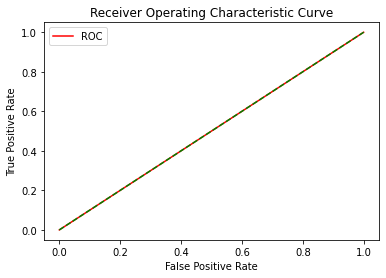

In [413]:
fper, tper, thresholds = roc_curve(testY, predictions)
plot_roc_curve(fper, tper)